# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

mkdir: cannot create directory ‘data’: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

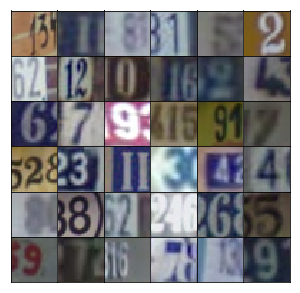

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [9]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x1 = tf.layers.dense(z, 4*4*512)
        
        x1 = tf.reshape(x1, (-1, 4, 4, 512))
        x1 = tf.layers.batch_normalization(x1, training=training)
        x1 = tf.maximum(alpha * x1, x1)
        
        x2 = tf.layers.conv2d_transpose(x1, 256, 5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=training)
        x2 = tf.maximum(alpha * x2, x2)
        
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(x3, training=training)
        x3 = tf.maximum(alpha * x3, x3)
        
        # Output layer, 32x32x3
        logits = tf.layers.conv2d_transpose(x3, output_dim, 5, strides=2, padding='same')
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've build before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [10]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x1 = tf.layers.conv2d(x, 64, 5, strides=2, padding='same')
        x1 = tf.maximum(alpha * x1, x1)
        
        x2 = tf.layers.conv2d(x1, 128, 5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=True)
        x2 = tf.maximum(alpha * x2, x2)
        
        x3 = tf.layers.conv2d(x2, 256, 5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(x3, training=True)
        x3 = tf.maximum(alpha * x3, x3)
        
        flat = tf.reshape(x3, (-1, 4*4*256))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [11]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [12]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [13]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=0.2)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [14]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an errror without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [15]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very senstive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [16]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 1.5527... Generator Loss: 0.4874
Epoch 1/25... Discriminator Loss: 0.3683... Generator Loss: 2.1370
Epoch 1/25... Discriminator Loss: 0.1816... Generator Loss: 2.1835
Epoch 1/25... Discriminator Loss: 0.1407... Generator Loss: 2.5771
Epoch 1/25... Discriminator Loss: 0.1792... Generator Loss: 2.6952
Epoch 1/25... Discriminator Loss: 0.1265... Generator Loss: 2.5592
Epoch 1/25... Discriminator Loss: 0.1394... Generator Loss: 2.8763
Epoch 1/25... Discriminator Loss: 0.1506... Generator Loss: 3.0498
Epoch 1/25... Discriminator Loss: 0.1146... Generator Loss: 3.4006
Epoch 1/25... Discriminator Loss: 0.1987... Generator Loss: 2.8534


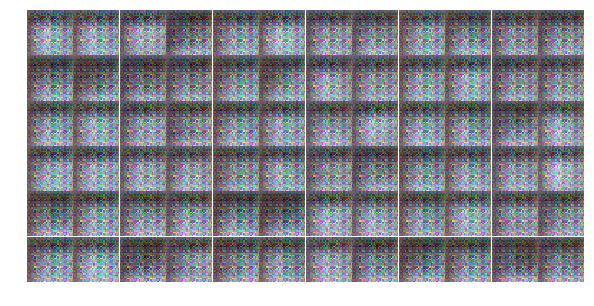

Epoch 1/25... Discriminator Loss: 0.1543... Generator Loss: 2.9442
Epoch 1/25... Discriminator Loss: 1.3554... Generator Loss: 1.5592
Epoch 1/25... Discriminator Loss: 0.5415... Generator Loss: 1.9757
Epoch 1/25... Discriminator Loss: 0.5772... Generator Loss: 2.1131
Epoch 1/25... Discriminator Loss: 0.6603... Generator Loss: 1.0942
Epoch 1/25... Discriminator Loss: 0.4026... Generator Loss: 2.1625
Epoch 1/25... Discriminator Loss: 0.3505... Generator Loss: 2.0082
Epoch 1/25... Discriminator Loss: 0.3806... Generator Loss: 2.7711
Epoch 1/25... Discriminator Loss: 1.1294... Generator Loss: 3.3632
Epoch 1/25... Discriminator Loss: 0.1940... Generator Loss: 3.4002


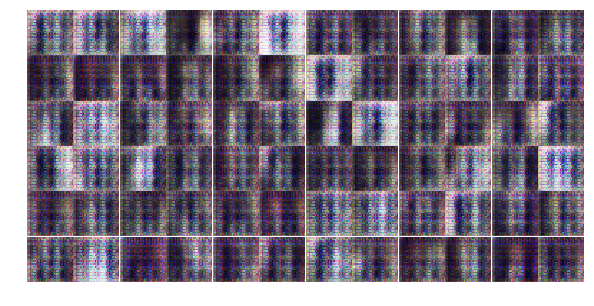

Epoch 1/25... Discriminator Loss: 1.1889... Generator Loss: 0.4783
Epoch 1/25... Discriminator Loss: 0.6746... Generator Loss: 2.6834
Epoch 1/25... Discriminator Loss: 0.7779... Generator Loss: 1.0874
Epoch 1/25... Discriminator Loss: 0.3222... Generator Loss: 3.1440
Epoch 1/25... Discriminator Loss: 0.3856... Generator Loss: 1.7254
Epoch 1/25... Discriminator Loss: 1.6225... Generator Loss: 2.9609
Epoch 1/25... Discriminator Loss: 1.9923... Generator Loss: 0.2877
Epoch 1/25... Discriminator Loss: 1.1832... Generator Loss: 1.1386
Epoch 1/25... Discriminator Loss: 0.8130... Generator Loss: 1.3494
Epoch 1/25... Discriminator Loss: 0.3938... Generator Loss: 2.3610


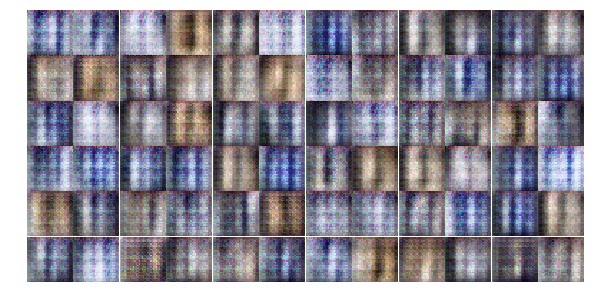

Epoch 1/25... Discriminator Loss: 0.9237... Generator Loss: 0.8094
Epoch 1/25... Discriminator Loss: 0.5502... Generator Loss: 2.4824
Epoch 1/25... Discriminator Loss: 0.8512... Generator Loss: 1.8885
Epoch 1/25... Discriminator Loss: 0.6721... Generator Loss: 1.4725
Epoch 1/25... Discriminator Loss: 1.4471... Generator Loss: 0.8153
Epoch 1/25... Discriminator Loss: 0.5241... Generator Loss: 1.6560
Epoch 1/25... Discriminator Loss: 0.4384... Generator Loss: 3.4894
Epoch 1/25... Discriminator Loss: 0.2187... Generator Loss: 2.5040
Epoch 1/25... Discriminator Loss: 0.2837... Generator Loss: 2.5777
Epoch 1/25... Discriminator Loss: 0.4766... Generator Loss: 1.9041


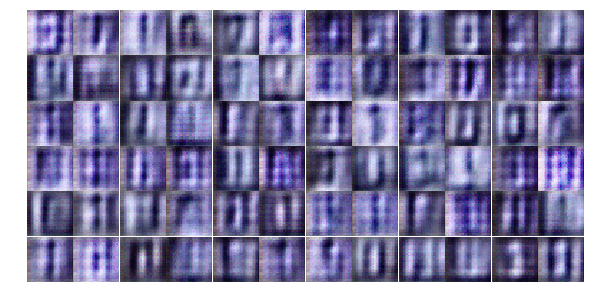

Epoch 1/25... Discriminator Loss: 0.5540... Generator Loss: 1.8448
Epoch 1/25... Discriminator Loss: 0.8337... Generator Loss: 1.2777
Epoch 1/25... Discriminator Loss: 0.4746... Generator Loss: 1.5956
Epoch 1/25... Discriminator Loss: 0.6012... Generator Loss: 1.3596
Epoch 1/25... Discriminator Loss: 0.2750... Generator Loss: 2.4571
Epoch 1/25... Discriminator Loss: 1.4600... Generator Loss: 0.6397
Epoch 1/25... Discriminator Loss: 2.0478... Generator Loss: 2.9500
Epoch 1/25... Discriminator Loss: 0.5695... Generator Loss: 1.7361
Epoch 1/25... Discriminator Loss: 0.7454... Generator Loss: 1.3019
Epoch 1/25... Discriminator Loss: 0.7252... Generator Loss: 1.4147


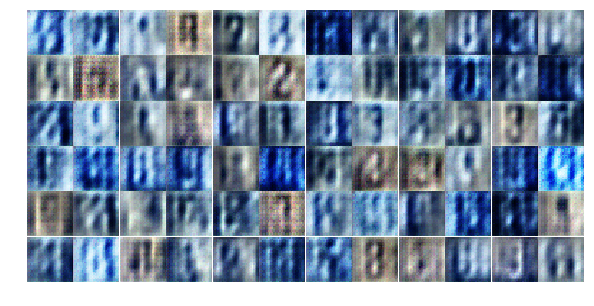

Epoch 1/25... Discriminator Loss: 0.5375... Generator Loss: 1.2420
Epoch 1/25... Discriminator Loss: 0.7671... Generator Loss: 1.2302
Epoch 1/25... Discriminator Loss: 1.0699... Generator Loss: 1.8669
Epoch 1/25... Discriminator Loss: 1.1035... Generator Loss: 0.7017
Epoch 1/25... Discriminator Loss: 0.7803... Generator Loss: 0.9776
Epoch 1/25... Discriminator Loss: 0.5307... Generator Loss: 1.4539
Epoch 1/25... Discriminator Loss: 0.7641... Generator Loss: 1.3213
Epoch 2/25... Discriminator Loss: 0.8135... Generator Loss: 1.3154
Epoch 2/25... Discriminator Loss: 0.7592... Generator Loss: 2.3819
Epoch 2/25... Discriminator Loss: 1.2333... Generator Loss: 0.6840


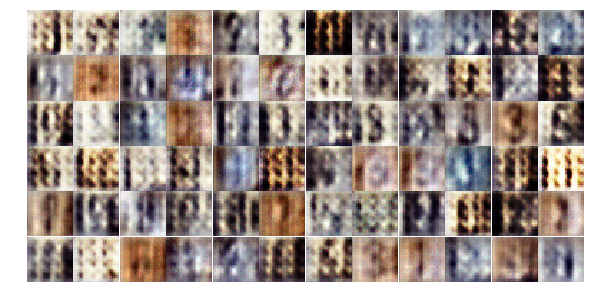

Epoch 2/25... Discriminator Loss: 1.1054... Generator Loss: 1.6504
Epoch 2/25... Discriminator Loss: 0.9006... Generator Loss: 1.5670
Epoch 2/25... Discriminator Loss: 1.0737... Generator Loss: 2.4883
Epoch 2/25... Discriminator Loss: 0.7702... Generator Loss: 1.4373
Epoch 2/25... Discriminator Loss: 1.0026... Generator Loss: 0.9020
Epoch 2/25... Discriminator Loss: 0.7549... Generator Loss: 1.2674
Epoch 2/25... Discriminator Loss: 1.2532... Generator Loss: 0.8343
Epoch 2/25... Discriminator Loss: 1.2423... Generator Loss: 0.7481
Epoch 2/25... Discriminator Loss: 0.7018... Generator Loss: 1.3471
Epoch 2/25... Discriminator Loss: 0.6515... Generator Loss: 1.3903


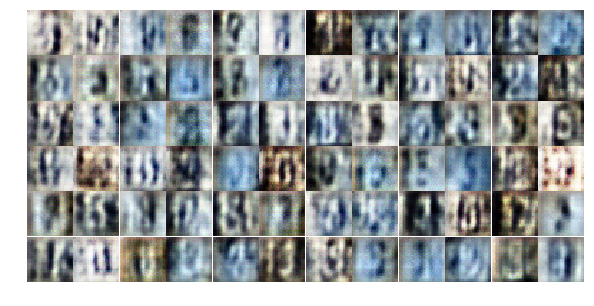

Epoch 2/25... Discriminator Loss: 1.3717... Generator Loss: 0.7565
Epoch 2/25... Discriminator Loss: 1.1740... Generator Loss: 0.7978
Epoch 2/25... Discriminator Loss: 0.8797... Generator Loss: 2.1796
Epoch 2/25... Discriminator Loss: 0.7292... Generator Loss: 1.1604
Epoch 2/25... Discriminator Loss: 0.6597... Generator Loss: 1.4784
Epoch 2/25... Discriminator Loss: 1.1987... Generator Loss: 1.1388
Epoch 2/25... Discriminator Loss: 0.9975... Generator Loss: 1.0384
Epoch 2/25... Discriminator Loss: 1.2254... Generator Loss: 0.6854
Epoch 2/25... Discriminator Loss: 1.0358... Generator Loss: 1.1883
Epoch 2/25... Discriminator Loss: 1.1067... Generator Loss: 0.7846


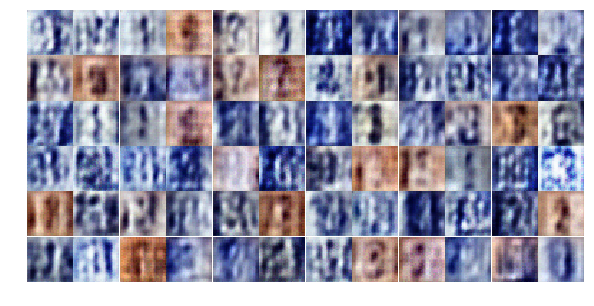

Epoch 2/25... Discriminator Loss: 1.1404... Generator Loss: 1.3044
Epoch 2/25... Discriminator Loss: 1.1014... Generator Loss: 1.3013
Epoch 2/25... Discriminator Loss: 0.8229... Generator Loss: 1.3037
Epoch 2/25... Discriminator Loss: 0.8070... Generator Loss: 1.2088
Epoch 2/25... Discriminator Loss: 1.0376... Generator Loss: 0.9455
Epoch 2/25... Discriminator Loss: 0.8311... Generator Loss: 1.0532
Epoch 2/25... Discriminator Loss: 1.2543... Generator Loss: 0.7533
Epoch 2/25... Discriminator Loss: 1.3827... Generator Loss: 0.6134
Epoch 2/25... Discriminator Loss: 1.5135... Generator Loss: 0.5498
Epoch 2/25... Discriminator Loss: 0.8253... Generator Loss: 1.3173


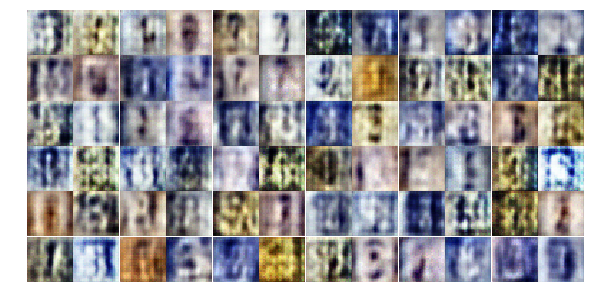

Epoch 2/25... Discriminator Loss: 1.6305... Generator Loss: 1.0682
Epoch 2/25... Discriminator Loss: 1.4237... Generator Loss: 0.8314
Epoch 2/25... Discriminator Loss: 1.4229... Generator Loss: 0.6001
Epoch 2/25... Discriminator Loss: 1.2749... Generator Loss: 0.8098
Epoch 2/25... Discriminator Loss: 1.2052... Generator Loss: 0.8332
Epoch 2/25... Discriminator Loss: 1.3915... Generator Loss: 0.6756
Epoch 2/25... Discriminator Loss: 1.1390... Generator Loss: 1.0198
Epoch 2/25... Discriminator Loss: 1.5389... Generator Loss: 0.9454
Epoch 2/25... Discriminator Loss: 0.9351... Generator Loss: 1.0082
Epoch 2/25... Discriminator Loss: 1.2705... Generator Loss: 0.8826


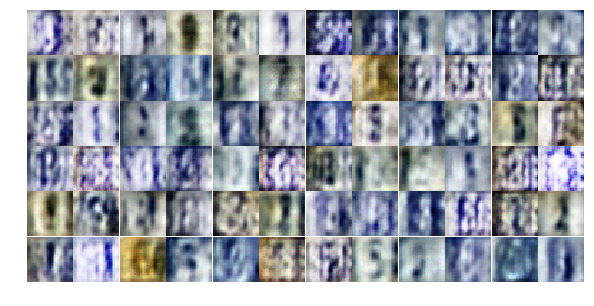

Epoch 2/25... Discriminator Loss: 0.9968... Generator Loss: 1.1389
Epoch 2/25... Discriminator Loss: 1.1605... Generator Loss: 0.9851
Epoch 2/25... Discriminator Loss: 0.8790... Generator Loss: 0.9509
Epoch 2/25... Discriminator Loss: 1.2421... Generator Loss: 0.8946
Epoch 2/25... Discriminator Loss: 1.0244... Generator Loss: 0.9364
Epoch 2/25... Discriminator Loss: 1.2082... Generator Loss: 0.8299
Epoch 2/25... Discriminator Loss: 1.0611... Generator Loss: 1.1311
Epoch 2/25... Discriminator Loss: 1.1270... Generator Loss: 1.1854
Epoch 2/25... Discriminator Loss: 0.8302... Generator Loss: 1.3951
Epoch 2/25... Discriminator Loss: 1.0141... Generator Loss: 1.0517


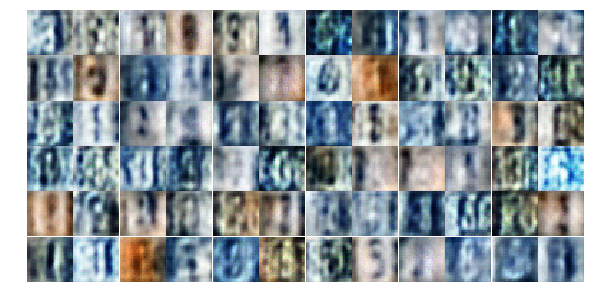

Epoch 2/25... Discriminator Loss: 1.1127... Generator Loss: 1.1045
Epoch 2/25... Discriminator Loss: 1.0867... Generator Loss: 1.1831
Epoch 2/25... Discriminator Loss: 1.2412... Generator Loss: 0.5684
Epoch 2/25... Discriminator Loss: 0.9888... Generator Loss: 0.9301
Epoch 3/25... Discriminator Loss: 0.9699... Generator Loss: 1.9028
Epoch 3/25... Discriminator Loss: 0.7893... Generator Loss: 1.0927
Epoch 3/25... Discriminator Loss: 1.0309... Generator Loss: 0.8960
Epoch 3/25... Discriminator Loss: 1.0875... Generator Loss: 0.9233
Epoch 3/25... Discriminator Loss: 1.0960... Generator Loss: 0.8157
Epoch 3/25... Discriminator Loss: 0.8643... Generator Loss: 1.0038


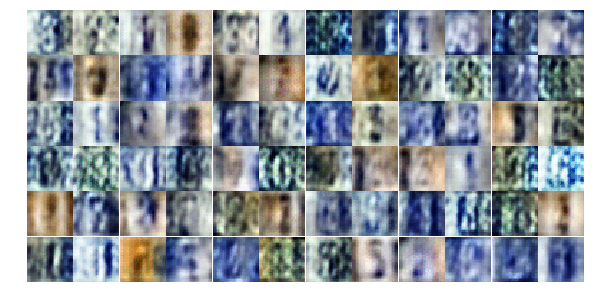

Epoch 3/25... Discriminator Loss: 0.8244... Generator Loss: 1.0149
Epoch 3/25... Discriminator Loss: 0.9257... Generator Loss: 1.0017
Epoch 3/25... Discriminator Loss: 0.9375... Generator Loss: 0.7905
Epoch 3/25... Discriminator Loss: 0.8244... Generator Loss: 1.3045
Epoch 3/25... Discriminator Loss: 0.6243... Generator Loss: 1.3127
Epoch 3/25... Discriminator Loss: 0.8291... Generator Loss: 0.8627
Epoch 3/25... Discriminator Loss: 0.9726... Generator Loss: 0.7966
Epoch 3/25... Discriminator Loss: 1.0522... Generator Loss: 1.4288
Epoch 3/25... Discriminator Loss: 1.2238... Generator Loss: 0.5871
Epoch 3/25... Discriminator Loss: 1.1993... Generator Loss: 0.5937


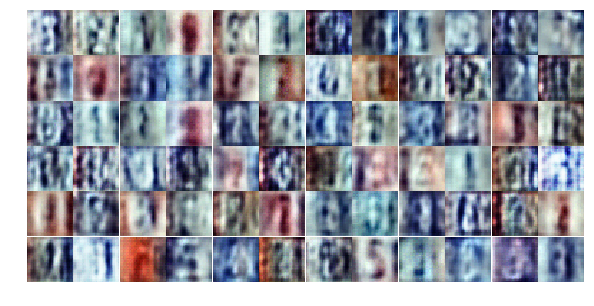

Epoch 3/25... Discriminator Loss: 1.1328... Generator Loss: 1.8252
Epoch 3/25... Discriminator Loss: 0.6610... Generator Loss: 1.4703
Epoch 3/25... Discriminator Loss: 0.8369... Generator Loss: 0.9376
Epoch 3/25... Discriminator Loss: 1.1090... Generator Loss: 2.1772
Epoch 3/25... Discriminator Loss: 0.3942... Generator Loss: 2.0067
Epoch 3/25... Discriminator Loss: 0.6967... Generator Loss: 2.2431
Epoch 3/25... Discriminator Loss: 1.0692... Generator Loss: 0.6171
Epoch 3/25... Discriminator Loss: 1.1808... Generator Loss: 1.4646
Epoch 3/25... Discriminator Loss: 0.7312... Generator Loss: 1.7247
Epoch 3/25... Discriminator Loss: 0.3436... Generator Loss: 2.5894


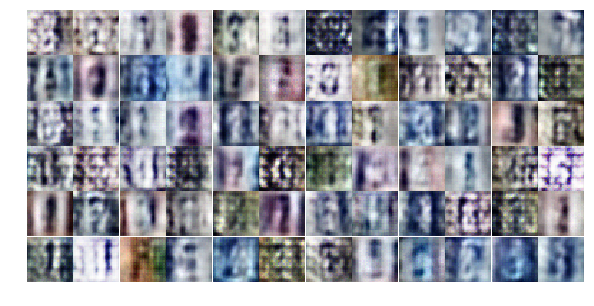

Epoch 3/25... Discriminator Loss: 0.6500... Generator Loss: 1.5943
Epoch 3/25... Discriminator Loss: 0.4264... Generator Loss: 1.7445
Epoch 3/25... Discriminator Loss: 0.7366... Generator Loss: 1.1085
Epoch 3/25... Discriminator Loss: 0.6739... Generator Loss: 2.1704
Epoch 3/25... Discriminator Loss: 0.7312... Generator Loss: 1.0357
Epoch 3/25... Discriminator Loss: 0.7508... Generator Loss: 0.9949
Epoch 3/25... Discriminator Loss: 0.4302... Generator Loss: 1.6885
Epoch 3/25... Discriminator Loss: 1.0509... Generator Loss: 0.7042
Epoch 3/25... Discriminator Loss: 0.7314... Generator Loss: 0.9805
Epoch 3/25... Discriminator Loss: 0.5496... Generator Loss: 1.3540


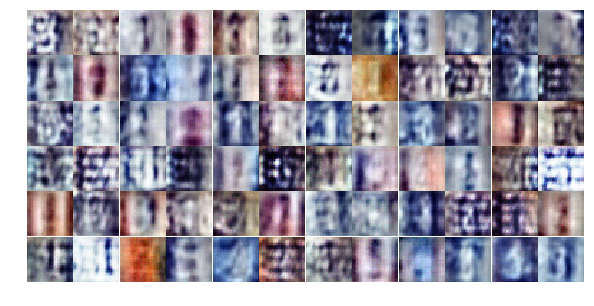

Epoch 3/25... Discriminator Loss: 0.7305... Generator Loss: 2.2368
Epoch 3/25... Discriminator Loss: 0.7565... Generator Loss: 0.9145
Epoch 3/25... Discriminator Loss: 0.7121... Generator Loss: 1.0084
Epoch 3/25... Discriminator Loss: 0.5630... Generator Loss: 2.5991
Epoch 3/25... Discriminator Loss: 0.9965... Generator Loss: 0.6449
Epoch 3/25... Discriminator Loss: 1.0985... Generator Loss: 2.7245
Epoch 3/25... Discriminator Loss: 0.6918... Generator Loss: 1.4723
Epoch 3/25... Discriminator Loss: 0.7015... Generator Loss: 1.1424
Epoch 3/25... Discriminator Loss: 0.7180... Generator Loss: 3.1842
Epoch 3/25... Discriminator Loss: 0.8763... Generator Loss: 1.1120


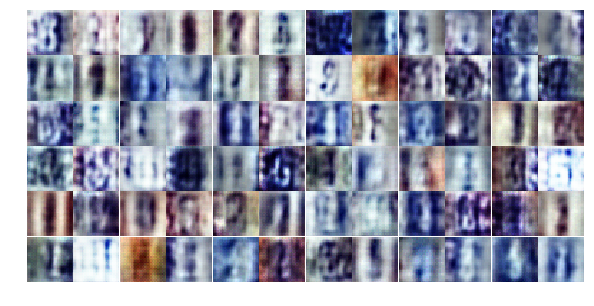

Epoch 3/25... Discriminator Loss: 1.1154... Generator Loss: 0.8644
Epoch 3/25... Discriminator Loss: 1.0139... Generator Loss: 0.7259
Epoch 3/25... Discriminator Loss: 0.9447... Generator Loss: 0.7923
Epoch 3/25... Discriminator Loss: 0.4712... Generator Loss: 1.6454
Epoch 3/25... Discriminator Loss: 1.1136... Generator Loss: 1.2721
Epoch 3/25... Discriminator Loss: 0.4722... Generator Loss: 2.0366
Epoch 3/25... Discriminator Loss: 0.6183... Generator Loss: 1.5109
Epoch 3/25... Discriminator Loss: 0.8182... Generator Loss: 0.9826
Epoch 3/25... Discriminator Loss: 0.5722... Generator Loss: 1.3104
Epoch 3/25... Discriminator Loss: 0.5965... Generator Loss: 1.4059


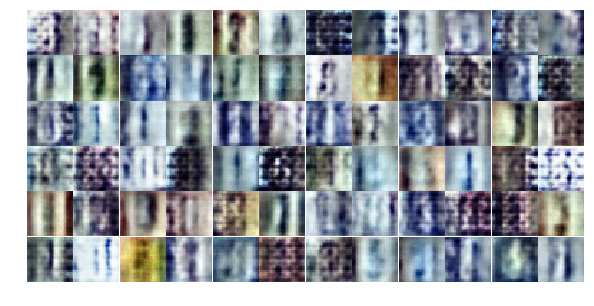

Epoch 3/25... Discriminator Loss: 0.9793... Generator Loss: 0.7066
Epoch 4/25... Discriminator Loss: 0.7189... Generator Loss: 2.1969
Epoch 4/25... Discriminator Loss: 1.0428... Generator Loss: 1.3430
Epoch 4/25... Discriminator Loss: 1.2096... Generator Loss: 0.6539
Epoch 4/25... Discriminator Loss: 0.7002... Generator Loss: 1.6177
Epoch 4/25... Discriminator Loss: 0.7533... Generator Loss: 1.1810
Epoch 4/25... Discriminator Loss: 0.3547... Generator Loss: 1.9872
Epoch 4/25... Discriminator Loss: 0.4974... Generator Loss: 1.8530
Epoch 4/25... Discriminator Loss: 0.3773... Generator Loss: 2.3242
Epoch 4/25... Discriminator Loss: 0.7179... Generator Loss: 0.9322


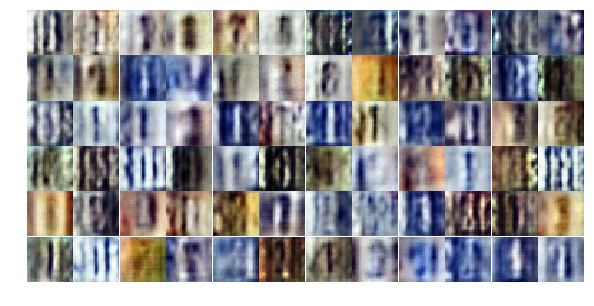

Epoch 4/25... Discriminator Loss: 0.6084... Generator Loss: 1.5065
Epoch 4/25... Discriminator Loss: 0.6572... Generator Loss: 1.3194
Epoch 4/25... Discriminator Loss: 0.8330... Generator Loss: 1.5707
Epoch 4/25... Discriminator Loss: 1.1314... Generator Loss: 3.2852
Epoch 4/25... Discriminator Loss: 2.0111... Generator Loss: 2.9972
Epoch 4/25... Discriminator Loss: 1.1017... Generator Loss: 0.8688
Epoch 4/25... Discriminator Loss: 0.5441... Generator Loss: 1.7699
Epoch 4/25... Discriminator Loss: 0.5542... Generator Loss: 1.2770
Epoch 4/25... Discriminator Loss: 0.7227... Generator Loss: 1.1943
Epoch 4/25... Discriminator Loss: 0.9886... Generator Loss: 3.0475


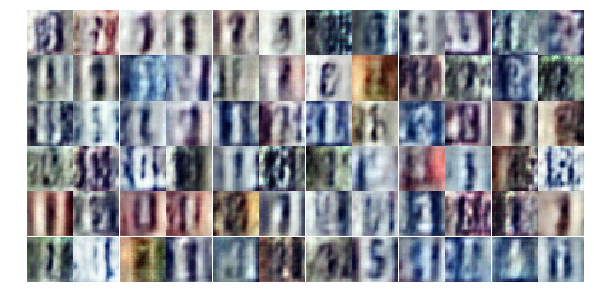

Epoch 4/25... Discriminator Loss: 0.7485... Generator Loss: 1.2152
Epoch 4/25... Discriminator Loss: 0.5235... Generator Loss: 2.0879
Epoch 4/25... Discriminator Loss: 0.8702... Generator Loss: 0.8600
Epoch 4/25... Discriminator Loss: 0.5167... Generator Loss: 1.4520
Epoch 4/25... Discriminator Loss: 0.2876... Generator Loss: 2.6985
Epoch 4/25... Discriminator Loss: 0.3288... Generator Loss: 2.1237
Epoch 4/25... Discriminator Loss: 0.6398... Generator Loss: 1.0368
Epoch 4/25... Discriminator Loss: 0.5630... Generator Loss: 1.2599
Epoch 4/25... Discriminator Loss: 0.8507... Generator Loss: 1.0226
Epoch 4/25... Discriminator Loss: 0.5549... Generator Loss: 1.3049


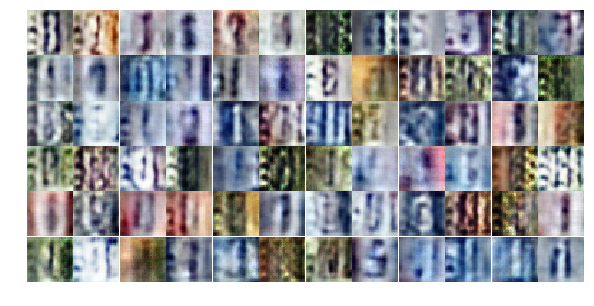

Epoch 4/25... Discriminator Loss: 0.4147... Generator Loss: 2.2893
Epoch 4/25... Discriminator Loss: 0.6788... Generator Loss: 1.0936
Epoch 4/25... Discriminator Loss: 0.5348... Generator Loss: 1.3648
Epoch 4/25... Discriminator Loss: 0.3763... Generator Loss: 1.9691
Epoch 4/25... Discriminator Loss: 0.4149... Generator Loss: 2.6919
Epoch 4/25... Discriminator Loss: 0.8602... Generator Loss: 0.9423
Epoch 4/25... Discriminator Loss: 0.6109... Generator Loss: 2.1202
Epoch 4/25... Discriminator Loss: 0.6829... Generator Loss: 1.1854
Epoch 4/25... Discriminator Loss: 0.7266... Generator Loss: 1.2589
Epoch 4/25... Discriminator Loss: 0.5568... Generator Loss: 1.3277


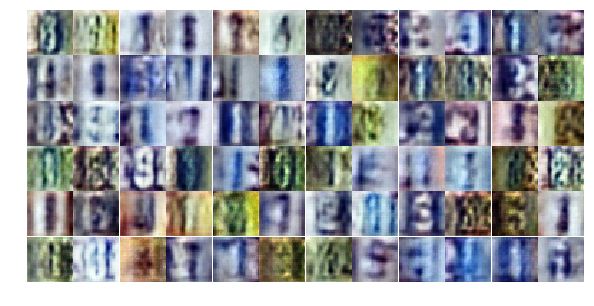

Epoch 4/25... Discriminator Loss: 0.8108... Generator Loss: 1.0046
Epoch 4/25... Discriminator Loss: 0.5501... Generator Loss: 1.4587
Epoch 4/25... Discriminator Loss: 0.8696... Generator Loss: 1.8918
Epoch 4/25... Discriminator Loss: 0.5701... Generator Loss: 2.0761
Epoch 4/25... Discriminator Loss: 0.6260... Generator Loss: 1.3063
Epoch 4/25... Discriminator Loss: 0.8127... Generator Loss: 1.4908
Epoch 4/25... Discriminator Loss: 1.9107... Generator Loss: 0.2351
Epoch 4/25... Discriminator Loss: 0.7705... Generator Loss: 1.2336
Epoch 4/25... Discriminator Loss: 0.5875... Generator Loss: 1.4322
Epoch 4/25... Discriminator Loss: 0.5953... Generator Loss: 1.4986


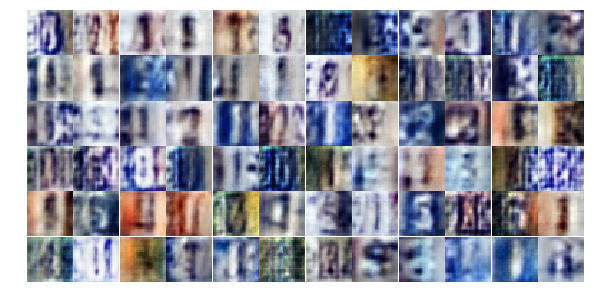

Epoch 4/25... Discriminator Loss: 0.5614... Generator Loss: 1.5082
Epoch 4/25... Discriminator Loss: 0.7774... Generator Loss: 2.4041
Epoch 4/25... Discriminator Loss: 0.4755... Generator Loss: 2.4530
Epoch 4/25... Discriminator Loss: 0.4811... Generator Loss: 1.8796
Epoch 4/25... Discriminator Loss: 0.5041... Generator Loss: 1.4988
Epoch 4/25... Discriminator Loss: 0.6395... Generator Loss: 1.3716
Epoch 4/25... Discriminator Loss: 0.4983... Generator Loss: 1.4909
Epoch 4/25... Discriminator Loss: 0.8629... Generator Loss: 0.8758
Epoch 4/25... Discriminator Loss: 0.8098... Generator Loss: 2.4045
Epoch 5/25... Discriminator Loss: 0.6487... Generator Loss: 2.0201


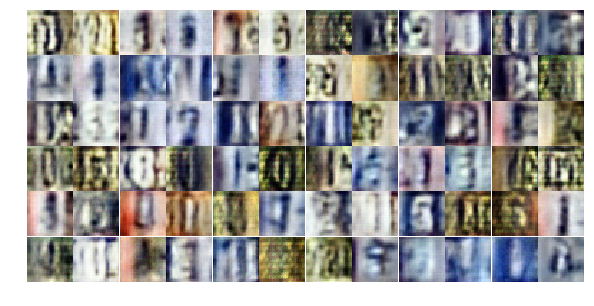

Epoch 5/25... Discriminator Loss: 0.4475... Generator Loss: 1.5693
Epoch 5/25... Discriminator Loss: 0.4460... Generator Loss: 1.5188
Epoch 5/25... Discriminator Loss: 0.6093... Generator Loss: 1.9047
Epoch 5/25... Discriminator Loss: 0.3717... Generator Loss: 2.0105
Epoch 5/25... Discriminator Loss: 0.4542... Generator Loss: 2.5399
Epoch 5/25... Discriminator Loss: 1.4052... Generator Loss: 0.3989
Epoch 5/25... Discriminator Loss: 0.5389... Generator Loss: 1.3868
Epoch 5/25... Discriminator Loss: 0.4917... Generator Loss: 1.7230
Epoch 5/25... Discriminator Loss: 0.4360... Generator Loss: 1.9231
Epoch 5/25... Discriminator Loss: 0.5851... Generator Loss: 1.2781


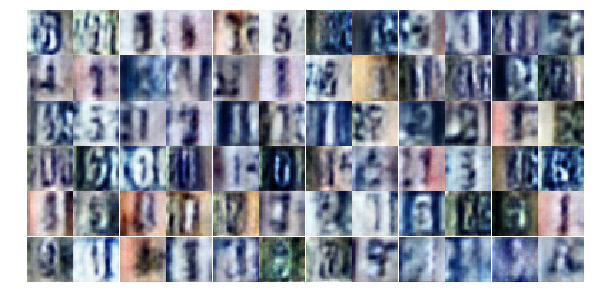

Epoch 5/25... Discriminator Loss: 0.9322... Generator Loss: 0.6748
Epoch 5/25... Discriminator Loss: 0.7800... Generator Loss: 1.2685
Epoch 5/25... Discriminator Loss: 0.4055... Generator Loss: 1.4759
Epoch 5/25... Discriminator Loss: 0.6274... Generator Loss: 1.1664
Epoch 5/25... Discriminator Loss: 0.8712... Generator Loss: 0.9283
Epoch 5/25... Discriminator Loss: 1.1492... Generator Loss: 0.6371
Epoch 5/25... Discriminator Loss: 0.9866... Generator Loss: 0.7751
Epoch 5/25... Discriminator Loss: 0.5362... Generator Loss: 1.9584
Epoch 5/25... Discriminator Loss: 0.7789... Generator Loss: 0.9475
Epoch 5/25... Discriminator Loss: 0.4415... Generator Loss: 1.8840


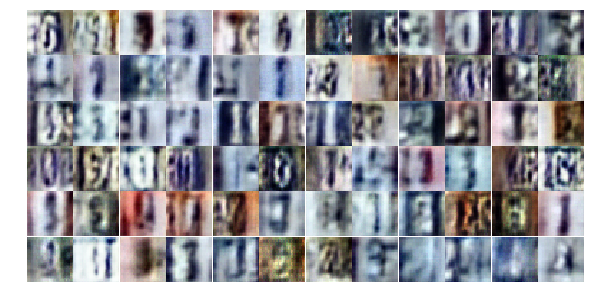

Epoch 5/25... Discriminator Loss: 0.5363... Generator Loss: 1.4814
Epoch 5/25... Discriminator Loss: 0.5961... Generator Loss: 1.5127
Epoch 5/25... Discriminator Loss: 0.6120... Generator Loss: 1.2256
Epoch 5/25... Discriminator Loss: 0.5693... Generator Loss: 1.2374
Epoch 5/25... Discriminator Loss: 0.9007... Generator Loss: 0.7192
Epoch 5/25... Discriminator Loss: 0.6594... Generator Loss: 1.0211
Epoch 5/25... Discriminator Loss: 0.8140... Generator Loss: 0.9046
Epoch 5/25... Discriminator Loss: 0.6401... Generator Loss: 1.4808
Epoch 5/25... Discriminator Loss: 0.7295... Generator Loss: 0.9026
Epoch 5/25... Discriminator Loss: 0.3628... Generator Loss: 1.8322


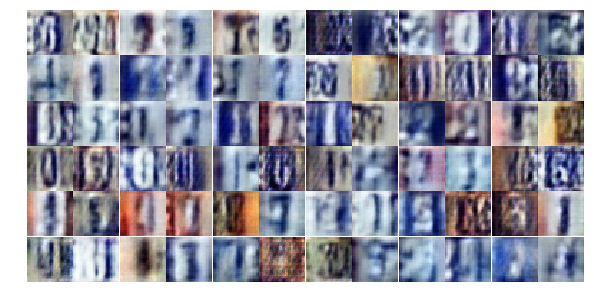

Epoch 5/25... Discriminator Loss: 0.5993... Generator Loss: 1.3458
Epoch 5/25... Discriminator Loss: 0.4497... Generator Loss: 1.6484
Epoch 5/25... Discriminator Loss: 0.6705... Generator Loss: 1.0821
Epoch 5/25... Discriminator Loss: 0.5346... Generator Loss: 1.2962
Epoch 5/25... Discriminator Loss: 0.7433... Generator Loss: 1.1218
Epoch 5/25... Discriminator Loss: 0.6010... Generator Loss: 2.3436
Epoch 5/25... Discriminator Loss: 0.6893... Generator Loss: 0.9830
Epoch 5/25... Discriminator Loss: 0.7593... Generator Loss: 0.9118
Epoch 5/25... Discriminator Loss: 0.6981... Generator Loss: 1.0341
Epoch 5/25... Discriminator Loss: 0.8197... Generator Loss: 0.8433


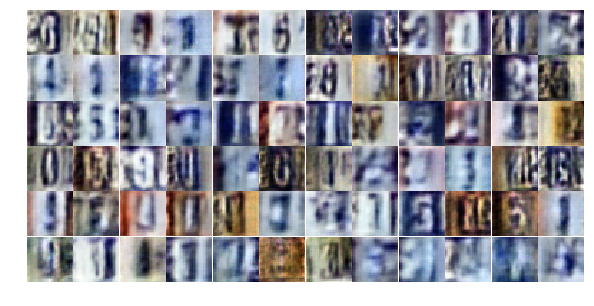

Epoch 5/25... Discriminator Loss: 0.4661... Generator Loss: 1.5061
Epoch 5/25... Discriminator Loss: 0.7511... Generator Loss: 0.8381
Epoch 5/25... Discriminator Loss: 0.7747... Generator Loss: 0.7991
Epoch 5/25... Discriminator Loss: 0.5544... Generator Loss: 1.2281
Epoch 5/25... Discriminator Loss: 0.6389... Generator Loss: 1.5836
Epoch 5/25... Discriminator Loss: 1.0668... Generator Loss: 0.6507
Epoch 5/25... Discriminator Loss: 0.4737... Generator Loss: 1.6715
Epoch 5/25... Discriminator Loss: 0.4610... Generator Loss: 1.6951
Epoch 5/25... Discriminator Loss: 0.6835... Generator Loss: 0.9987
Epoch 5/25... Discriminator Loss: 0.5512... Generator Loss: 2.7671


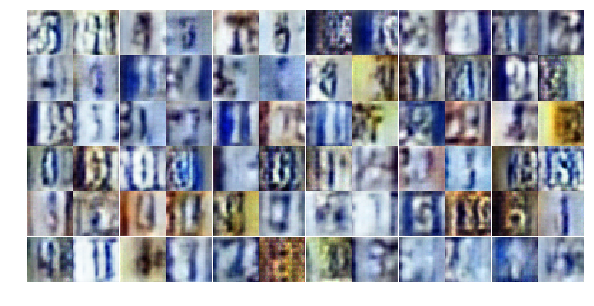

Epoch 5/25... Discriminator Loss: 0.7727... Generator Loss: 0.9430
Epoch 5/25... Discriminator Loss: 0.5486... Generator Loss: 1.4243
Epoch 5/25... Discriminator Loss: 0.9762... Generator Loss: 0.6609
Epoch 5/25... Discriminator Loss: 0.8113... Generator Loss: 0.8120
Epoch 5/25... Discriminator Loss: 0.5146... Generator Loss: 1.4458
Epoch 5/25... Discriminator Loss: 1.0020... Generator Loss: 2.0796
Epoch 6/25... Discriminator Loss: 0.5554... Generator Loss: 1.3224
Epoch 6/25... Discriminator Loss: 0.4334... Generator Loss: 1.6248
Epoch 6/25... Discriminator Loss: 1.2031... Generator Loss: 0.4748
Epoch 6/25... Discriminator Loss: 1.2753... Generator Loss: 0.4411


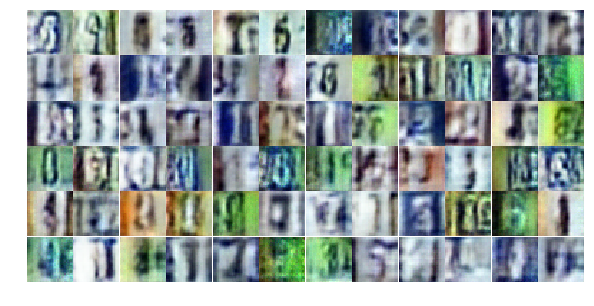

Epoch 6/25... Discriminator Loss: 0.5180... Generator Loss: 1.6331
Epoch 6/25... Discriminator Loss: 0.8136... Generator Loss: 1.8836
Epoch 6/25... Discriminator Loss: 0.9241... Generator Loss: 1.6723
Epoch 6/25... Discriminator Loss: 0.7594... Generator Loss: 1.8773
Epoch 6/25... Discriminator Loss: 0.7429... Generator Loss: 1.1217
Epoch 6/25... Discriminator Loss: 0.6715... Generator Loss: 0.9962
Epoch 6/25... Discriminator Loss: 0.5570... Generator Loss: 1.6246
Epoch 6/25... Discriminator Loss: 0.8235... Generator Loss: 0.8397
Epoch 6/25... Discriminator Loss: 1.3973... Generator Loss: 0.3925
Epoch 6/25... Discriminator Loss: 0.6960... Generator Loss: 1.1643


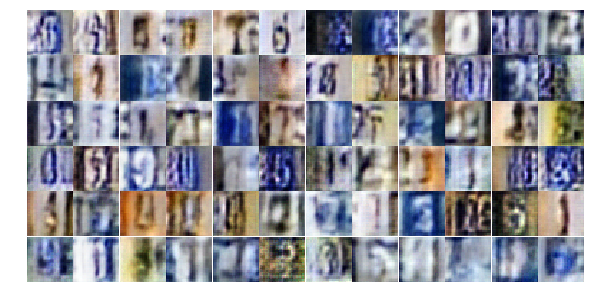

Epoch 6/25... Discriminator Loss: 0.5774... Generator Loss: 1.8331
Epoch 6/25... Discriminator Loss: 0.9728... Generator Loss: 0.7163
Epoch 6/25... Discriminator Loss: 0.5799... Generator Loss: 2.5118
Epoch 6/25... Discriminator Loss: 0.9181... Generator Loss: 0.7499
Epoch 6/25... Discriminator Loss: 0.5246... Generator Loss: 2.1164
Epoch 6/25... Discriminator Loss: 0.6149... Generator Loss: 1.5176
Epoch 6/25... Discriminator Loss: 0.6338... Generator Loss: 1.1270
Epoch 6/25... Discriminator Loss: 1.0530... Generator Loss: 0.5811
Epoch 6/25... Discriminator Loss: 0.5058... Generator Loss: 2.0058
Epoch 6/25... Discriminator Loss: 0.7427... Generator Loss: 1.0943


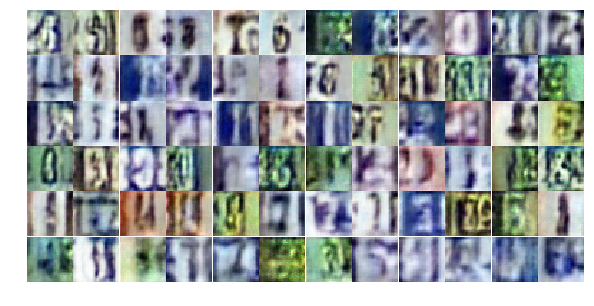

Epoch 6/25... Discriminator Loss: 1.2680... Generator Loss: 0.4578
Epoch 6/25... Discriminator Loss: 0.6370... Generator Loss: 1.3017
Epoch 6/25... Discriminator Loss: 0.6959... Generator Loss: 1.1234
Epoch 6/25... Discriminator Loss: 0.7306... Generator Loss: 0.9208
Epoch 6/25... Discriminator Loss: 0.4881... Generator Loss: 2.1342
Epoch 6/25... Discriminator Loss: 1.3351... Generator Loss: 0.4547
Epoch 6/25... Discriminator Loss: 0.6351... Generator Loss: 1.2613
Epoch 6/25... Discriminator Loss: 0.5841... Generator Loss: 1.1747
Epoch 6/25... Discriminator Loss: 0.5893... Generator Loss: 1.5020
Epoch 6/25... Discriminator Loss: 0.5996... Generator Loss: 1.2193


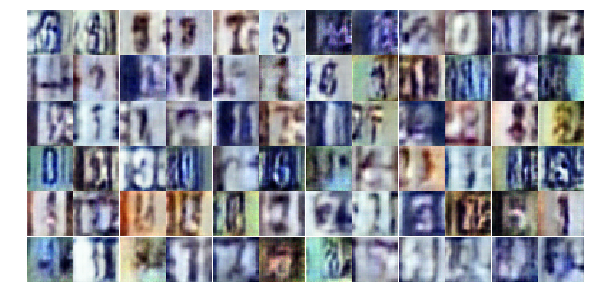

Epoch 6/25... Discriminator Loss: 0.8883... Generator Loss: 0.9291
Epoch 6/25... Discriminator Loss: 0.7986... Generator Loss: 0.8426
Epoch 6/25... Discriminator Loss: 0.8271... Generator Loss: 0.8247
Epoch 6/25... Discriminator Loss: 0.7733... Generator Loss: 0.9113
Epoch 6/25... Discriminator Loss: 0.6853... Generator Loss: 1.1620
Epoch 6/25... Discriminator Loss: 1.1040... Generator Loss: 0.5743
Epoch 6/25... Discriminator Loss: 0.4877... Generator Loss: 1.5230
Epoch 6/25... Discriminator Loss: 0.5050... Generator Loss: 2.0544
Epoch 6/25... Discriminator Loss: 1.1397... Generator Loss: 0.5433
Epoch 6/25... Discriminator Loss: 0.5766... Generator Loss: 1.1273


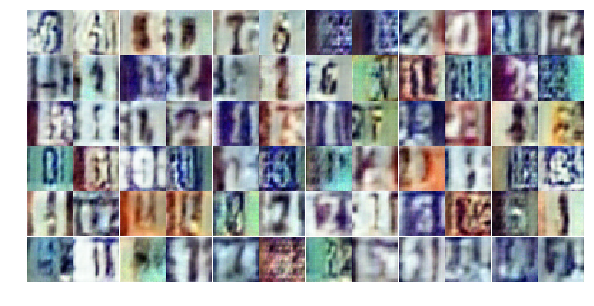

Epoch 6/25... Discriminator Loss: 0.7973... Generator Loss: 2.5405
Epoch 6/25... Discriminator Loss: 0.9740... Generator Loss: 0.6464
Epoch 6/25... Discriminator Loss: 1.1223... Generator Loss: 0.6527
Epoch 6/25... Discriminator Loss: 0.6345... Generator Loss: 1.6187
Epoch 6/25... Discriminator Loss: 0.5238... Generator Loss: 1.4754
Epoch 6/25... Discriminator Loss: 0.5804... Generator Loss: 1.1916
Epoch 6/25... Discriminator Loss: 1.0245... Generator Loss: 0.7037
Epoch 6/25... Discriminator Loss: 0.7786... Generator Loss: 0.8712
Epoch 6/25... Discriminator Loss: 0.5808... Generator Loss: 1.1971
Epoch 6/25... Discriminator Loss: 1.4747... Generator Loss: 0.3435


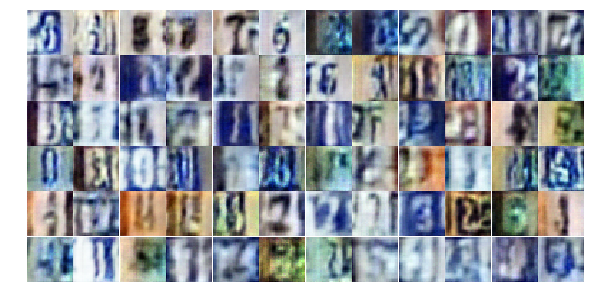

Epoch 6/25... Discriminator Loss: 0.5438... Generator Loss: 1.3062
Epoch 6/25... Discriminator Loss: 0.4987... Generator Loss: 1.4157
Epoch 6/25... Discriminator Loss: 0.5251... Generator Loss: 1.4966
Epoch 7/25... Discriminator Loss: 0.5094... Generator Loss: 1.3907
Epoch 7/25... Discriminator Loss: 0.8803... Generator Loss: 0.7931
Epoch 7/25... Discriminator Loss: 0.6069... Generator Loss: 1.4580
Epoch 7/25... Discriminator Loss: 0.6521... Generator Loss: 1.0395
Epoch 7/25... Discriminator Loss: 0.4787... Generator Loss: 1.5576
Epoch 7/25... Discriminator Loss: 0.5958... Generator Loss: 1.6094
Epoch 7/25... Discriminator Loss: 1.2335... Generator Loss: 0.4612


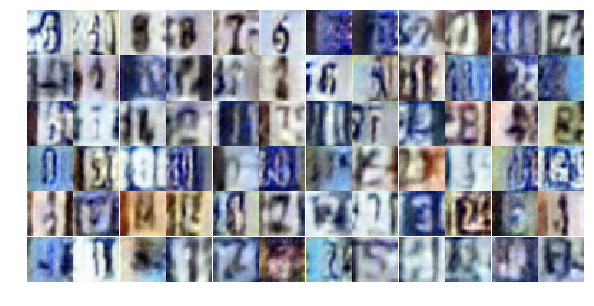

Epoch 7/25... Discriminator Loss: 0.5819... Generator Loss: 1.5652
Epoch 7/25... Discriminator Loss: 0.6923... Generator Loss: 1.0923
Epoch 7/25... Discriminator Loss: 1.1853... Generator Loss: 0.5167
Epoch 7/25... Discriminator Loss: 0.5074... Generator Loss: 1.9982
Epoch 7/25... Discriminator Loss: 0.6555... Generator Loss: 1.4271
Epoch 7/25... Discriminator Loss: 0.5895... Generator Loss: 1.1806
Epoch 7/25... Discriminator Loss: 1.0245... Generator Loss: 3.1617
Epoch 7/25... Discriminator Loss: 1.1212... Generator Loss: 2.8410
Epoch 7/25... Discriminator Loss: 0.5294... Generator Loss: 2.2276
Epoch 7/25... Discriminator Loss: 0.6284... Generator Loss: 1.2421


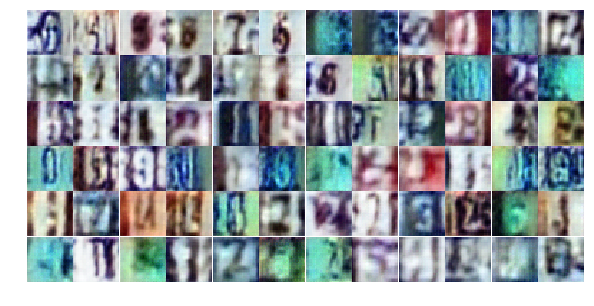

Epoch 7/25... Discriminator Loss: 0.6181... Generator Loss: 1.3271
Epoch 7/25... Discriminator Loss: 0.5843... Generator Loss: 1.2949
Epoch 7/25... Discriminator Loss: 1.0681... Generator Loss: 0.6145
Epoch 7/25... Discriminator Loss: 0.6636... Generator Loss: 1.2267
Epoch 7/25... Discriminator Loss: 0.4343... Generator Loss: 1.6984
Epoch 7/25... Discriminator Loss: 0.5402... Generator Loss: 1.2852
Epoch 7/25... Discriminator Loss: 0.6033... Generator Loss: 1.1047
Epoch 7/25... Discriminator Loss: 0.7477... Generator Loss: 0.9767
Epoch 7/25... Discriminator Loss: 0.4584... Generator Loss: 1.5252
Epoch 7/25... Discriminator Loss: 0.5206... Generator Loss: 1.8401


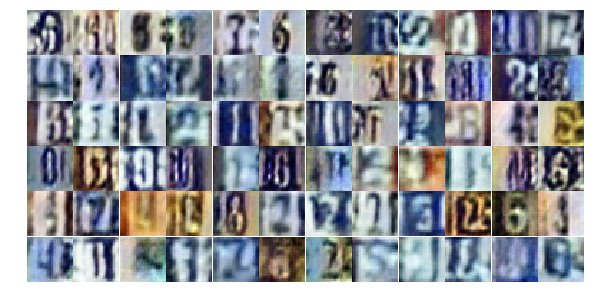

Epoch 7/25... Discriminator Loss: 1.5734... Generator Loss: 0.3468
Epoch 7/25... Discriminator Loss: 0.7746... Generator Loss: 0.9227
Epoch 7/25... Discriminator Loss: 0.6273... Generator Loss: 1.1047
Epoch 7/25... Discriminator Loss: 0.6422... Generator Loss: 1.0593
Epoch 7/25... Discriminator Loss: 0.6385... Generator Loss: 1.3148
Epoch 7/25... Discriminator Loss: 0.8830... Generator Loss: 0.7245
Epoch 7/25... Discriminator Loss: 0.7937... Generator Loss: 0.8481
Epoch 7/25... Discriminator Loss: 0.7803... Generator Loss: 0.8492
Epoch 7/25... Discriminator Loss: 1.2620... Generator Loss: 0.4693
Epoch 7/25... Discriminator Loss: 0.6186... Generator Loss: 1.6844


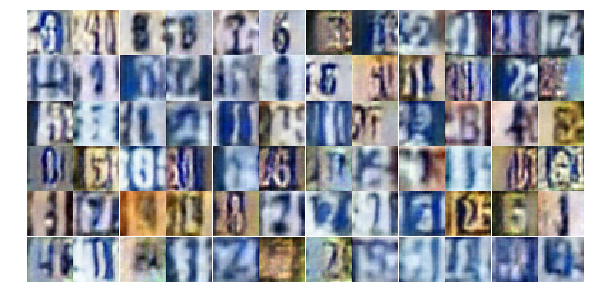

Epoch 7/25... Discriminator Loss: 1.1011... Generator Loss: 0.6802
Epoch 7/25... Discriminator Loss: 0.6294... Generator Loss: 1.2468
Epoch 7/25... Discriminator Loss: 0.5555... Generator Loss: 1.5207
Epoch 7/25... Discriminator Loss: 0.6961... Generator Loss: 0.9683
Epoch 7/25... Discriminator Loss: 0.7270... Generator Loss: 0.9187
Epoch 7/25... Discriminator Loss: 0.3073... Generator Loss: 2.1018
Epoch 7/25... Discriminator Loss: 0.5663... Generator Loss: 1.7248
Epoch 7/25... Discriminator Loss: 2.6857... Generator Loss: 0.1126
Epoch 7/25... Discriminator Loss: 0.6552... Generator Loss: 2.2476
Epoch 7/25... Discriminator Loss: 0.8958... Generator Loss: 1.1025


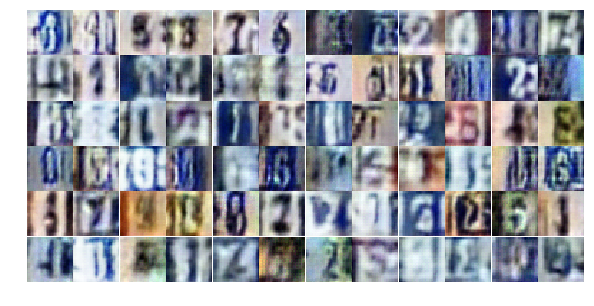

Epoch 7/25... Discriminator Loss: 0.5676... Generator Loss: 1.6958
Epoch 7/25... Discriminator Loss: 1.0074... Generator Loss: 0.6373
Epoch 7/25... Discriminator Loss: 0.8819... Generator Loss: 0.8311
Epoch 7/25... Discriminator Loss: 0.5467... Generator Loss: 1.2127
Epoch 7/25... Discriminator Loss: 0.5511... Generator Loss: 1.2361
Epoch 7/25... Discriminator Loss: 1.0915... Generator Loss: 0.7348
Epoch 7/25... Discriminator Loss: 1.3278... Generator Loss: 0.4748
Epoch 7/25... Discriminator Loss: 0.7152... Generator Loss: 1.3981
Epoch 7/25... Discriminator Loss: 0.8627... Generator Loss: 0.8117
Epoch 7/25... Discriminator Loss: 1.9530... Generator Loss: 0.2148


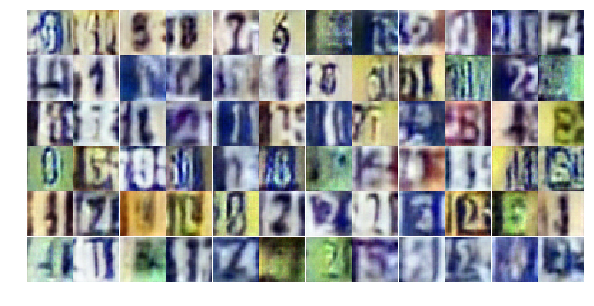

Epoch 7/25... Discriminator Loss: 0.6890... Generator Loss: 1.8598
Epoch 8/25... Discriminator Loss: 0.5639... Generator Loss: 1.5074
Epoch 8/25... Discriminator Loss: 0.9003... Generator Loss: 0.6496
Epoch 8/25... Discriminator Loss: 0.8961... Generator Loss: 0.7213
Epoch 8/25... Discriminator Loss: 0.6086... Generator Loss: 1.1164
Epoch 8/25... Discriminator Loss: 0.8732... Generator Loss: 0.7983
Epoch 8/25... Discriminator Loss: 0.7003... Generator Loss: 1.0118
Epoch 8/25... Discriminator Loss: 0.4678... Generator Loss: 1.3970
Epoch 8/25... Discriminator Loss: 0.7476... Generator Loss: 1.0081
Epoch 8/25... Discriminator Loss: 0.7285... Generator Loss: 0.9402


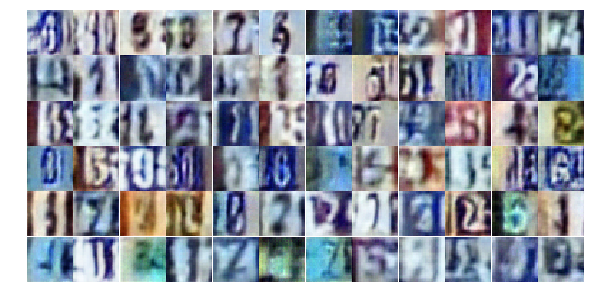

Epoch 8/25... Discriminator Loss: 0.4799... Generator Loss: 1.5316
Epoch 8/25... Discriminator Loss: 0.4484... Generator Loss: 1.6824
Epoch 8/25... Discriminator Loss: 1.3556... Generator Loss: 0.4475
Epoch 8/25... Discriminator Loss: 0.3673... Generator Loss: 1.8868
Epoch 8/25... Discriminator Loss: 1.0534... Generator Loss: 1.2152
Epoch 8/25... Discriminator Loss: 0.5591... Generator Loss: 1.3946
Epoch 8/25... Discriminator Loss: 0.5355... Generator Loss: 1.9673
Epoch 8/25... Discriminator Loss: 0.6285... Generator Loss: 1.5230
Epoch 8/25... Discriminator Loss: 0.7186... Generator Loss: 1.1872
Epoch 8/25... Discriminator Loss: 1.0211... Generator Loss: 0.6552


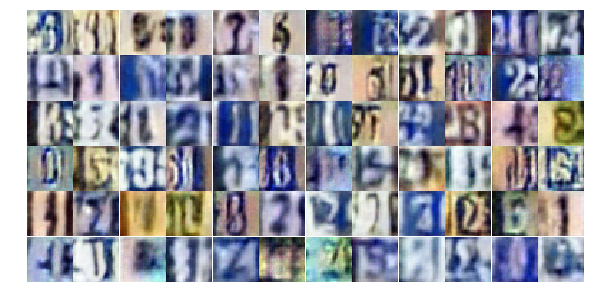

Epoch 8/25... Discriminator Loss: 0.5457... Generator Loss: 1.4817
Epoch 8/25... Discriminator Loss: 0.5254... Generator Loss: 1.2606
Epoch 8/25... Discriminator Loss: 0.8543... Generator Loss: 0.8362
Epoch 8/25... Discriminator Loss: 0.6459... Generator Loss: 1.2302
Epoch 8/25... Discriminator Loss: 0.4616... Generator Loss: 1.5696
Epoch 8/25... Discriminator Loss: 0.5405... Generator Loss: 1.5484
Epoch 8/25... Discriminator Loss: 0.7408... Generator Loss: 1.7476
Epoch 8/25... Discriminator Loss: 0.6511... Generator Loss: 1.0385
Epoch 8/25... Discriminator Loss: 0.6703... Generator Loss: 2.0551
Epoch 8/25... Discriminator Loss: 0.7365... Generator Loss: 1.0907


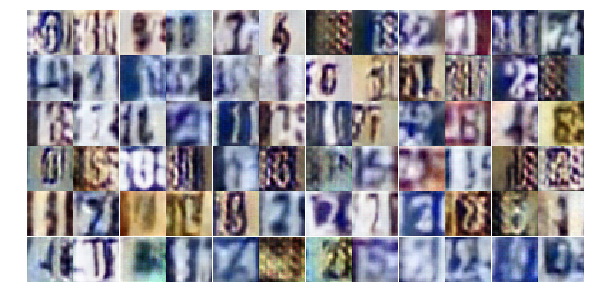

Epoch 8/25... Discriminator Loss: 0.6352... Generator Loss: 1.1662
Epoch 8/25... Discriminator Loss: 0.9627... Generator Loss: 0.7289
Epoch 8/25... Discriminator Loss: 0.5268... Generator Loss: 1.6880
Epoch 8/25... Discriminator Loss: 0.8737... Generator Loss: 0.7669
Epoch 8/25... Discriminator Loss: 0.9670... Generator Loss: 0.6687
Epoch 8/25... Discriminator Loss: 0.5688... Generator Loss: 1.1509
Epoch 8/25... Discriminator Loss: 0.5495... Generator Loss: 1.3222
Epoch 8/25... Discriminator Loss: 0.6249... Generator Loss: 1.1878
Epoch 8/25... Discriminator Loss: 0.6825... Generator Loss: 1.1871
Epoch 8/25... Discriminator Loss: 0.7785... Generator Loss: 1.0313


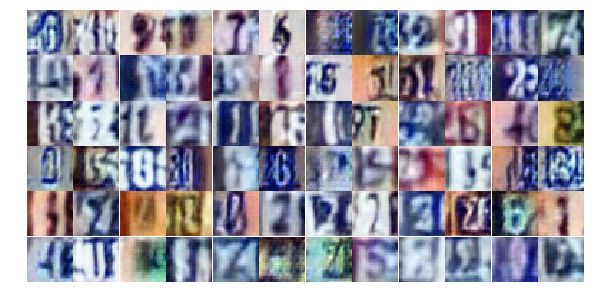

Epoch 8/25... Discriminator Loss: 0.5081... Generator Loss: 1.9500
Epoch 8/25... Discriminator Loss: 1.0397... Generator Loss: 0.6203
Epoch 8/25... Discriminator Loss: 0.7367... Generator Loss: 0.9430
Epoch 8/25... Discriminator Loss: 0.6164... Generator Loss: 1.0685
Epoch 8/25... Discriminator Loss: 1.1033... Generator Loss: 0.5813
Epoch 8/25... Discriminator Loss: 0.7480... Generator Loss: 0.9109
Epoch 8/25... Discriminator Loss: 0.5585... Generator Loss: 1.1176
Epoch 8/25... Discriminator Loss: 0.6579... Generator Loss: 1.1663
Epoch 8/25... Discriminator Loss: 1.1291... Generator Loss: 2.5849
Epoch 8/25... Discriminator Loss: 0.7807... Generator Loss: 1.7987


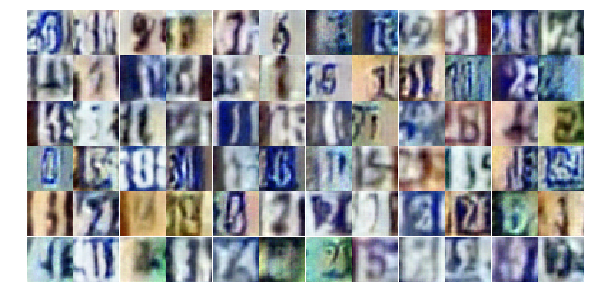

Epoch 8/25... Discriminator Loss: 0.4613... Generator Loss: 1.9682
Epoch 8/25... Discriminator Loss: 0.6397... Generator Loss: 1.1174
Epoch 8/25... Discriminator Loss: 0.4530... Generator Loss: 1.6758
Epoch 8/25... Discriminator Loss: 1.0390... Generator Loss: 0.6841
Epoch 8/25... Discriminator Loss: 0.3799... Generator Loss: 1.7980
Epoch 8/25... Discriminator Loss: 0.7912... Generator Loss: 0.9695
Epoch 8/25... Discriminator Loss: 0.6451... Generator Loss: 1.4986
Epoch 8/25... Discriminator Loss: 0.5887... Generator Loss: 1.7050
Epoch 9/25... Discriminator Loss: 0.6850... Generator Loss: 1.1270
Epoch 9/25... Discriminator Loss: 0.7458... Generator Loss: 0.9320


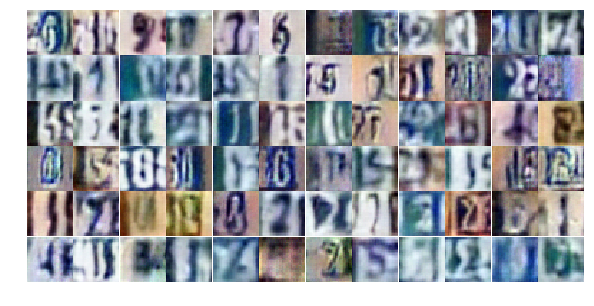

Epoch 9/25... Discriminator Loss: 0.6958... Generator Loss: 1.0050
Epoch 9/25... Discriminator Loss: 0.8407... Generator Loss: 0.7447
Epoch 9/25... Discriminator Loss: 0.8366... Generator Loss: 1.0073
Epoch 9/25... Discriminator Loss: 0.3809... Generator Loss: 1.8836
Epoch 9/25... Discriminator Loss: 1.7974... Generator Loss: 0.2579
Epoch 9/25... Discriminator Loss: 0.7100... Generator Loss: 1.1805
Epoch 9/25... Discriminator Loss: 0.9004... Generator Loss: 0.8226
Epoch 9/25... Discriminator Loss: 0.5907... Generator Loss: 1.3363
Epoch 9/25... Discriminator Loss: 0.7989... Generator Loss: 0.8651
Epoch 9/25... Discriminator Loss: 0.7736... Generator Loss: 0.9608


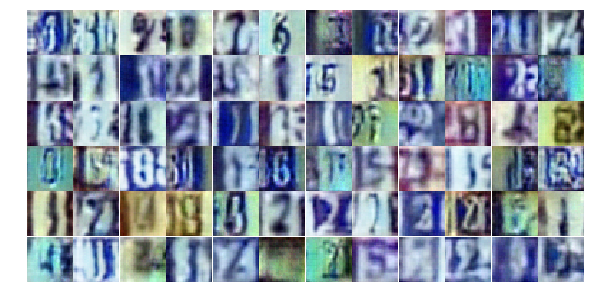

Epoch 9/25... Discriminator Loss: 1.0175... Generator Loss: 0.6519
Epoch 9/25... Discriminator Loss: 1.2514... Generator Loss: 0.4718
Epoch 9/25... Discriminator Loss: 0.6950... Generator Loss: 1.0449
Epoch 9/25... Discriminator Loss: 1.0425... Generator Loss: 0.6261
Epoch 9/25... Discriminator Loss: 0.4258... Generator Loss: 2.1158
Epoch 9/25... Discriminator Loss: 0.8463... Generator Loss: 0.8715
Epoch 9/25... Discriminator Loss: 0.9649... Generator Loss: 0.6645
Epoch 9/25... Discriminator Loss: 0.5208... Generator Loss: 1.4751
Epoch 9/25... Discriminator Loss: 0.9693... Generator Loss: 0.7188
Epoch 9/25... Discriminator Loss: 0.7593... Generator Loss: 0.9040


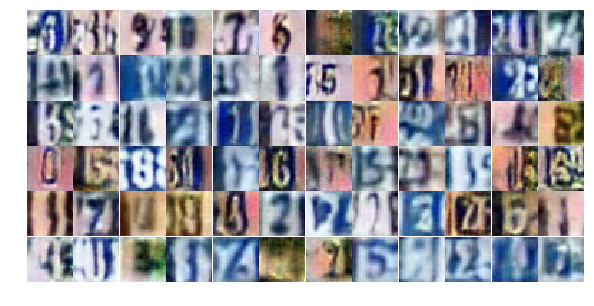

Epoch 9/25... Discriminator Loss: 0.8096... Generator Loss: 0.9750
Epoch 9/25... Discriminator Loss: 0.8195... Generator Loss: 0.7684
Epoch 9/25... Discriminator Loss: 0.6269... Generator Loss: 1.3783
Epoch 9/25... Discriminator Loss: 0.5968... Generator Loss: 1.1590
Epoch 9/25... Discriminator Loss: 0.6071... Generator Loss: 2.1291
Epoch 9/25... Discriminator Loss: 0.5124... Generator Loss: 1.4107
Epoch 9/25... Discriminator Loss: 1.1164... Generator Loss: 0.5438
Epoch 9/25... Discriminator Loss: 0.4842... Generator Loss: 1.8483
Epoch 9/25... Discriminator Loss: 0.8792... Generator Loss: 0.8471
Epoch 9/25... Discriminator Loss: 0.9001... Generator Loss: 0.6731


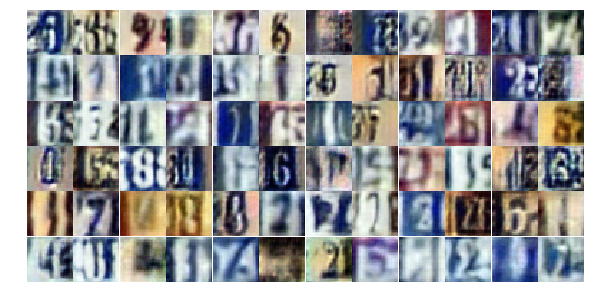

Epoch 9/25... Discriminator Loss: 0.8575... Generator Loss: 0.7480
Epoch 9/25... Discriminator Loss: 0.5718... Generator Loss: 1.2061
Epoch 9/25... Discriminator Loss: 1.1134... Generator Loss: 0.5308
Epoch 9/25... Discriminator Loss: 0.6271... Generator Loss: 1.6794
Epoch 9/25... Discriminator Loss: 0.5209... Generator Loss: 1.7678
Epoch 9/25... Discriminator Loss: 0.6396... Generator Loss: 1.5939
Epoch 9/25... Discriminator Loss: 0.5409... Generator Loss: 1.3181
Epoch 9/25... Discriminator Loss: 0.5221... Generator Loss: 1.2826
Epoch 9/25... Discriminator Loss: 1.3727... Generator Loss: 0.3993
Epoch 9/25... Discriminator Loss: 1.0758... Generator Loss: 0.5833


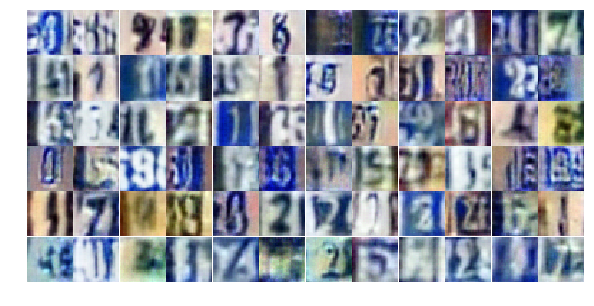

Epoch 9/25... Discriminator Loss: 0.5224... Generator Loss: 1.9416
Epoch 9/25... Discriminator Loss: 0.5023... Generator Loss: 1.8578
Epoch 9/25... Discriminator Loss: 0.5924... Generator Loss: 1.1779
Epoch 9/25... Discriminator Loss: 0.5622... Generator Loss: 1.4025
Epoch 9/25... Discriminator Loss: 0.4297... Generator Loss: 1.3724
Epoch 9/25... Discriminator Loss: 0.6772... Generator Loss: 1.4116
Epoch 9/25... Discriminator Loss: 0.8981... Generator Loss: 1.0185
Epoch 9/25... Discriminator Loss: 0.9690... Generator Loss: 0.7381
Epoch 9/25... Discriminator Loss: 0.5186... Generator Loss: 1.5302
Epoch 9/25... Discriminator Loss: 1.0454... Generator Loss: 3.2836


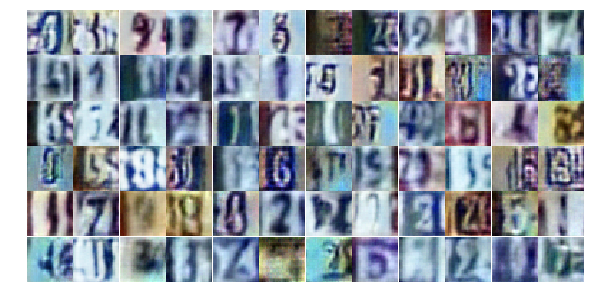

Epoch 9/25... Discriminator Loss: 1.7701... Generator Loss: 0.2507
Epoch 9/25... Discriminator Loss: 1.2943... Generator Loss: 3.6877
Epoch 9/25... Discriminator Loss: 0.7625... Generator Loss: 0.9310
Epoch 9/25... Discriminator Loss: 1.4275... Generator Loss: 0.3802
Epoch 9/25... Discriminator Loss: 0.7682... Generator Loss: 1.0191
Epoch 10/25... Discriminator Loss: 0.6312... Generator Loss: 1.2845
Epoch 10/25... Discriminator Loss: 0.6016... Generator Loss: 1.1762
Epoch 10/25... Discriminator Loss: 0.5633... Generator Loss: 1.1672
Epoch 10/25... Discriminator Loss: 0.5988... Generator Loss: 1.1675
Epoch 10/25... Discriminator Loss: 1.3495... Generator Loss: 0.4069


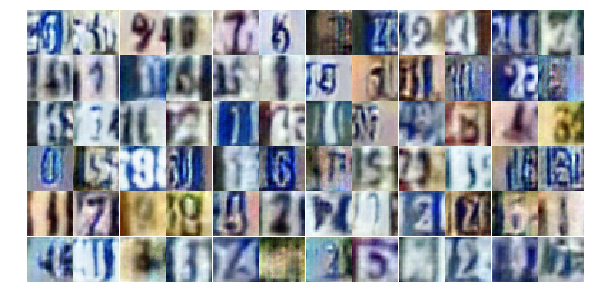

Epoch 10/25... Discriminator Loss: 0.5720... Generator Loss: 1.1260
Epoch 10/25... Discriminator Loss: 0.5191... Generator Loss: 1.3721
Epoch 10/25... Discriminator Loss: 0.5136... Generator Loss: 1.3227
Epoch 10/25... Discriminator Loss: 0.6280... Generator Loss: 1.5910
Epoch 10/25... Discriminator Loss: 0.6101... Generator Loss: 1.8182
Epoch 10/25... Discriminator Loss: 0.6962... Generator Loss: 1.0790
Epoch 10/25... Discriminator Loss: 0.4463... Generator Loss: 1.3420
Epoch 10/25... Discriminator Loss: 1.4679... Generator Loss: 0.4150
Epoch 10/25... Discriminator Loss: 1.3870... Generator Loss: 0.3791
Epoch 10/25... Discriminator Loss: 0.8778... Generator Loss: 0.8786


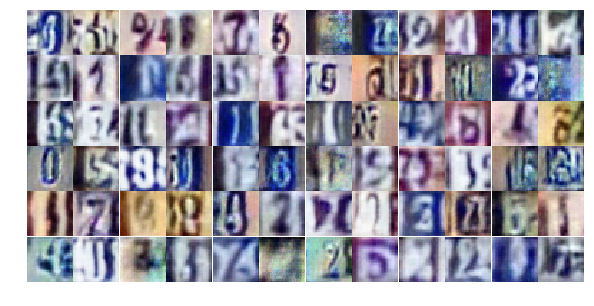

Epoch 10/25... Discriminator Loss: 0.7057... Generator Loss: 1.2343
Epoch 10/25... Discriminator Loss: 0.8190... Generator Loss: 0.8023
Epoch 10/25... Discriminator Loss: 0.7020... Generator Loss: 1.3892
Epoch 10/25... Discriminator Loss: 1.2247... Generator Loss: 0.4860
Epoch 10/25... Discriminator Loss: 0.6904... Generator Loss: 1.0805
Epoch 10/25... Discriminator Loss: 0.6489... Generator Loss: 1.1518
Epoch 10/25... Discriminator Loss: 0.7027... Generator Loss: 1.0405
Epoch 10/25... Discriminator Loss: 0.5011... Generator Loss: 1.4499
Epoch 10/25... Discriminator Loss: 0.6221... Generator Loss: 1.2309
Epoch 10/25... Discriminator Loss: 0.3227... Generator Loss: 1.9599


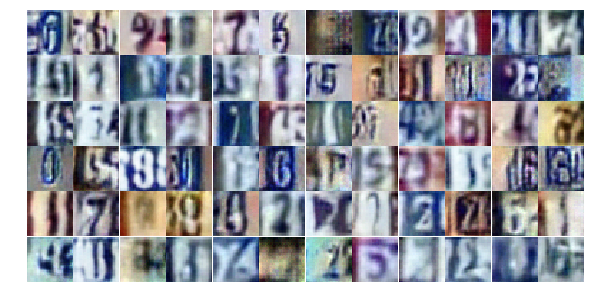

Epoch 10/25... Discriminator Loss: 0.9839... Generator Loss: 0.6319
Epoch 10/25... Discriminator Loss: 0.7541... Generator Loss: 0.8875
Epoch 10/25... Discriminator Loss: 0.3770... Generator Loss: 2.1563
Epoch 10/25... Discriminator Loss: 0.4039... Generator Loss: 2.4488
Epoch 10/25... Discriminator Loss: 0.9527... Generator Loss: 0.6573
Epoch 10/25... Discriminator Loss: 0.6991... Generator Loss: 1.0464
Epoch 10/25... Discriminator Loss: 0.4406... Generator Loss: 1.5052
Epoch 10/25... Discriminator Loss: 0.6276... Generator Loss: 1.2581
Epoch 10/25... Discriminator Loss: 1.1317... Generator Loss: 0.5596
Epoch 10/25... Discriminator Loss: 0.9520... Generator Loss: 2.0280


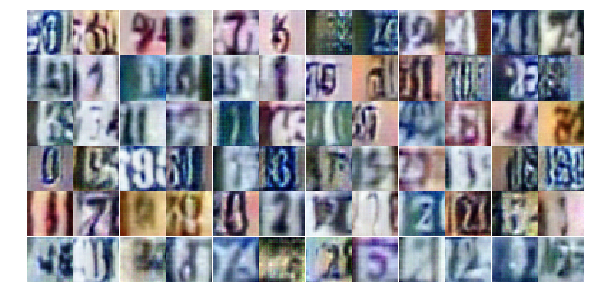

Epoch 10/25... Discriminator Loss: 0.6256... Generator Loss: 1.8382
Epoch 10/25... Discriminator Loss: 0.5773... Generator Loss: 1.3143
Epoch 10/25... Discriminator Loss: 0.7040... Generator Loss: 2.8289
Epoch 10/25... Discriminator Loss: 1.0254... Generator Loss: 2.5883
Epoch 10/25... Discriminator Loss: 1.1064... Generator Loss: 0.5721
Epoch 10/25... Discriminator Loss: 0.7834... Generator Loss: 1.0027
Epoch 10/25... Discriminator Loss: 0.8914... Generator Loss: 0.7590
Epoch 10/25... Discriminator Loss: 0.8019... Generator Loss: 0.9009
Epoch 10/25... Discriminator Loss: 0.7040... Generator Loss: 0.9862
Epoch 10/25... Discriminator Loss: 0.4365... Generator Loss: 2.4261


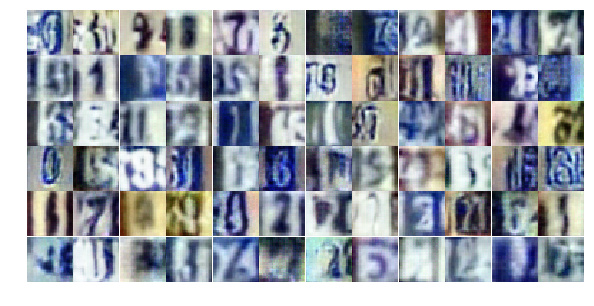

Epoch 10/25... Discriminator Loss: 0.5896... Generator Loss: 1.3892
Epoch 10/25... Discriminator Loss: 1.0033... Generator Loss: 0.6364
Epoch 10/25... Discriminator Loss: 0.7219... Generator Loss: 0.9240
Epoch 10/25... Discriminator Loss: 0.9776... Generator Loss: 0.6648
Epoch 10/25... Discriminator Loss: 0.4778... Generator Loss: 1.7305
Epoch 10/25... Discriminator Loss: 0.5123... Generator Loss: 1.3229
Epoch 10/25... Discriminator Loss: 0.5673... Generator Loss: 1.1369
Epoch 10/25... Discriminator Loss: 0.5607... Generator Loss: 1.1520
Epoch 10/25... Discriminator Loss: 0.7302... Generator Loss: 2.0977
Epoch 10/25... Discriminator Loss: 0.6041... Generator Loss: 2.0360


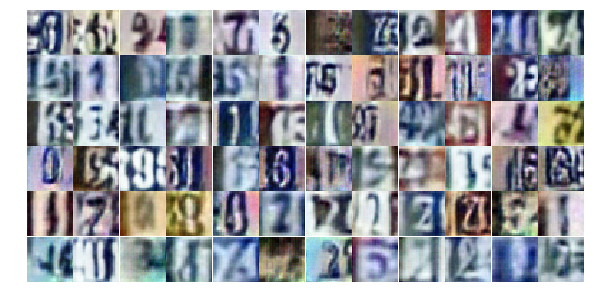

Epoch 10/25... Discriminator Loss: 0.6894... Generator Loss: 1.4001
Epoch 10/25... Discriminator Loss: 0.6213... Generator Loss: 1.1600
Epoch 10/25... Discriminator Loss: 0.5699... Generator Loss: 1.1847
Epoch 11/25... Discriminator Loss: 0.9083... Generator Loss: 0.7572
Epoch 11/25... Discriminator Loss: 0.5704... Generator Loss: 1.0994
Epoch 11/25... Discriminator Loss: 0.9478... Generator Loss: 0.6745
Epoch 11/25... Discriminator Loss: 0.6946... Generator Loss: 0.9760
Epoch 11/25... Discriminator Loss: 0.6818... Generator Loss: 1.2245
Epoch 11/25... Discriminator Loss: 1.5997... Generator Loss: 0.3093
Epoch 11/25... Discriminator Loss: 0.5491... Generator Loss: 1.7173


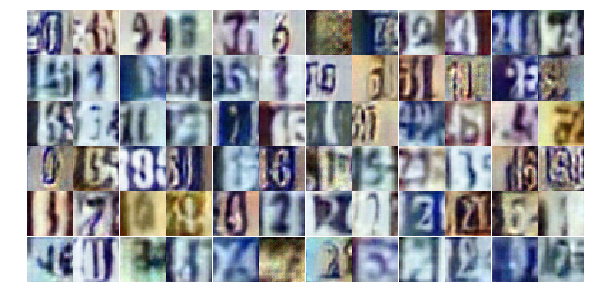

Epoch 11/25... Discriminator Loss: 0.2702... Generator Loss: 2.2696
Epoch 11/25... Discriminator Loss: 0.6231... Generator Loss: 1.4487
Epoch 11/25... Discriminator Loss: 0.4860... Generator Loss: 1.3226
Epoch 11/25... Discriminator Loss: 0.7862... Generator Loss: 0.8076
Epoch 11/25... Discriminator Loss: 0.6572... Generator Loss: 1.7585
Epoch 11/25... Discriminator Loss: 0.4191... Generator Loss: 1.8099
Epoch 11/25... Discriminator Loss: 0.5941... Generator Loss: 1.7625
Epoch 11/25... Discriminator Loss: 0.5732... Generator Loss: 1.8907
Epoch 11/25... Discriminator Loss: 0.5887... Generator Loss: 1.1690
Epoch 11/25... Discriminator Loss: 1.4269... Generator Loss: 0.3956


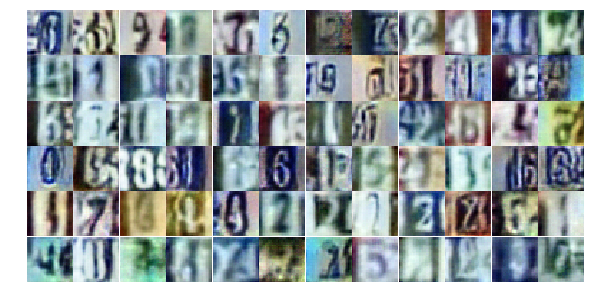

Epoch 11/25... Discriminator Loss: 0.7434... Generator Loss: 1.0173
Epoch 11/25... Discriminator Loss: 0.6021... Generator Loss: 1.7894
Epoch 11/25... Discriminator Loss: 0.7203... Generator Loss: 0.9543
Epoch 11/25... Discriminator Loss: 0.7686... Generator Loss: 0.8179
Epoch 11/25... Discriminator Loss: 0.4278... Generator Loss: 1.5134
Epoch 11/25... Discriminator Loss: 0.4415... Generator Loss: 1.5980
Epoch 11/25... Discriminator Loss: 0.4641... Generator Loss: 1.3642
Epoch 11/25... Discriminator Loss: 1.0275... Generator Loss: 0.6842
Epoch 11/25... Discriminator Loss: 0.4444... Generator Loss: 1.9006
Epoch 11/25... Discriminator Loss: 1.2139... Generator Loss: 0.4895


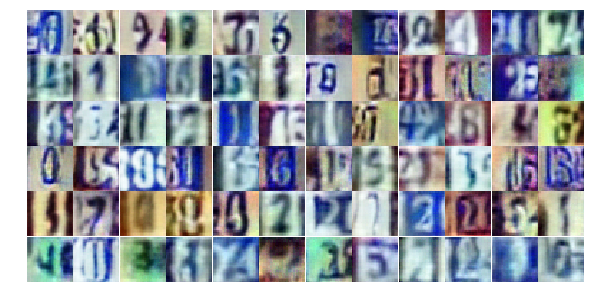

Epoch 11/25... Discriminator Loss: 0.8136... Generator Loss: 1.6942
Epoch 11/25... Discriminator Loss: 0.7048... Generator Loss: 0.9925
Epoch 11/25... Discriminator Loss: 0.8254... Generator Loss: 0.8595
Epoch 11/25... Discriminator Loss: 0.6956... Generator Loss: 3.1650
Epoch 11/25... Discriminator Loss: 0.7431... Generator Loss: 0.9548
Epoch 11/25... Discriminator Loss: 1.1506... Generator Loss: 0.5256
Epoch 11/25... Discriminator Loss: 1.2376... Generator Loss: 0.5149
Epoch 11/25... Discriminator Loss: 0.9902... Generator Loss: 0.6352
Epoch 11/25... Discriminator Loss: 0.5719... Generator Loss: 1.1540
Epoch 11/25... Discriminator Loss: 1.0999... Generator Loss: 0.5412


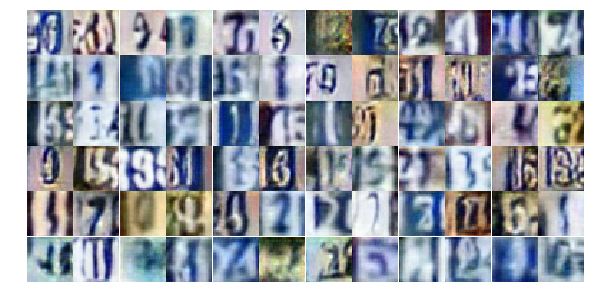

Epoch 11/25... Discriminator Loss: 0.4782... Generator Loss: 1.4470
Epoch 11/25... Discriminator Loss: 0.4923... Generator Loss: 1.6110
Epoch 11/25... Discriminator Loss: 0.7942... Generator Loss: 0.8609
Epoch 11/25... Discriminator Loss: 0.7254... Generator Loss: 1.4613
Epoch 11/25... Discriminator Loss: 0.9634... Generator Loss: 0.6279
Epoch 11/25... Discriminator Loss: 0.5613... Generator Loss: 1.2393
Epoch 11/25... Discriminator Loss: 2.1248... Generator Loss: 0.2134
Epoch 11/25... Discriminator Loss: 0.7026... Generator Loss: 1.6181
Epoch 11/25... Discriminator Loss: 1.3480... Generator Loss: 0.4688
Epoch 11/25... Discriminator Loss: 0.4703... Generator Loss: 1.5206


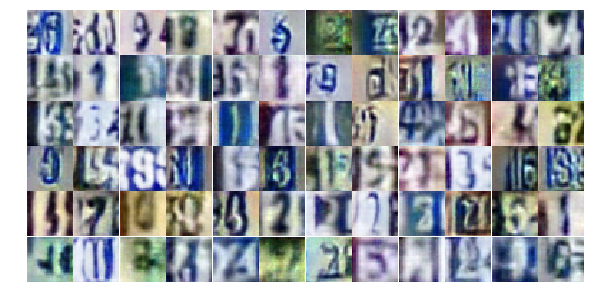

Epoch 11/25... Discriminator Loss: 0.8243... Generator Loss: 0.8436
Epoch 11/25... Discriminator Loss: 0.3738... Generator Loss: 1.9225
Epoch 11/25... Discriminator Loss: 0.6286... Generator Loss: 1.1588
Epoch 11/25... Discriminator Loss: 0.6853... Generator Loss: 1.0056
Epoch 11/25... Discriminator Loss: 1.2576... Generator Loss: 0.4599
Epoch 11/25... Discriminator Loss: 0.6460... Generator Loss: 1.0768
Epoch 11/25... Discriminator Loss: 1.6855... Generator Loss: 0.3720
Epoch 11/25... Discriminator Loss: 0.4560... Generator Loss: 1.8870
Epoch 11/25... Discriminator Loss: 0.8553... Generator Loss: 0.7689
Epoch 11/25... Discriminator Loss: 0.9270... Generator Loss: 0.7029


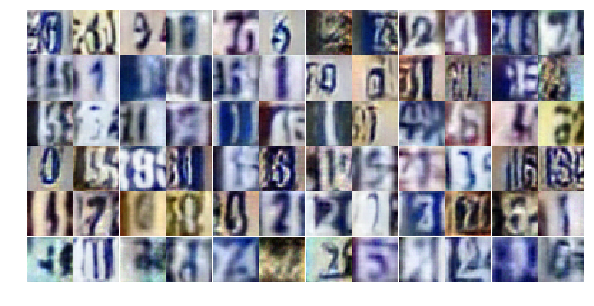

Epoch 12/25... Discriminator Loss: 0.6081... Generator Loss: 1.4806
Epoch 12/25... Discriminator Loss: 0.5047... Generator Loss: 1.2757
Epoch 12/25... Discriminator Loss: 0.8392... Generator Loss: 0.8417
Epoch 12/25... Discriminator Loss: 0.5151... Generator Loss: 1.3425
Epoch 12/25... Discriminator Loss: 0.4088... Generator Loss: 1.8269
Epoch 12/25... Discriminator Loss: 0.7992... Generator Loss: 0.8167
Epoch 12/25... Discriminator Loss: 0.9846... Generator Loss: 0.6335
Epoch 12/25... Discriminator Loss: 0.5700... Generator Loss: 1.5597
Epoch 12/25... Discriminator Loss: 0.6897... Generator Loss: 1.6938
Epoch 12/25... Discriminator Loss: 1.6672... Generator Loss: 0.2958


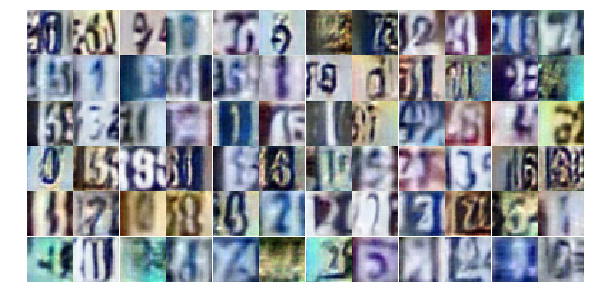

Epoch 12/25... Discriminator Loss: 0.5663... Generator Loss: 1.1508
Epoch 12/25... Discriminator Loss: 1.2823... Generator Loss: 0.4566
Epoch 12/25... Discriminator Loss: 0.5059... Generator Loss: 1.4613
Epoch 12/25... Discriminator Loss: 1.3168... Generator Loss: 0.5045
Epoch 12/25... Discriminator Loss: 0.6644... Generator Loss: 1.2549
Epoch 12/25... Discriminator Loss: 1.1976... Generator Loss: 0.7484
Epoch 12/25... Discriminator Loss: 2.0984... Generator Loss: 0.1844
Epoch 12/25... Discriminator Loss: 0.4573... Generator Loss: 1.6597
Epoch 12/25... Discriminator Loss: 0.6794... Generator Loss: 0.9176
Epoch 12/25... Discriminator Loss: 1.0281... Generator Loss: 0.6136


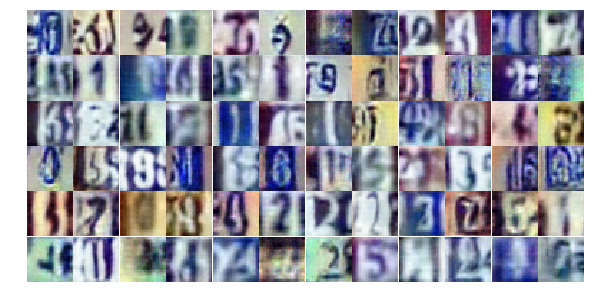

Epoch 12/25... Discriminator Loss: 0.4340... Generator Loss: 1.3134
Epoch 12/25... Discriminator Loss: 0.5131... Generator Loss: 1.1928
Epoch 12/25... Discriminator Loss: 0.6902... Generator Loss: 1.0316
Epoch 12/25... Discriminator Loss: 0.4934... Generator Loss: 1.5036
Epoch 12/25... Discriminator Loss: 0.2971... Generator Loss: 2.0818
Epoch 12/25... Discriminator Loss: 0.5887... Generator Loss: 1.1738
Epoch 12/25... Discriminator Loss: 0.8652... Generator Loss: 0.7510
Epoch 12/25... Discriminator Loss: 0.5163... Generator Loss: 1.3904
Epoch 12/25... Discriminator Loss: 0.4161... Generator Loss: 1.6772
Epoch 12/25... Discriminator Loss: 0.6299... Generator Loss: 1.4735


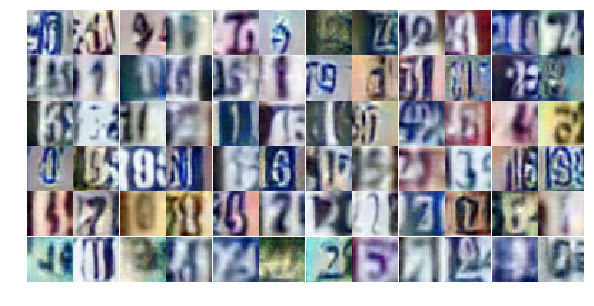

Epoch 12/25... Discriminator Loss: 0.6874... Generator Loss: 1.0401
Epoch 12/25... Discriminator Loss: 0.8529... Generator Loss: 0.8096
Epoch 12/25... Discriminator Loss: 0.7977... Generator Loss: 0.8812
Epoch 12/25... Discriminator Loss: 1.7366... Generator Loss: 0.2707
Epoch 12/25... Discriminator Loss: 0.5818... Generator Loss: 1.6528
Epoch 12/25... Discriminator Loss: 0.8469... Generator Loss: 0.8353
Epoch 12/25... Discriminator Loss: 1.0736... Generator Loss: 0.5477
Epoch 12/25... Discriminator Loss: 0.7483... Generator Loss: 1.2444
Epoch 12/25... Discriminator Loss: 0.4675... Generator Loss: 1.3877
Epoch 12/25... Discriminator Loss: 0.3079... Generator Loss: 1.9261


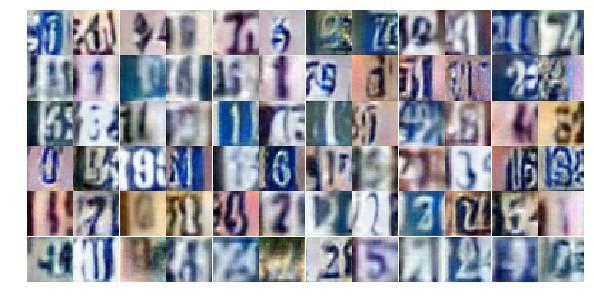

Epoch 12/25... Discriminator Loss: 0.4678... Generator Loss: 1.5168
Epoch 12/25... Discriminator Loss: 0.3843... Generator Loss: 1.9366
Epoch 12/25... Discriminator Loss: 0.4751... Generator Loss: 1.3179
Epoch 12/25... Discriminator Loss: 0.8407... Generator Loss: 1.1471
Epoch 12/25... Discriminator Loss: 1.4838... Generator Loss: 0.3936
Epoch 12/25... Discriminator Loss: 1.5412... Generator Loss: 0.3369
Epoch 12/25... Discriminator Loss: 0.6458... Generator Loss: 1.1317
Epoch 12/25... Discriminator Loss: 0.8461... Generator Loss: 0.7888
Epoch 12/25... Discriminator Loss: 0.4730... Generator Loss: 1.7452
Epoch 12/25... Discriminator Loss: 0.7414... Generator Loss: 0.8578


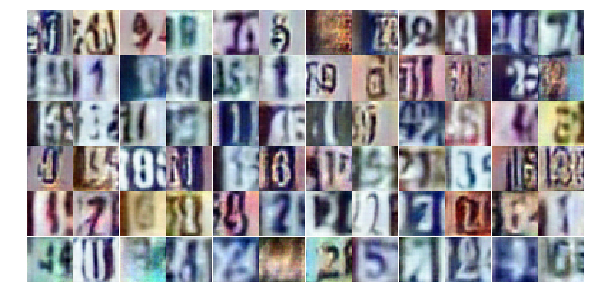

Epoch 12/25... Discriminator Loss: 0.9347... Generator Loss: 0.7294
Epoch 12/25... Discriminator Loss: 0.6165... Generator Loss: 1.2962
Epoch 12/25... Discriminator Loss: 0.7213... Generator Loss: 1.0871
Epoch 12/25... Discriminator Loss: 0.9168... Generator Loss: 0.8212
Epoch 12/25... Discriminator Loss: 0.5054... Generator Loss: 1.3509
Epoch 12/25... Discriminator Loss: 0.7275... Generator Loss: 1.5614
Epoch 12/25... Discriminator Loss: 0.8947... Generator Loss: 0.7348
Epoch 13/25... Discriminator Loss: 0.4425... Generator Loss: 1.4491
Epoch 13/25... Discriminator Loss: 0.4631... Generator Loss: 1.7433
Epoch 13/25... Discriminator Loss: 1.1425... Generator Loss: 0.6278


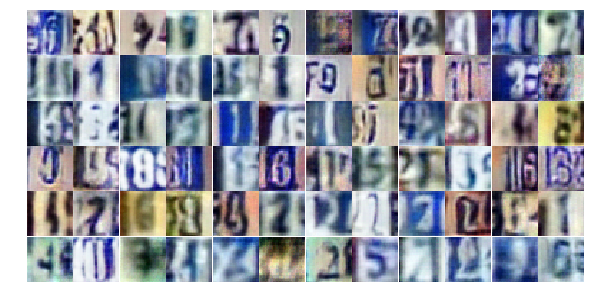

Epoch 13/25... Discriminator Loss: 0.5320... Generator Loss: 1.6713
Epoch 13/25... Discriminator Loss: 0.6396... Generator Loss: 1.3573
Epoch 13/25... Discriminator Loss: 1.1495... Generator Loss: 0.5496
Epoch 13/25... Discriminator Loss: 0.9012... Generator Loss: 0.7470
Epoch 13/25... Discriminator Loss: 0.8192... Generator Loss: 0.8670
Epoch 13/25... Discriminator Loss: 0.6038... Generator Loss: 1.2309
Epoch 13/25... Discriminator Loss: 0.3845... Generator Loss: 1.7219
Epoch 13/25... Discriminator Loss: 0.5299... Generator Loss: 1.2279
Epoch 13/25... Discriminator Loss: 0.4114... Generator Loss: 1.6107
Epoch 13/25... Discriminator Loss: 0.4364... Generator Loss: 2.0356


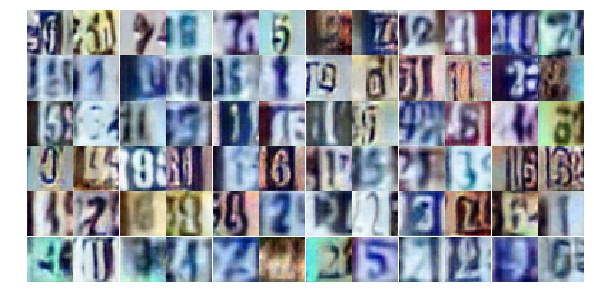

Epoch 13/25... Discriminator Loss: 1.3298... Generator Loss: 3.6217
Epoch 13/25... Discriminator Loss: 0.5738... Generator Loss: 1.2141
Epoch 13/25... Discriminator Loss: 0.9588... Generator Loss: 0.7734
Epoch 13/25... Discriminator Loss: 0.5523... Generator Loss: 1.2378
Epoch 13/25... Discriminator Loss: 0.5800... Generator Loss: 1.3276
Epoch 13/25... Discriminator Loss: 0.7131... Generator Loss: 1.1789
Epoch 13/25... Discriminator Loss: 0.8676... Generator Loss: 0.8156
Epoch 13/25... Discriminator Loss: 1.0497... Generator Loss: 0.5980
Epoch 13/25... Discriminator Loss: 0.4309... Generator Loss: 1.6943
Epoch 13/25... Discriminator Loss: 1.2358... Generator Loss: 0.4819


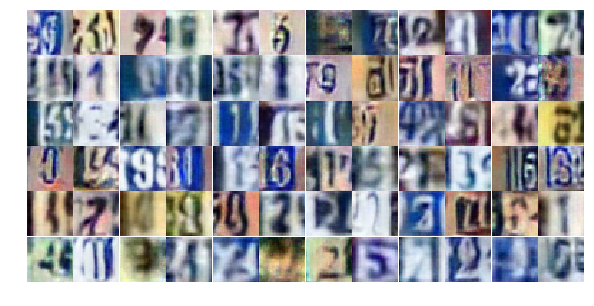

Epoch 13/25... Discriminator Loss: 0.6605... Generator Loss: 1.0843
Epoch 13/25... Discriminator Loss: 0.4797... Generator Loss: 1.4937
Epoch 13/25... Discriminator Loss: 0.6502... Generator Loss: 1.8247
Epoch 13/25... Discriminator Loss: 0.8048... Generator Loss: 0.8130
Epoch 13/25... Discriminator Loss: 0.6554... Generator Loss: 1.1129
Epoch 13/25... Discriminator Loss: 1.1201... Generator Loss: 0.5571
Epoch 13/25... Discriminator Loss: 0.9119... Generator Loss: 1.5534
Epoch 13/25... Discriminator Loss: 0.4093... Generator Loss: 1.6364
Epoch 13/25... Discriminator Loss: 0.5410... Generator Loss: 1.2261
Epoch 13/25... Discriminator Loss: 0.4389... Generator Loss: 1.8464


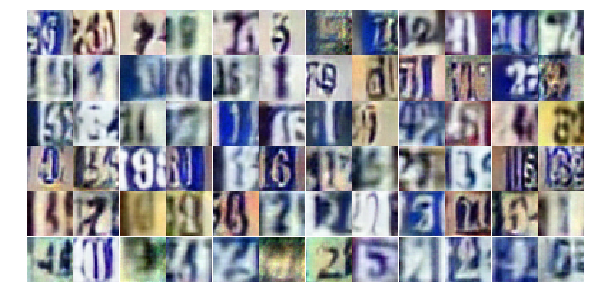

Epoch 13/25... Discriminator Loss: 0.8689... Generator Loss: 0.8777
Epoch 13/25... Discriminator Loss: 0.8959... Generator Loss: 0.8260
Epoch 13/25... Discriminator Loss: 0.9655... Generator Loss: 0.7160
Epoch 13/25... Discriminator Loss: 1.4559... Generator Loss: 0.4013
Epoch 13/25... Discriminator Loss: 0.5875... Generator Loss: 1.6794
Epoch 13/25... Discriminator Loss: 0.4093... Generator Loss: 1.7898
Epoch 13/25... Discriminator Loss: 0.5578... Generator Loss: 1.2972
Epoch 13/25... Discriminator Loss: 0.7291... Generator Loss: 1.4081
Epoch 13/25... Discriminator Loss: 0.7152... Generator Loss: 0.9235
Epoch 13/25... Discriminator Loss: 0.5888... Generator Loss: 1.1546


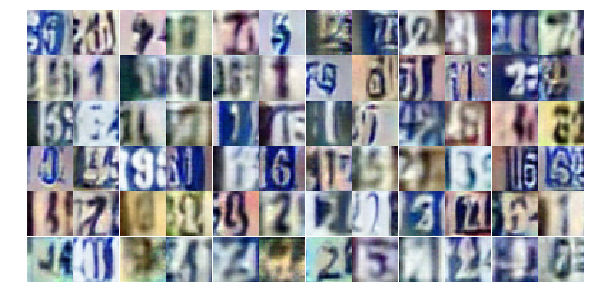

Epoch 13/25... Discriminator Loss: 0.5797... Generator Loss: 1.1912
Epoch 13/25... Discriminator Loss: 1.2369... Generator Loss: 0.6193
Epoch 13/25... Discriminator Loss: 0.6658... Generator Loss: 1.2143
Epoch 13/25... Discriminator Loss: 0.5397... Generator Loss: 1.3270
Epoch 13/25... Discriminator Loss: 0.8963... Generator Loss: 0.7814
Epoch 13/25... Discriminator Loss: 0.6649... Generator Loss: 1.1643
Epoch 13/25... Discriminator Loss: 0.5528... Generator Loss: 1.1677
Epoch 13/25... Discriminator Loss: 0.6983... Generator Loss: 0.9461
Epoch 13/25... Discriminator Loss: 1.4002... Generator Loss: 0.4213
Epoch 13/25... Discriminator Loss: 1.3598... Generator Loss: 0.4779


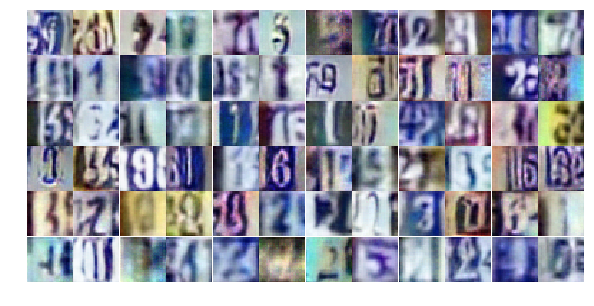

Epoch 13/25... Discriminator Loss: 0.4525... Generator Loss: 1.4386
Epoch 13/25... Discriminator Loss: 0.9076... Generator Loss: 0.8484
Epoch 13/25... Discriminator Loss: 0.6024... Generator Loss: 1.3618
Epoch 13/25... Discriminator Loss: 1.5604... Generator Loss: 0.3107
Epoch 14/25... Discriminator Loss: 0.8996... Generator Loss: 0.7499
Epoch 14/25... Discriminator Loss: 0.6025... Generator Loss: 1.3574
Epoch 14/25... Discriminator Loss: 0.9081... Generator Loss: 0.7752
Epoch 14/25... Discriminator Loss: 0.5873... Generator Loss: 1.5289
Epoch 14/25... Discriminator Loss: 0.6118... Generator Loss: 1.2537
Epoch 14/25... Discriminator Loss: 1.0849... Generator Loss: 0.5823


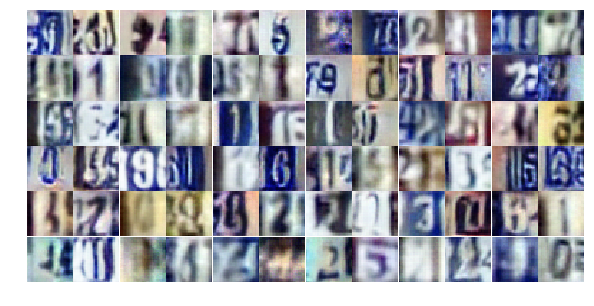

Epoch 14/25... Discriminator Loss: 0.6340... Generator Loss: 2.0568
Epoch 14/25... Discriminator Loss: 0.5235... Generator Loss: 1.8693
Epoch 14/25... Discriminator Loss: 0.5285... Generator Loss: 1.6260
Epoch 14/25... Discriminator Loss: 0.9758... Generator Loss: 0.6833
Epoch 14/25... Discriminator Loss: 1.7835... Generator Loss: 0.2336
Epoch 14/25... Discriminator Loss: 0.3939... Generator Loss: 1.6948
Epoch 14/25... Discriminator Loss: 0.5619... Generator Loss: 1.7519
Epoch 14/25... Discriminator Loss: 1.6034... Generator Loss: 0.3222
Epoch 14/25... Discriminator Loss: 2.1319... Generator Loss: 0.1868
Epoch 14/25... Discriminator Loss: 2.0757... Generator Loss: 0.2175


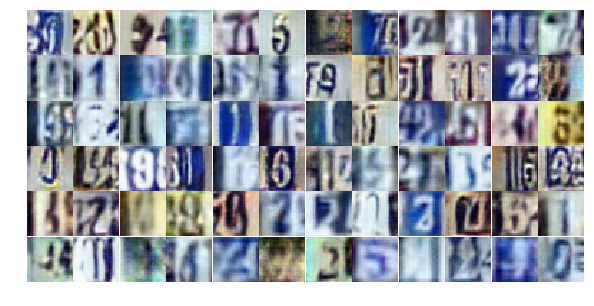

Epoch 14/25... Discriminator Loss: 0.6998... Generator Loss: 0.9804
Epoch 14/25... Discriminator Loss: 0.5186... Generator Loss: 1.8968
Epoch 14/25... Discriminator Loss: 0.7792... Generator Loss: 1.6979
Epoch 14/25... Discriminator Loss: 0.4822... Generator Loss: 1.4414
Epoch 14/25... Discriminator Loss: 0.9854... Generator Loss: 0.6878
Epoch 14/25... Discriminator Loss: 0.7780... Generator Loss: 1.1307
Epoch 14/25... Discriminator Loss: 1.0442... Generator Loss: 0.6238
Epoch 14/25... Discriminator Loss: 0.5296... Generator Loss: 1.3651
Epoch 14/25... Discriminator Loss: 0.6386... Generator Loss: 1.0970
Epoch 14/25... Discriminator Loss: 0.7076... Generator Loss: 1.0084


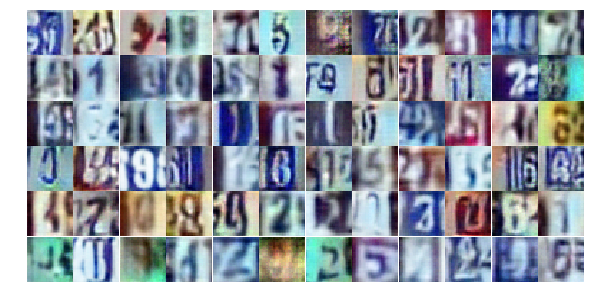

Epoch 14/25... Discriminator Loss: 1.1567... Generator Loss: 0.6154
Epoch 14/25... Discriminator Loss: 0.6141... Generator Loss: 1.1449
Epoch 14/25... Discriminator Loss: 0.5434... Generator Loss: 1.2278
Epoch 14/25... Discriminator Loss: 0.5764... Generator Loss: 1.2854
Epoch 14/25... Discriminator Loss: 0.5374... Generator Loss: 1.6359
Epoch 14/25... Discriminator Loss: 0.8671... Generator Loss: 0.8250
Epoch 14/25... Discriminator Loss: 0.8602... Generator Loss: 0.7732
Epoch 14/25... Discriminator Loss: 0.4859... Generator Loss: 1.2506
Epoch 14/25... Discriminator Loss: 0.5701... Generator Loss: 1.4245
Epoch 14/25... Discriminator Loss: 0.7867... Generator Loss: 1.6147


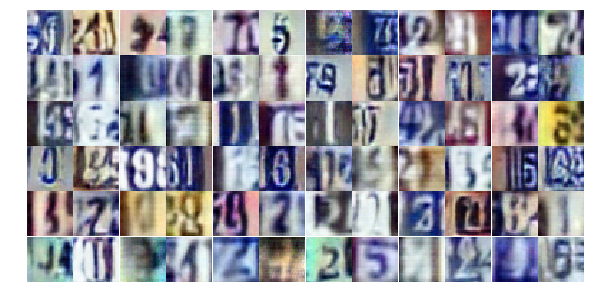

Epoch 14/25... Discriminator Loss: 1.4356... Generator Loss: 0.3712
Epoch 14/25... Discriminator Loss: 0.7972... Generator Loss: 1.2146
Epoch 14/25... Discriminator Loss: 0.6278... Generator Loss: 1.0698
Epoch 14/25... Discriminator Loss: 1.0965... Generator Loss: 0.5799
Epoch 14/25... Discriminator Loss: 0.7117... Generator Loss: 0.9540
Epoch 14/25... Discriminator Loss: 1.0420... Generator Loss: 0.6251
Epoch 14/25... Discriminator Loss: 0.6018... Generator Loss: 1.5574
Epoch 14/25... Discriminator Loss: 0.6389... Generator Loss: 1.3312
Epoch 14/25... Discriminator Loss: 0.6749... Generator Loss: 1.3383
Epoch 14/25... Discriminator Loss: 1.1120... Generator Loss: 0.5917


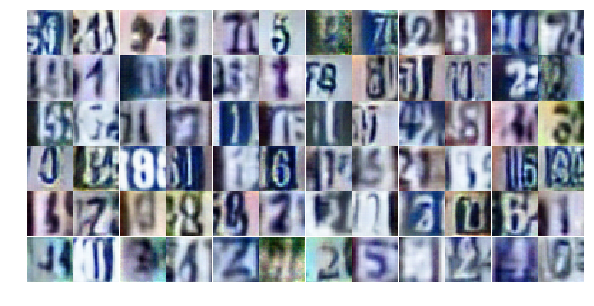

Epoch 14/25... Discriminator Loss: 1.0410... Generator Loss: 0.6747
Epoch 14/25... Discriminator Loss: 1.2395... Generator Loss: 0.4646
Epoch 14/25... Discriminator Loss: 0.5384... Generator Loss: 1.8462
Epoch 14/25... Discriminator Loss: 0.6624... Generator Loss: 1.0582
Epoch 14/25... Discriminator Loss: 0.4802... Generator Loss: 1.5180
Epoch 14/25... Discriminator Loss: 0.4469... Generator Loss: 1.8255
Epoch 14/25... Discriminator Loss: 1.6570... Generator Loss: 0.4901
Epoch 14/25... Discriminator Loss: 0.7255... Generator Loss: 0.9833
Epoch 14/25... Discriminator Loss: 1.3891... Generator Loss: 0.4164
Epoch 14/25... Discriminator Loss: 1.4779... Generator Loss: 0.3752


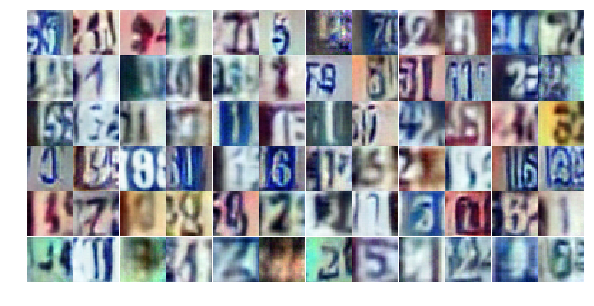

Epoch 14/25... Discriminator Loss: 0.6373... Generator Loss: 1.2883
Epoch 14/25... Discriminator Loss: 0.8558... Generator Loss: 0.9136
Epoch 15/25... Discriminator Loss: 0.8633... Generator Loss: 0.7447
Epoch 15/25... Discriminator Loss: 0.4413... Generator Loss: 1.7919
Epoch 15/25... Discriminator Loss: 0.7886... Generator Loss: 0.7919
Epoch 15/25... Discriminator Loss: 0.9917... Generator Loss: 0.6707
Epoch 15/25... Discriminator Loss: 1.0227... Generator Loss: 0.6289
Epoch 15/25... Discriminator Loss: 0.6313... Generator Loss: 1.2010
Epoch 15/25... Discriminator Loss: 1.1462... Generator Loss: 0.5674
Epoch 15/25... Discriminator Loss: 0.6493... Generator Loss: 1.1185


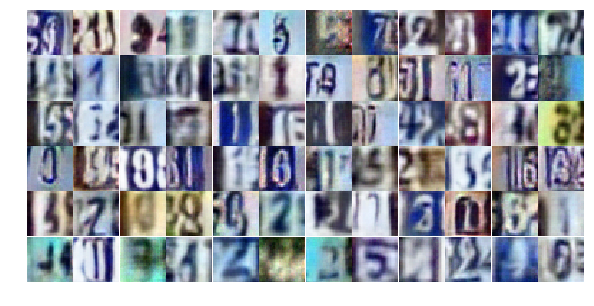

Epoch 15/25... Discriminator Loss: 0.7454... Generator Loss: 0.9413
Epoch 15/25... Discriminator Loss: 0.5987... Generator Loss: 1.9343
Epoch 15/25... Discriminator Loss: 1.1904... Generator Loss: 0.5301
Epoch 15/25... Discriminator Loss: 0.8226... Generator Loss: 0.8316
Epoch 15/25... Discriminator Loss: 0.9518... Generator Loss: 0.8803
Epoch 15/25... Discriminator Loss: 0.4826... Generator Loss: 1.5910
Epoch 15/25... Discriminator Loss: 1.0957... Generator Loss: 0.6212
Epoch 15/25... Discriminator Loss: 0.6818... Generator Loss: 2.1468
Epoch 15/25... Discriminator Loss: 0.9441... Generator Loss: 3.3804
Epoch 15/25... Discriminator Loss: 1.0644... Generator Loss: 0.6121


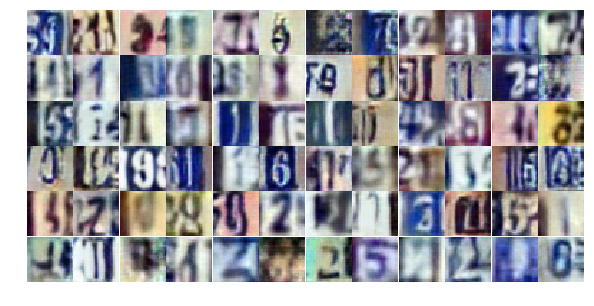

Epoch 15/25... Discriminator Loss: 0.8297... Generator Loss: 0.8432
Epoch 15/25... Discriminator Loss: 0.6640... Generator Loss: 1.1346
Epoch 15/25... Discriminator Loss: 0.5253... Generator Loss: 1.6756
Epoch 15/25... Discriminator Loss: 1.0402... Generator Loss: 0.6528
Epoch 15/25... Discriminator Loss: 0.9261... Generator Loss: 0.7475
Epoch 15/25... Discriminator Loss: 0.6288... Generator Loss: 1.2378
Epoch 15/25... Discriminator Loss: 1.5745... Generator Loss: 0.3147
Epoch 15/25... Discriminator Loss: 0.8129... Generator Loss: 0.9634
Epoch 15/25... Discriminator Loss: 0.7110... Generator Loss: 0.9245
Epoch 15/25... Discriminator Loss: 0.8833... Generator Loss: 0.8601


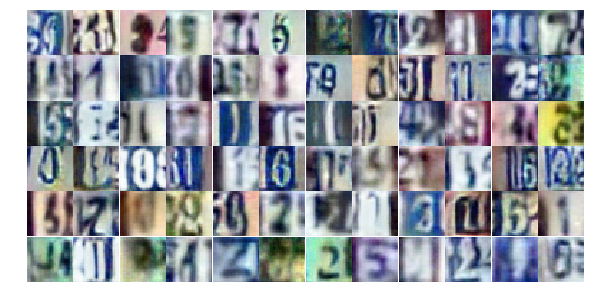

Epoch 15/25... Discriminator Loss: 0.6252... Generator Loss: 1.1131
Epoch 15/25... Discriminator Loss: 0.6596... Generator Loss: 1.0175
Epoch 15/25... Discriminator Loss: 0.4005... Generator Loss: 1.5523
Epoch 15/25... Discriminator Loss: 0.5498... Generator Loss: 1.4978
Epoch 15/25... Discriminator Loss: 0.5291... Generator Loss: 1.2639
Epoch 15/25... Discriminator Loss: 1.0655... Generator Loss: 2.3011
Epoch 15/25... Discriminator Loss: 0.4389... Generator Loss: 1.5589
Epoch 15/25... Discriminator Loss: 0.6129... Generator Loss: 1.1162
Epoch 15/25... Discriminator Loss: 0.5699... Generator Loss: 1.1873
Epoch 15/25... Discriminator Loss: 0.6919... Generator Loss: 0.9640


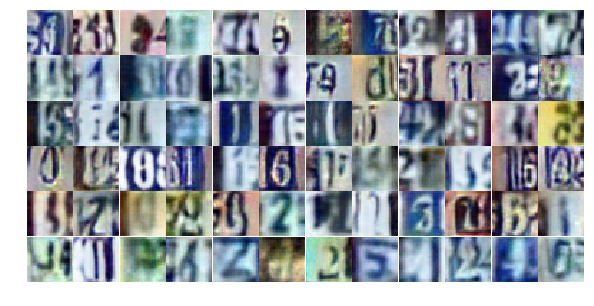

Epoch 15/25... Discriminator Loss: 0.5859... Generator Loss: 1.1822
Epoch 15/25... Discriminator Loss: 1.5104... Generator Loss: 0.3485
Epoch 15/25... Discriminator Loss: 0.6524... Generator Loss: 1.1130
Epoch 15/25... Discriminator Loss: 0.5865... Generator Loss: 1.3253
Epoch 15/25... Discriminator Loss: 0.5731... Generator Loss: 1.2076
Epoch 15/25... Discriminator Loss: 1.8652... Generator Loss: 0.2704
Epoch 15/25... Discriminator Loss: 0.5028... Generator Loss: 1.9567
Epoch 15/25... Discriminator Loss: 0.8450... Generator Loss: 1.0250
Epoch 15/25... Discriminator Loss: 0.7272... Generator Loss: 0.9546
Epoch 15/25... Discriminator Loss: 0.7176... Generator Loss: 1.0852


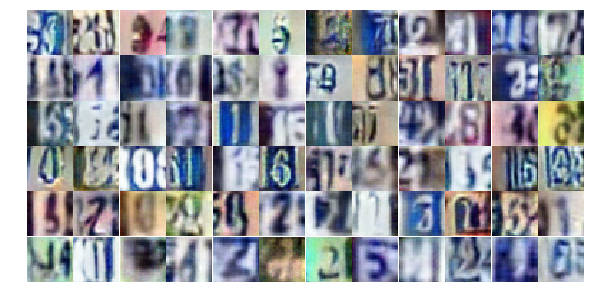

Epoch 15/25... Discriminator Loss: 1.6533... Generator Loss: 0.3326
Epoch 15/25... Discriminator Loss: 0.8760... Generator Loss: 0.8200
Epoch 15/25... Discriminator Loss: 0.4861... Generator Loss: 1.4283
Epoch 15/25... Discriminator Loss: 1.6237... Generator Loss: 0.3492
Epoch 15/25... Discriminator Loss: 1.8323... Generator Loss: 0.4425
Epoch 15/25... Discriminator Loss: 1.1988... Generator Loss: 0.6110
Epoch 15/25... Discriminator Loss: 0.9218... Generator Loss: 1.0552
Epoch 15/25... Discriminator Loss: 0.6246... Generator Loss: 1.3178
Epoch 15/25... Discriminator Loss: 1.5826... Generator Loss: 0.3519
Epoch 16/25... Discriminator Loss: 1.2389... Generator Loss: 0.5086


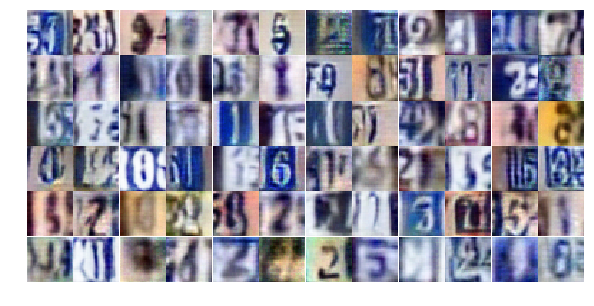

Epoch 16/25... Discriminator Loss: 0.7265... Generator Loss: 1.0324
Epoch 16/25... Discriminator Loss: 0.8065... Generator Loss: 0.9337
Epoch 16/25... Discriminator Loss: 0.9380... Generator Loss: 0.7184
Epoch 16/25... Discriminator Loss: 0.6724... Generator Loss: 1.4169
Epoch 16/25... Discriminator Loss: 0.6744... Generator Loss: 1.3205
Epoch 16/25... Discriminator Loss: 0.6738... Generator Loss: 1.1964
Epoch 16/25... Discriminator Loss: 1.9120... Generator Loss: 0.2127
Epoch 16/25... Discriminator Loss: 0.7882... Generator Loss: 0.8552
Epoch 16/25... Discriminator Loss: 0.4879... Generator Loss: 1.3276
Epoch 16/25... Discriminator Loss: 0.7683... Generator Loss: 0.8315


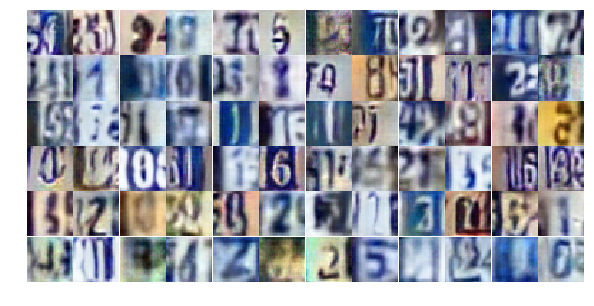

Epoch 16/25... Discriminator Loss: 1.2147... Generator Loss: 0.5512
Epoch 16/25... Discriminator Loss: 0.5804... Generator Loss: 1.3410
Epoch 16/25... Discriminator Loss: 0.8727... Generator Loss: 0.8059
Epoch 16/25... Discriminator Loss: 1.3677... Generator Loss: 0.4703
Epoch 16/25... Discriminator Loss: 0.5642... Generator Loss: 1.8408
Epoch 16/25... Discriminator Loss: 0.6704... Generator Loss: 1.1828
Epoch 16/25... Discriminator Loss: 1.9860... Generator Loss: 0.2506
Epoch 16/25... Discriminator Loss: 0.4869... Generator Loss: 1.3445
Epoch 16/25... Discriminator Loss: 0.5562... Generator Loss: 1.1576
Epoch 16/25... Discriminator Loss: 0.5920... Generator Loss: 1.1319


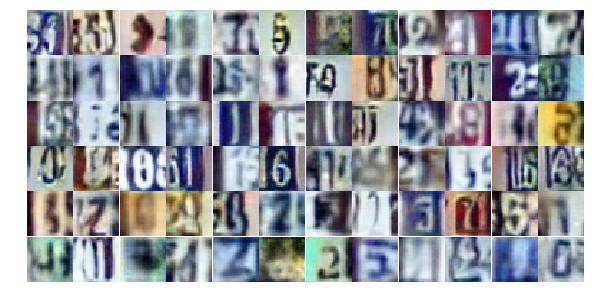

Epoch 16/25... Discriminator Loss: 0.7044... Generator Loss: 1.0810
Epoch 16/25... Discriminator Loss: 0.5898... Generator Loss: 1.5116
Epoch 16/25... Discriminator Loss: 0.6446... Generator Loss: 1.0467
Epoch 16/25... Discriminator Loss: 1.4723... Generator Loss: 0.3583
Epoch 16/25... Discriminator Loss: 0.6362... Generator Loss: 1.1627
Epoch 16/25... Discriminator Loss: 0.9216... Generator Loss: 0.7514
Epoch 16/25... Discriminator Loss: 0.5755... Generator Loss: 1.2122
Epoch 16/25... Discriminator Loss: 0.5905... Generator Loss: 1.8142
Epoch 16/25... Discriminator Loss: 1.0065... Generator Loss: 0.6712
Epoch 16/25... Discriminator Loss: 0.7377... Generator Loss: 1.0176


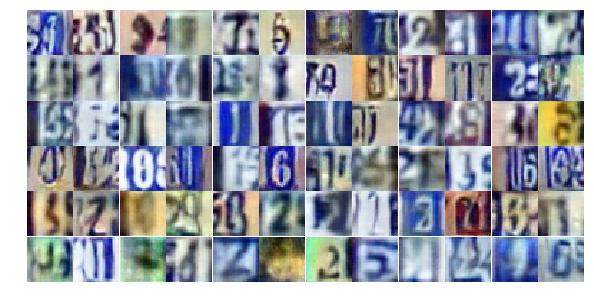

Epoch 16/25... Discriminator Loss: 0.6372... Generator Loss: 1.0896
Epoch 16/25... Discriminator Loss: 0.5502... Generator Loss: 1.2716
Epoch 16/25... Discriminator Loss: 0.7782... Generator Loss: 1.0617
Epoch 16/25... Discriminator Loss: 0.5871... Generator Loss: 1.3027
Epoch 16/25... Discriminator Loss: 1.2343... Generator Loss: 0.5264
Epoch 16/25... Discriminator Loss: 0.6359... Generator Loss: 1.2390
Epoch 16/25... Discriminator Loss: 0.8831... Generator Loss: 0.7085
Epoch 16/25... Discriminator Loss: 0.6505... Generator Loss: 1.0981
Epoch 16/25... Discriminator Loss: 0.7097... Generator Loss: 0.9201
Epoch 16/25... Discriminator Loss: 0.5846... Generator Loss: 1.1709


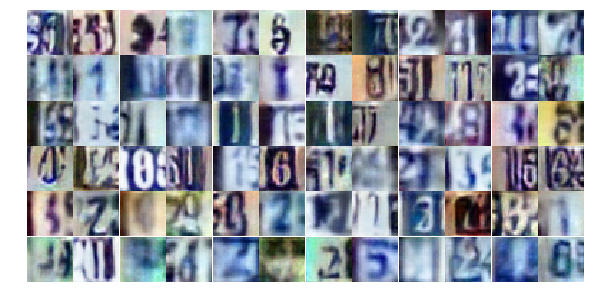

Epoch 16/25... Discriminator Loss: 0.6474... Generator Loss: 1.0705
Epoch 16/25... Discriminator Loss: 0.6164... Generator Loss: 2.3029
Epoch 16/25... Discriminator Loss: 1.4498... Generator Loss: 0.3742
Epoch 16/25... Discriminator Loss: 1.1491... Generator Loss: 0.5765
Epoch 16/25... Discriminator Loss: 0.9845... Generator Loss: 0.6314
Epoch 16/25... Discriminator Loss: 1.3182... Generator Loss: 0.4830
Epoch 16/25... Discriminator Loss: 0.4966... Generator Loss: 2.2501
Epoch 16/25... Discriminator Loss: 0.9379... Generator Loss: 0.6975
Epoch 16/25... Discriminator Loss: 0.6937... Generator Loss: 0.9393
Epoch 16/25... Discriminator Loss: 0.7857... Generator Loss: 0.9763


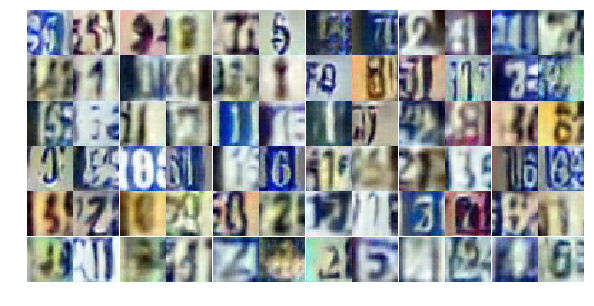

Epoch 16/25... Discriminator Loss: 1.0776... Generator Loss: 0.5681
Epoch 16/25... Discriminator Loss: 0.7012... Generator Loss: 1.0284
Epoch 16/25... Discriminator Loss: 1.3410... Generator Loss: 0.4476
Epoch 16/25... Discriminator Loss: 0.3504... Generator Loss: 1.8375
Epoch 16/25... Discriminator Loss: 0.6239... Generator Loss: 1.1265
Epoch 16/25... Discriminator Loss: 0.5395... Generator Loss: 1.3424
Epoch 17/25... Discriminator Loss: 0.6282... Generator Loss: 1.1114
Epoch 17/25... Discriminator Loss: 0.8568... Generator Loss: 0.8080
Epoch 17/25... Discriminator Loss: 1.0219... Generator Loss: 0.6361
Epoch 17/25... Discriminator Loss: 0.5878... Generator Loss: 1.5222


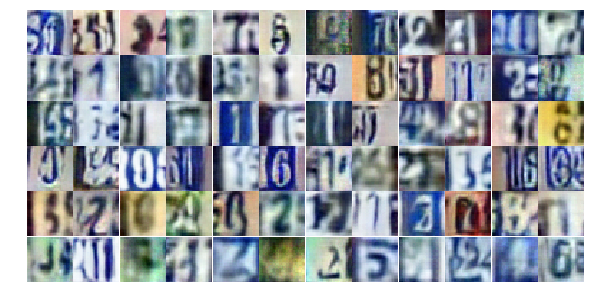

Epoch 17/25... Discriminator Loss: 0.3399... Generator Loss: 2.0753
Epoch 17/25... Discriminator Loss: 0.4914... Generator Loss: 1.4259
Epoch 17/25... Discriminator Loss: 1.3043... Generator Loss: 0.5150
Epoch 17/25... Discriminator Loss: 0.5687... Generator Loss: 1.4629
Epoch 17/25... Discriminator Loss: 0.8480... Generator Loss: 0.8486
Epoch 17/25... Discriminator Loss: 1.4389... Generator Loss: 0.4065
Epoch 17/25... Discriminator Loss: 0.5739... Generator Loss: 2.7099
Epoch 17/25... Discriminator Loss: 0.5760... Generator Loss: 1.1513
Epoch 17/25... Discriminator Loss: 0.5800... Generator Loss: 1.2783
Epoch 17/25... Discriminator Loss: 0.6870... Generator Loss: 1.9145


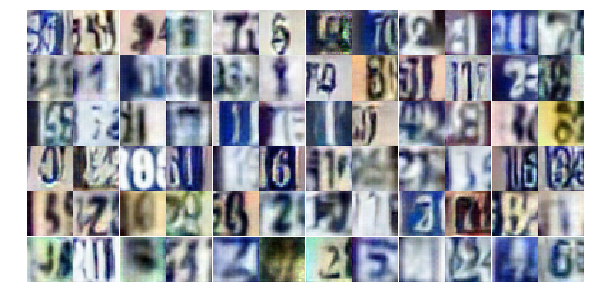

Epoch 17/25... Discriminator Loss: 0.8049... Generator Loss: 0.9827
Epoch 17/25... Discriminator Loss: 0.5684... Generator Loss: 1.5026
Epoch 17/25... Discriminator Loss: 0.5533... Generator Loss: 1.3381
Epoch 17/25... Discriminator Loss: 1.0883... Generator Loss: 0.8077
Epoch 17/25... Discriminator Loss: 0.4534... Generator Loss: 1.6456
Epoch 17/25... Discriminator Loss: 1.3264... Generator Loss: 0.4690
Epoch 17/25... Discriminator Loss: 0.6359... Generator Loss: 1.6749
Epoch 17/25... Discriminator Loss: 0.6461... Generator Loss: 1.0856
Epoch 17/25... Discriminator Loss: 0.8829... Generator Loss: 0.8369
Epoch 17/25... Discriminator Loss: 0.6471... Generator Loss: 1.0400


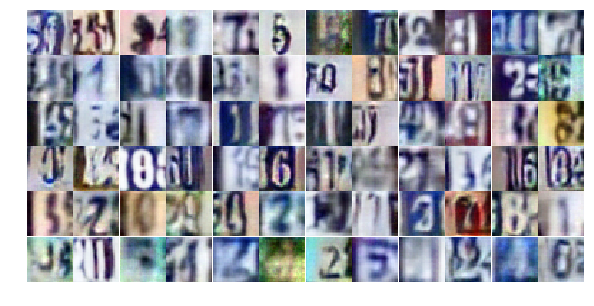

Epoch 17/25... Discriminator Loss: 1.2207... Generator Loss: 0.5306
Epoch 17/25... Discriminator Loss: 0.5388... Generator Loss: 1.5017
Epoch 17/25... Discriminator Loss: 0.5597... Generator Loss: 1.1634
Epoch 17/25... Discriminator Loss: 0.9746... Generator Loss: 0.7148
Epoch 17/25... Discriminator Loss: 1.4997... Generator Loss: 0.3915
Epoch 17/25... Discriminator Loss: 0.4441... Generator Loss: 1.4319
Epoch 17/25... Discriminator Loss: 0.9709... Generator Loss: 0.7663
Epoch 17/25... Discriminator Loss: 0.8203... Generator Loss: 0.8855
Epoch 17/25... Discriminator Loss: 1.0059... Generator Loss: 0.6336
Epoch 17/25... Discriminator Loss: 0.4063... Generator Loss: 1.7382


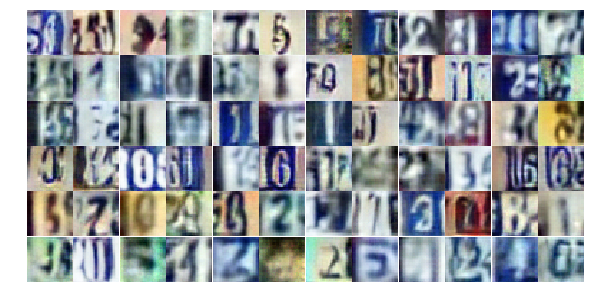

Epoch 17/25... Discriminator Loss: 0.7987... Generator Loss: 0.9821
Epoch 17/25... Discriminator Loss: 0.9711... Generator Loss: 0.8496
Epoch 17/25... Discriminator Loss: 0.5918... Generator Loss: 1.2529
Epoch 17/25... Discriminator Loss: 0.9245... Generator Loss: 0.8763
Epoch 17/25... Discriminator Loss: 0.9430... Generator Loss: 0.7335
Epoch 17/25... Discriminator Loss: 0.6400... Generator Loss: 1.4894
Epoch 17/25... Discriminator Loss: 1.4888... Generator Loss: 0.4181
Epoch 17/25... Discriminator Loss: 0.4389... Generator Loss: 2.0021
Epoch 17/25... Discriminator Loss: 0.3414... Generator Loss: 2.1079
Epoch 17/25... Discriminator Loss: 0.8578... Generator Loss: 0.8239


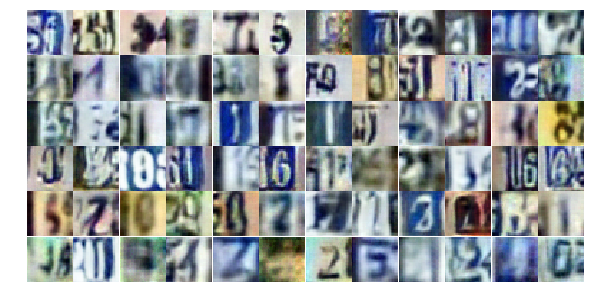

Epoch 17/25... Discriminator Loss: 0.8818... Generator Loss: 1.8171
Epoch 17/25... Discriminator Loss: 0.3948... Generator Loss: 1.9721
Epoch 17/25... Discriminator Loss: 0.8687... Generator Loss: 1.7035
Epoch 17/25... Discriminator Loss: 0.4502... Generator Loss: 1.3594
Epoch 17/25... Discriminator Loss: 0.4976... Generator Loss: 1.3119
Epoch 17/25... Discriminator Loss: 0.7333... Generator Loss: 1.2568
Epoch 17/25... Discriminator Loss: 1.2050... Generator Loss: 0.5194
Epoch 17/25... Discriminator Loss: 1.2477... Generator Loss: 0.4819
Epoch 17/25... Discriminator Loss: 1.2745... Generator Loss: 0.5944
Epoch 17/25... Discriminator Loss: 1.0205... Generator Loss: 1.5818


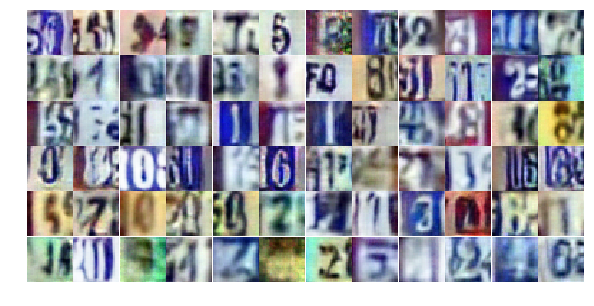

Epoch 17/25... Discriminator Loss: 0.7049... Generator Loss: 1.0386
Epoch 17/25... Discriminator Loss: 0.7359... Generator Loss: 1.4754
Epoch 17/25... Discriminator Loss: 1.7563... Generator Loss: 0.3203
Epoch 17/25... Discriminator Loss: 1.1536... Generator Loss: 0.8376
Epoch 18/25... Discriminator Loss: 0.8863... Generator Loss: 1.0306
Epoch 18/25... Discriminator Loss: 1.4338... Generator Loss: 0.3731
Epoch 18/25... Discriminator Loss: 1.0528... Generator Loss: 0.6268
Epoch 18/25... Discriminator Loss: 0.7621... Generator Loss: 0.8695
Epoch 18/25... Discriminator Loss: 1.4425... Generator Loss: 0.3764
Epoch 18/25... Discriminator Loss: 0.8328... Generator Loss: 0.9414


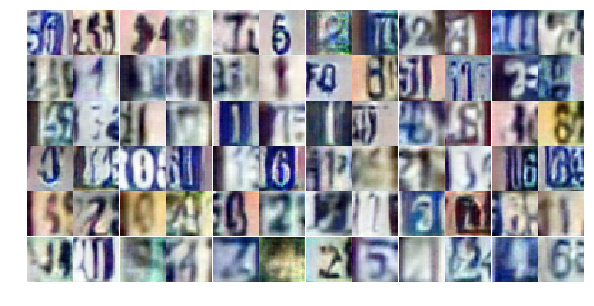

Epoch 18/25... Discriminator Loss: 0.4995... Generator Loss: 1.5745
Epoch 18/25... Discriminator Loss: 1.0142... Generator Loss: 0.6634
Epoch 18/25... Discriminator Loss: 0.9411... Generator Loss: 0.6796
Epoch 18/25... Discriminator Loss: 0.4283... Generator Loss: 1.8688
Epoch 18/25... Discriminator Loss: 0.6684... Generator Loss: 0.9826
Epoch 18/25... Discriminator Loss: 1.1586... Generator Loss: 0.5627
Epoch 18/25... Discriminator Loss: 0.5288... Generator Loss: 1.1947
Epoch 18/25... Discriminator Loss: 0.7335... Generator Loss: 0.9996
Epoch 18/25... Discriminator Loss: 1.3529... Generator Loss: 3.6788
Epoch 18/25... Discriminator Loss: 1.0586... Generator Loss: 1.1241


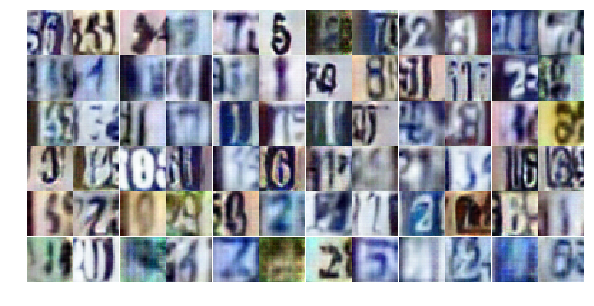

Epoch 18/25... Discriminator Loss: 0.8159... Generator Loss: 1.0052
Epoch 18/25... Discriminator Loss: 0.8057... Generator Loss: 0.9219
Epoch 18/25... Discriminator Loss: 1.1037... Generator Loss: 0.6129
Epoch 18/25... Discriminator Loss: 0.7228... Generator Loss: 1.0373
Epoch 18/25... Discriminator Loss: 0.8342... Generator Loss: 0.8569
Epoch 18/25... Discriminator Loss: 1.0774... Generator Loss: 0.6297
Epoch 18/25... Discriminator Loss: 0.9566... Generator Loss: 0.7167
Epoch 18/25... Discriminator Loss: 0.9477... Generator Loss: 0.7783
Epoch 18/25... Discriminator Loss: 0.7004... Generator Loss: 1.0089
Epoch 18/25... Discriminator Loss: 0.6034... Generator Loss: 1.1542


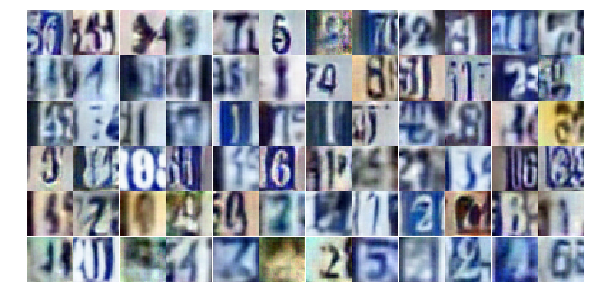

Epoch 18/25... Discriminator Loss: 0.6260... Generator Loss: 1.0770
Epoch 18/25... Discriminator Loss: 0.7588... Generator Loss: 0.9807
Epoch 18/25... Discriminator Loss: 0.9676... Generator Loss: 0.7178
Epoch 18/25... Discriminator Loss: 0.6752... Generator Loss: 1.0954
Epoch 18/25... Discriminator Loss: 1.0393... Generator Loss: 0.6115
Epoch 18/25... Discriminator Loss: 0.6968... Generator Loss: 0.9458
Epoch 18/25... Discriminator Loss: 0.8395... Generator Loss: 0.8235
Epoch 18/25... Discriminator Loss: 0.4929... Generator Loss: 1.4809
Epoch 18/25... Discriminator Loss: 0.5407... Generator Loss: 1.3077
Epoch 18/25... Discriminator Loss: 0.6468... Generator Loss: 1.1293


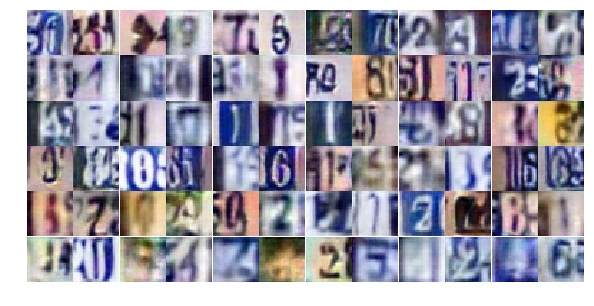

Epoch 18/25... Discriminator Loss: 0.5552... Generator Loss: 1.3167
Epoch 18/25... Discriminator Loss: 0.7354... Generator Loss: 1.0104
Epoch 18/25... Discriminator Loss: 0.7068... Generator Loss: 0.9384
Epoch 18/25... Discriminator Loss: 0.5912... Generator Loss: 1.7106
Epoch 18/25... Discriminator Loss: 1.0713... Generator Loss: 0.5943
Epoch 18/25... Discriminator Loss: 0.4813... Generator Loss: 1.3630
Epoch 18/25... Discriminator Loss: 0.7411... Generator Loss: 0.9432
Epoch 18/25... Discriminator Loss: 1.5365... Generator Loss: 3.5197
Epoch 18/25... Discriminator Loss: 1.7197... Generator Loss: 0.3909
Epoch 18/25... Discriminator Loss: 0.3940... Generator Loss: 1.7245


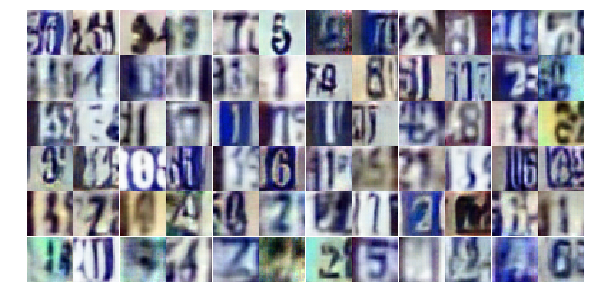

Epoch 18/25... Discriminator Loss: 0.7612... Generator Loss: 0.9366
Epoch 18/25... Discriminator Loss: 0.8886... Generator Loss: 0.7480
Epoch 18/25... Discriminator Loss: 0.8937... Generator Loss: 0.8205
Epoch 18/25... Discriminator Loss: 0.8576... Generator Loss: 0.8084
Epoch 18/25... Discriminator Loss: 0.5918... Generator Loss: 1.2478
Epoch 18/25... Discriminator Loss: 1.3554... Generator Loss: 4.0201
Epoch 18/25... Discriminator Loss: 0.5663... Generator Loss: 1.2618
Epoch 18/25... Discriminator Loss: 0.5138... Generator Loss: 1.3189
Epoch 18/25... Discriminator Loss: 1.0651... Generator Loss: 0.6390
Epoch 18/25... Discriminator Loss: 0.9151... Generator Loss: 0.7210


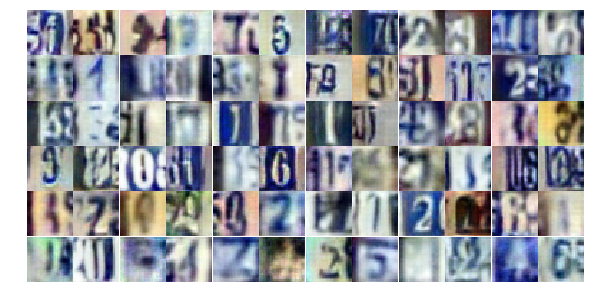

Epoch 18/25... Discriminator Loss: 0.6708... Generator Loss: 1.8522
Epoch 19/25... Discriminator Loss: 1.3517... Generator Loss: 0.4158
Epoch 19/25... Discriminator Loss: 1.1722... Generator Loss: 0.5702
Epoch 19/25... Discriminator Loss: 0.8462... Generator Loss: 0.9211
Epoch 19/25... Discriminator Loss: 0.8603... Generator Loss: 0.7835
Epoch 19/25... Discriminator Loss: 0.8608... Generator Loss: 0.8763
Epoch 19/25... Discriminator Loss: 0.4233... Generator Loss: 1.6500
Epoch 19/25... Discriminator Loss: 0.8287... Generator Loss: 0.9277
Epoch 19/25... Discriminator Loss: 0.5059... Generator Loss: 1.9200
Epoch 19/25... Discriminator Loss: 0.8555... Generator Loss: 0.8636


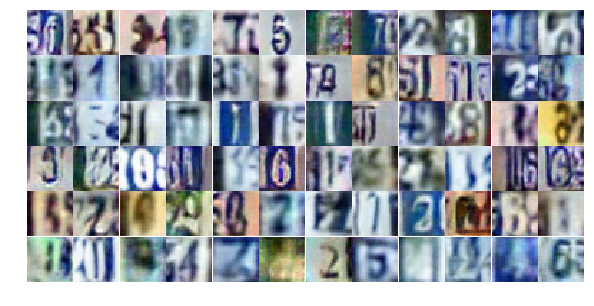

Epoch 19/25... Discriminator Loss: 0.4606... Generator Loss: 1.4032
Epoch 19/25... Discriminator Loss: 1.1931... Generator Loss: 0.4843
Epoch 19/25... Discriminator Loss: 1.0374... Generator Loss: 0.6651
Epoch 19/25... Discriminator Loss: 1.2134... Generator Loss: 0.5066
Epoch 19/25... Discriminator Loss: 1.3071... Generator Loss: 0.4404
Epoch 19/25... Discriminator Loss: 0.8490... Generator Loss: 0.7992
Epoch 19/25... Discriminator Loss: 1.1537... Generator Loss: 0.5874
Epoch 19/25... Discriminator Loss: 0.7534... Generator Loss: 0.9081
Epoch 19/25... Discriminator Loss: 0.7610... Generator Loss: 1.1738
Epoch 19/25... Discriminator Loss: 1.6505... Generator Loss: 0.3868


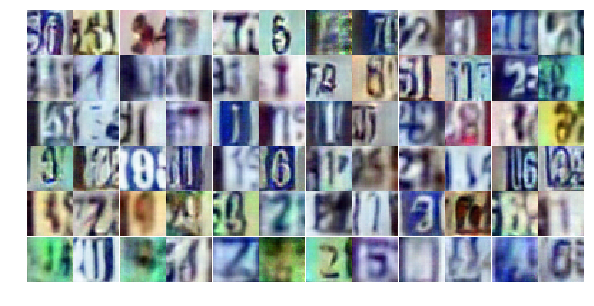

Epoch 19/25... Discriminator Loss: 0.6820... Generator Loss: 1.0140
Epoch 19/25... Discriminator Loss: 1.4003... Generator Loss: 0.4165
Epoch 19/25... Discriminator Loss: 1.3693... Generator Loss: 0.4115
Epoch 19/25... Discriminator Loss: 0.9171... Generator Loss: 0.8734
Epoch 19/25... Discriminator Loss: 1.0482... Generator Loss: 0.5761
Epoch 19/25... Discriminator Loss: 0.6889... Generator Loss: 1.3701
Epoch 19/25... Discriminator Loss: 0.8144... Generator Loss: 0.9131
Epoch 19/25... Discriminator Loss: 0.4801... Generator Loss: 1.7056
Epoch 19/25... Discriminator Loss: 0.6084... Generator Loss: 1.1658
Epoch 19/25... Discriminator Loss: 1.5160... Generator Loss: 0.4157


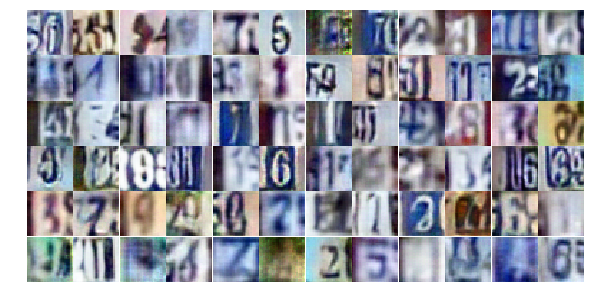

Epoch 19/25... Discriminator Loss: 0.6507... Generator Loss: 1.3442
Epoch 19/25... Discriminator Loss: 0.8803... Generator Loss: 0.7303
Epoch 19/25... Discriminator Loss: 0.9269... Generator Loss: 0.7727
Epoch 19/25... Discriminator Loss: 0.6879... Generator Loss: 0.9994
Epoch 19/25... Discriminator Loss: 0.5896... Generator Loss: 1.2688
Epoch 19/25... Discriminator Loss: 1.1081... Generator Loss: 0.5895
Epoch 19/25... Discriminator Loss: 0.9430... Generator Loss: 0.6700
Epoch 19/25... Discriminator Loss: 0.4978... Generator Loss: 1.4938
Epoch 19/25... Discriminator Loss: 1.0196... Generator Loss: 0.6926
Epoch 19/25... Discriminator Loss: 0.8721... Generator Loss: 0.7932


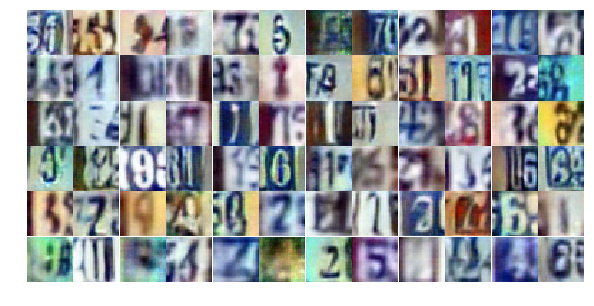

Epoch 19/25... Discriminator Loss: 0.5725... Generator Loss: 1.0828
Epoch 19/25... Discriminator Loss: 1.1277... Generator Loss: 0.5519
Epoch 19/25... Discriminator Loss: 1.5546... Generator Loss: 0.3307
Epoch 19/25... Discriminator Loss: 0.5455... Generator Loss: 1.1963
Epoch 19/25... Discriminator Loss: 0.6699... Generator Loss: 1.7370
Epoch 19/25... Discriminator Loss: 1.1299... Generator Loss: 4.0141
Epoch 19/25... Discriminator Loss: 0.7213... Generator Loss: 1.8491
Epoch 19/25... Discriminator Loss: 0.6622... Generator Loss: 1.1130
Epoch 19/25... Discriminator Loss: 0.6611... Generator Loss: 1.0603
Epoch 19/25... Discriminator Loss: 0.7584... Generator Loss: 0.9593


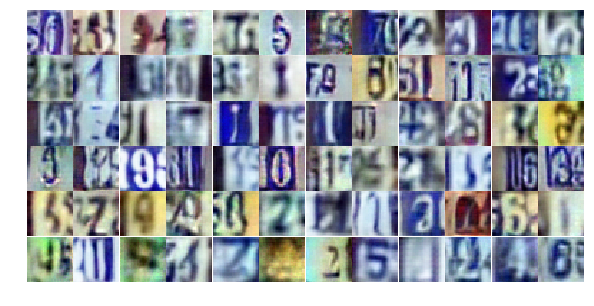

Epoch 19/25... Discriminator Loss: 0.9527... Generator Loss: 0.6590
Epoch 19/25... Discriminator Loss: 0.8011... Generator Loss: 0.8228
Epoch 19/25... Discriminator Loss: 0.8111... Generator Loss: 1.0749
Epoch 19/25... Discriminator Loss: 1.6642... Generator Loss: 0.2937
Epoch 19/25... Discriminator Loss: 0.7531... Generator Loss: 1.1091
Epoch 19/25... Discriminator Loss: 0.8606... Generator Loss: 0.9544
Epoch 19/25... Discriminator Loss: 1.3315... Generator Loss: 0.4376
Epoch 19/25... Discriminator Loss: 0.6927... Generator Loss: 1.0012
Epoch 20/25... Discriminator Loss: 1.1970... Generator Loss: 0.5097
Epoch 20/25... Discriminator Loss: 0.6279... Generator Loss: 1.8657


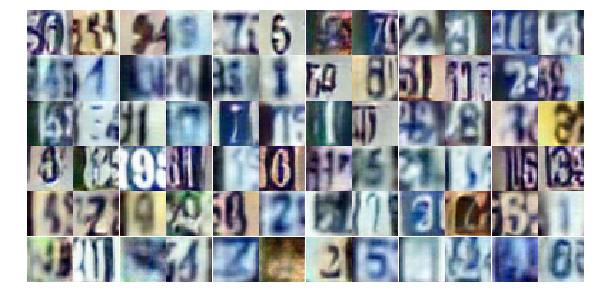

Epoch 20/25... Discriminator Loss: 0.9770... Generator Loss: 0.6697
Epoch 20/25... Discriminator Loss: 0.9978... Generator Loss: 0.6766
Epoch 20/25... Discriminator Loss: 1.7015... Generator Loss: 0.3219
Epoch 20/25... Discriminator Loss: 1.0811... Generator Loss: 0.6112
Epoch 20/25... Discriminator Loss: 0.7200... Generator Loss: 1.1005
Epoch 20/25... Discriminator Loss: 0.8753... Generator Loss: 0.9743
Epoch 20/25... Discriminator Loss: 0.9071... Generator Loss: 0.7967
Epoch 20/25... Discriminator Loss: 0.7415... Generator Loss: 0.9380
Epoch 20/25... Discriminator Loss: 0.8480... Generator Loss: 0.9403
Epoch 20/25... Discriminator Loss: 0.9409... Generator Loss: 0.6688


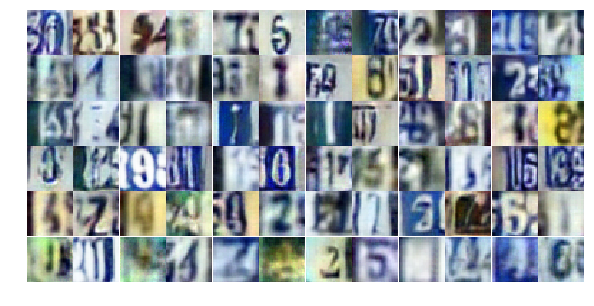

Epoch 20/25... Discriminator Loss: 1.2066... Generator Loss: 0.5773
Epoch 20/25... Discriminator Loss: 0.8902... Generator Loss: 0.8149
Epoch 20/25... Discriminator Loss: 0.6798... Generator Loss: 1.1614
Epoch 20/25... Discriminator Loss: 0.6872... Generator Loss: 1.1028
Epoch 20/25... Discriminator Loss: 1.1081... Generator Loss: 0.5853
Epoch 20/25... Discriminator Loss: 0.7339... Generator Loss: 1.1566
Epoch 20/25... Discriminator Loss: 1.4866... Generator Loss: 0.4224
Epoch 20/25... Discriminator Loss: 0.9974... Generator Loss: 0.7284
Epoch 20/25... Discriminator Loss: 0.7196... Generator Loss: 0.9427
Epoch 20/25... Discriminator Loss: 1.2029... Generator Loss: 0.5455


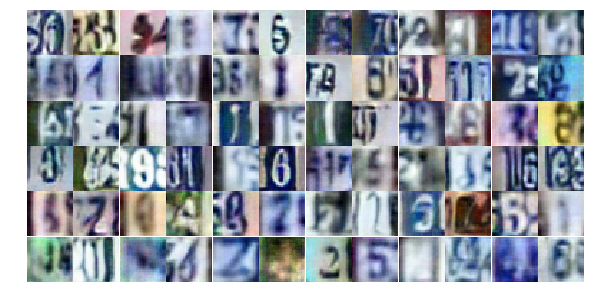

Epoch 20/25... Discriminator Loss: 0.6795... Generator Loss: 1.0108
Epoch 20/25... Discriminator Loss: 0.7270... Generator Loss: 1.0324
Epoch 20/25... Discriminator Loss: 0.2468... Generator Loss: 2.1483
Epoch 20/25... Discriminator Loss: 1.6087... Generator Loss: 0.4018
Epoch 20/25... Discriminator Loss: 0.8885... Generator Loss: 0.8342
Epoch 20/25... Discriminator Loss: 0.5836... Generator Loss: 1.4558
Epoch 20/25... Discriminator Loss: 0.6177... Generator Loss: 1.9259
Epoch 20/25... Discriminator Loss: 1.4984... Generator Loss: 0.4157
Epoch 20/25... Discriminator Loss: 1.2175... Generator Loss: 0.4883
Epoch 20/25... Discriminator Loss: 0.5049... Generator Loss: 1.4220


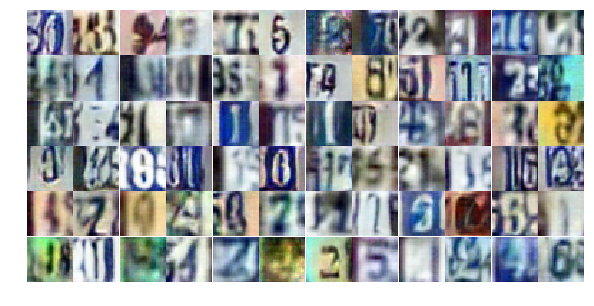

Epoch 20/25... Discriminator Loss: 0.8154... Generator Loss: 0.9530
Epoch 20/25... Discriminator Loss: 0.5895... Generator Loss: 1.1076
Epoch 20/25... Discriminator Loss: 1.0919... Generator Loss: 0.5772
Epoch 20/25... Discriminator Loss: 0.8276... Generator Loss: 0.8823
Epoch 20/25... Discriminator Loss: 0.7788... Generator Loss: 1.0487
Epoch 20/25... Discriminator Loss: 1.2064... Generator Loss: 0.5068
Epoch 20/25... Discriminator Loss: 1.0354... Generator Loss: 0.7323
Epoch 20/25... Discriminator Loss: 0.7977... Generator Loss: 0.9027
Epoch 20/25... Discriminator Loss: 0.8709... Generator Loss: 0.7783
Epoch 20/25... Discriminator Loss: 0.8642... Generator Loss: 0.9243


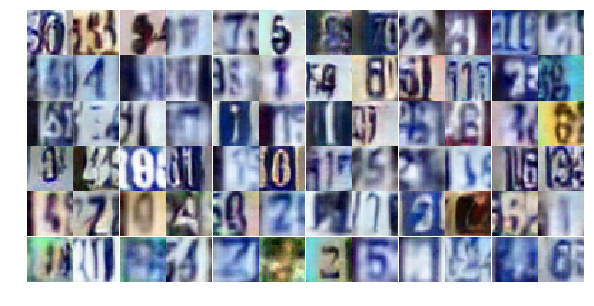

Epoch 20/25... Discriminator Loss: 0.4765... Generator Loss: 1.4635
Epoch 20/25... Discriminator Loss: 1.0676... Generator Loss: 0.5615
Epoch 20/25... Discriminator Loss: 1.0155... Generator Loss: 3.0306
Epoch 20/25... Discriminator Loss: 0.9296... Generator Loss: 0.7293
Epoch 20/25... Discriminator Loss: 0.6116... Generator Loss: 1.2995
Epoch 20/25... Discriminator Loss: 0.8445... Generator Loss: 0.8004
Epoch 20/25... Discriminator Loss: 1.2552... Generator Loss: 0.5040
Epoch 20/25... Discriminator Loss: 0.5026... Generator Loss: 1.8045
Epoch 20/25... Discriminator Loss: 0.5378... Generator Loss: 1.4944
Epoch 20/25... Discriminator Loss: 0.9986... Generator Loss: 0.7633


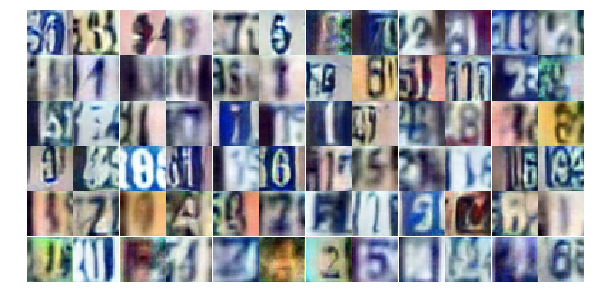

Epoch 20/25... Discriminator Loss: 0.3978... Generator Loss: 1.8191
Epoch 20/25... Discriminator Loss: 0.6006... Generator Loss: 1.2539
Epoch 20/25... Discriminator Loss: 0.3717... Generator Loss: 2.0412
Epoch 20/25... Discriminator Loss: 0.6388... Generator Loss: 1.2448
Epoch 20/25... Discriminator Loss: 0.6475... Generator Loss: 1.0047
Epoch 20/25... Discriminator Loss: 0.4587... Generator Loss: 1.4641
Epoch 21/25... Discriminator Loss: 0.7778... Generator Loss: 0.9925
Epoch 21/25... Discriminator Loss: 0.7243... Generator Loss: 0.9200
Epoch 21/25... Discriminator Loss: 1.3580... Generator Loss: 0.4268
Epoch 21/25... Discriminator Loss: 0.8246... Generator Loss: 0.8118


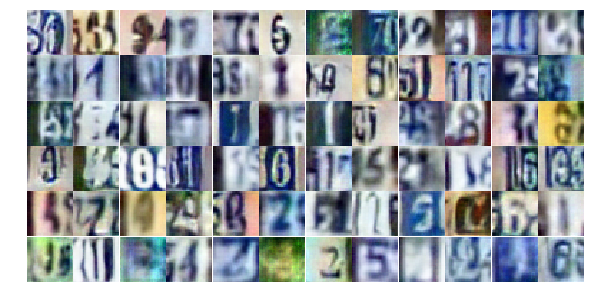

Epoch 21/25... Discriminator Loss: 0.6977... Generator Loss: 1.3650
Epoch 21/25... Discriminator Loss: 1.9535... Generator Loss: 0.2176
Epoch 21/25... Discriminator Loss: 0.4806... Generator Loss: 1.6451
Epoch 21/25... Discriminator Loss: 0.4286... Generator Loss: 1.4689
Epoch 21/25... Discriminator Loss: 0.8413... Generator Loss: 0.7926
Epoch 21/25... Discriminator Loss: 0.4663... Generator Loss: 1.5675
Epoch 21/25... Discriminator Loss: 0.5359... Generator Loss: 1.4149
Epoch 21/25... Discriminator Loss: 0.8303... Generator Loss: 1.2523
Epoch 21/25... Discriminator Loss: 0.8671... Generator Loss: 0.8237
Epoch 21/25... Discriminator Loss: 1.0012... Generator Loss: 0.6245


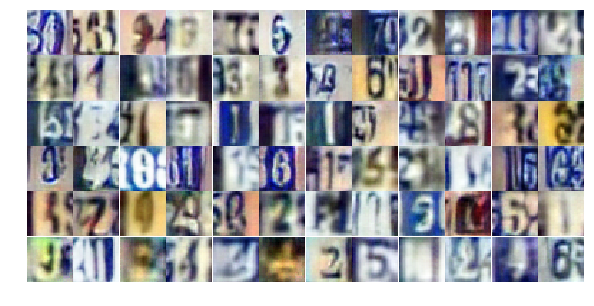

Epoch 21/25... Discriminator Loss: 0.3912... Generator Loss: 1.5879
Epoch 21/25... Discriminator Loss: 0.9465... Generator Loss: 0.6901
Epoch 21/25... Discriminator Loss: 1.7117... Generator Loss: 0.3161
Epoch 21/25... Discriminator Loss: 1.7809... Generator Loss: 0.3862
Epoch 21/25... Discriminator Loss: 0.5389... Generator Loss: 2.2829
Epoch 21/25... Discriminator Loss: 1.0696... Generator Loss: 0.6508
Epoch 21/25... Discriminator Loss: 0.8070... Generator Loss: 0.9116
Epoch 21/25... Discriminator Loss: 0.4239... Generator Loss: 1.7190
Epoch 21/25... Discriminator Loss: 0.4443... Generator Loss: 1.5789
Epoch 21/25... Discriminator Loss: 0.5872... Generator Loss: 1.5991


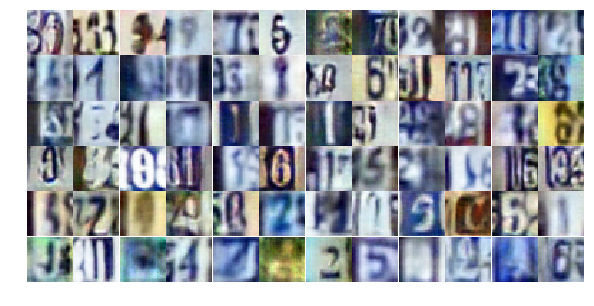

Epoch 21/25... Discriminator Loss: 1.5563... Generator Loss: 0.3677
Epoch 21/25... Discriminator Loss: 0.5220... Generator Loss: 1.3910
Epoch 21/25... Discriminator Loss: 1.3053... Generator Loss: 0.5236
Epoch 21/25... Discriminator Loss: 0.7983... Generator Loss: 0.8934
Epoch 21/25... Discriminator Loss: 0.9403... Generator Loss: 0.7038
Epoch 21/25... Discriminator Loss: 1.4046... Generator Loss: 0.4230
Epoch 21/25... Discriminator Loss: 0.5558... Generator Loss: 1.2239
Epoch 21/25... Discriminator Loss: 1.0403... Generator Loss: 0.6226
Epoch 21/25... Discriminator Loss: 1.2948... Generator Loss: 0.4977
Epoch 21/25... Discriminator Loss: 1.3850... Generator Loss: 0.4127


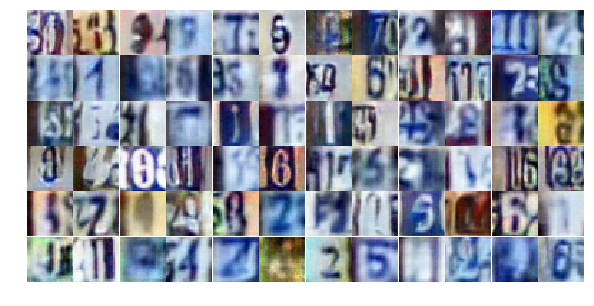

Epoch 21/25... Discriminator Loss: 1.2249... Generator Loss: 0.5410
Epoch 21/25... Discriminator Loss: 0.6842... Generator Loss: 1.0255
Epoch 21/25... Discriminator Loss: 0.9379... Generator Loss: 0.7276
Epoch 21/25... Discriminator Loss: 0.5683... Generator Loss: 1.1859
Epoch 21/25... Discriminator Loss: 0.4713... Generator Loss: 1.3335
Epoch 21/25... Discriminator Loss: 0.5769... Generator Loss: 1.1497
Epoch 21/25... Discriminator Loss: 0.7937... Generator Loss: 0.9167
Epoch 21/25... Discriminator Loss: 1.8452... Generator Loss: 0.2552
Epoch 21/25... Discriminator Loss: 0.8151... Generator Loss: 0.8224
Epoch 21/25... Discriminator Loss: 0.5067... Generator Loss: 1.3376


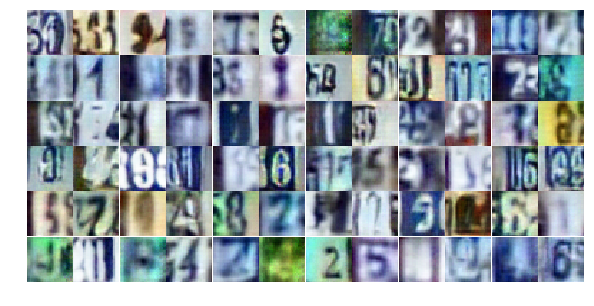

Epoch 21/25... Discriminator Loss: 2.2770... Generator Loss: 4.1108
Epoch 21/25... Discriminator Loss: 1.3264... Generator Loss: 0.5783
Epoch 21/25... Discriminator Loss: 0.8499... Generator Loss: 1.2258
Epoch 21/25... Discriminator Loss: 0.9724... Generator Loss: 0.7754
Epoch 21/25... Discriminator Loss: 0.4401... Generator Loss: 1.6220
Epoch 21/25... Discriminator Loss: 0.5917... Generator Loss: 1.2747
Epoch 21/25... Discriminator Loss: 1.2031... Generator Loss: 0.5291
Epoch 21/25... Discriminator Loss: 1.1983... Generator Loss: 0.5419
Epoch 21/25... Discriminator Loss: 0.9969... Generator Loss: 0.6480
Epoch 21/25... Discriminator Loss: 0.5732... Generator Loss: 1.3011


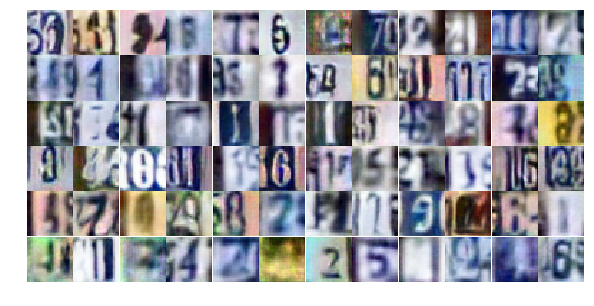

Epoch 21/25... Discriminator Loss: 0.5989... Generator Loss: 1.2718
Epoch 21/25... Discriminator Loss: 1.1986... Generator Loss: 0.5055
Epoch 21/25... Discriminator Loss: 0.6628... Generator Loss: 1.1105
Epoch 22/25... Discriminator Loss: 0.6944... Generator Loss: 1.6577
Epoch 22/25... Discriminator Loss: 0.9002... Generator Loss: 0.7318
Epoch 22/25... Discriminator Loss: 0.7564... Generator Loss: 1.0065
Epoch 22/25... Discriminator Loss: 0.7459... Generator Loss: 0.9099
Epoch 22/25... Discriminator Loss: 0.5703... Generator Loss: 1.1134
Epoch 22/25... Discriminator Loss: 1.5623... Generator Loss: 0.3794
Epoch 22/25... Discriminator Loss: 0.8364... Generator Loss: 0.9366


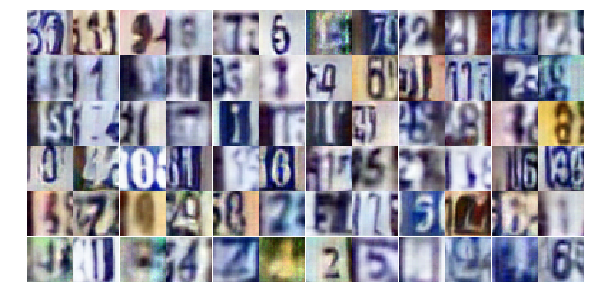

Epoch 22/25... Discriminator Loss: 0.4418... Generator Loss: 2.1220
Epoch 22/25... Discriminator Loss: 0.8358... Generator Loss: 0.8247
Epoch 22/25... Discriminator Loss: 1.7081... Generator Loss: 0.2969
Epoch 22/25... Discriminator Loss: 0.8648... Generator Loss: 0.8657
Epoch 22/25... Discriminator Loss: 0.8591... Generator Loss: 0.8527
Epoch 22/25... Discriminator Loss: 0.4839... Generator Loss: 1.4359
Epoch 22/25... Discriminator Loss: 0.7473... Generator Loss: 0.9038
Epoch 22/25... Discriminator Loss: 0.4825... Generator Loss: 1.4266
Epoch 22/25... Discriminator Loss: 0.8538... Generator Loss: 0.8721
Epoch 22/25... Discriminator Loss: 1.4585... Generator Loss: 0.4431


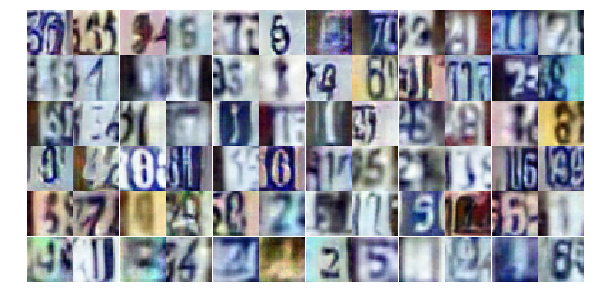

Epoch 22/25... Discriminator Loss: 0.6315... Generator Loss: 1.3637
Epoch 22/25... Discriminator Loss: 1.7302... Generator Loss: 2.4743
Epoch 22/25... Discriminator Loss: 1.2871... Generator Loss: 0.5994
Epoch 22/25... Discriminator Loss: 0.7612... Generator Loss: 0.9532
Epoch 22/25... Discriminator Loss: 0.6394... Generator Loss: 1.3254
Epoch 22/25... Discriminator Loss: 1.1174... Generator Loss: 0.6180
Epoch 22/25... Discriminator Loss: 0.5950... Generator Loss: 1.6915
Epoch 22/25... Discriminator Loss: 0.4140... Generator Loss: 1.7941
Epoch 22/25... Discriminator Loss: 0.5538... Generator Loss: 1.2387
Epoch 22/25... Discriminator Loss: 0.6711... Generator Loss: 1.0769


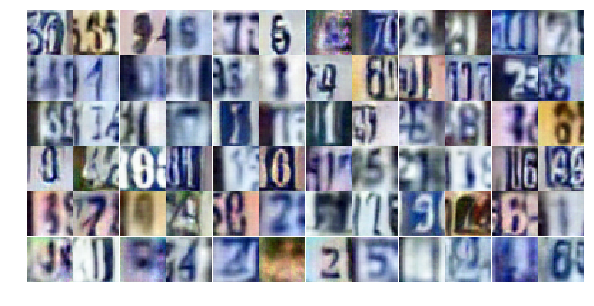

Epoch 22/25... Discriminator Loss: 0.5832... Generator Loss: 1.1875
Epoch 22/25... Discriminator Loss: 0.6732... Generator Loss: 1.0365
Epoch 22/25... Discriminator Loss: 0.8968... Generator Loss: 0.8102
Epoch 22/25... Discriminator Loss: 0.7699... Generator Loss: 0.9430
Epoch 22/25... Discriminator Loss: 1.0124... Generator Loss: 0.6674
Epoch 22/25... Discriminator Loss: 0.7904... Generator Loss: 0.8974
Epoch 22/25... Discriminator Loss: 1.3997... Generator Loss: 0.3810
Epoch 22/25... Discriminator Loss: 0.7335... Generator Loss: 0.9107
Epoch 22/25... Discriminator Loss: 0.8253... Generator Loss: 0.8801
Epoch 22/25... Discriminator Loss: 0.9091... Generator Loss: 0.7201


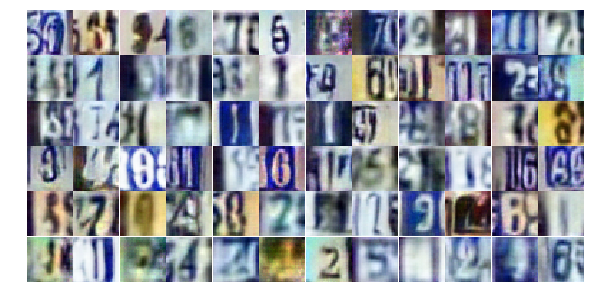

Epoch 22/25... Discriminator Loss: 1.0598... Generator Loss: 0.6602
Epoch 22/25... Discriminator Loss: 0.6519... Generator Loss: 1.1041
Epoch 22/25... Discriminator Loss: 0.4519... Generator Loss: 1.4100
Epoch 22/25... Discriminator Loss: 0.9061... Generator Loss: 0.7952
Epoch 22/25... Discriminator Loss: 0.5176... Generator Loss: 1.1980
Epoch 22/25... Discriminator Loss: 0.6681... Generator Loss: 1.0058
Epoch 22/25... Discriminator Loss: 0.6239... Generator Loss: 1.1589
Epoch 22/25... Discriminator Loss: 0.6006... Generator Loss: 1.3152
Epoch 22/25... Discriminator Loss: 0.7357... Generator Loss: 1.4466
Epoch 22/25... Discriminator Loss: 0.8298... Generator Loss: 0.9099


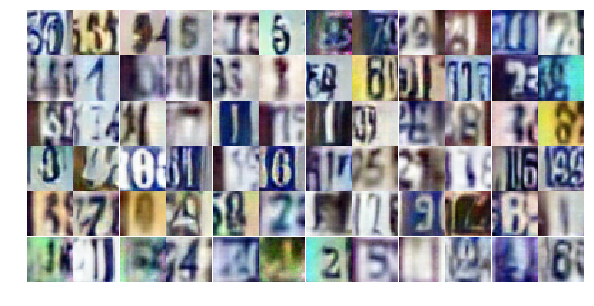

Epoch 22/25... Discriminator Loss: 1.5410... Generator Loss: 0.3808
Epoch 22/25... Discriminator Loss: 0.5674... Generator Loss: 1.5181
Epoch 22/25... Discriminator Loss: 0.7600... Generator Loss: 0.9588
Epoch 22/25... Discriminator Loss: 0.8952... Generator Loss: 0.7746
Epoch 22/25... Discriminator Loss: 0.9126... Generator Loss: 0.8276
Epoch 22/25... Discriminator Loss: 1.0525... Generator Loss: 0.6586
Epoch 22/25... Discriminator Loss: 0.8495... Generator Loss: 0.7822
Epoch 22/25... Discriminator Loss: 0.7550... Generator Loss: 0.8978
Epoch 22/25... Discriminator Loss: 0.7896... Generator Loss: 1.9339
Epoch 22/25... Discriminator Loss: 1.0313... Generator Loss: 0.6666


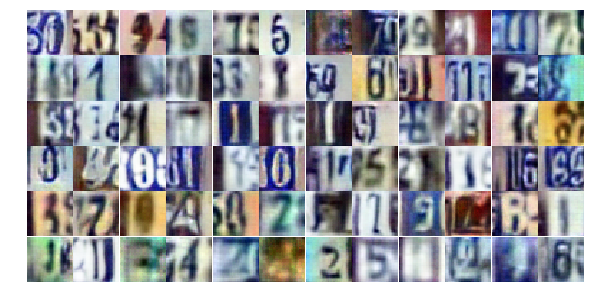

Epoch 23/25... Discriminator Loss: 0.3741... Generator Loss: 1.9153
Epoch 23/25... Discriminator Loss: 0.6690... Generator Loss: 1.0800
Epoch 23/25... Discriminator Loss: 1.4391... Generator Loss: 0.4079
Epoch 23/25... Discriminator Loss: 0.8632... Generator Loss: 0.8382
Epoch 23/25... Discriminator Loss: 0.6763... Generator Loss: 1.2139
Epoch 23/25... Discriminator Loss: 1.3559... Generator Loss: 0.4842
Epoch 23/25... Discriminator Loss: 1.0081... Generator Loss: 0.6232
Epoch 23/25... Discriminator Loss: 0.7379... Generator Loss: 1.0641
Epoch 23/25... Discriminator Loss: 0.5167... Generator Loss: 1.3797
Epoch 23/25... Discriminator Loss: 0.3978... Generator Loss: 1.6026


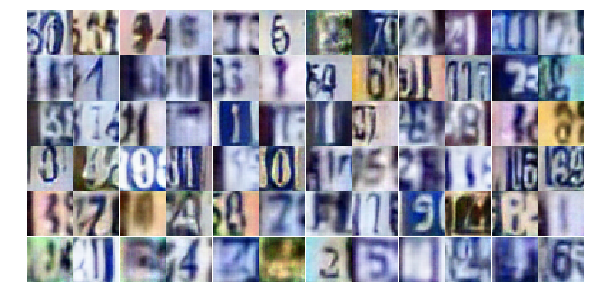

Epoch 23/25... Discriminator Loss: 0.7142... Generator Loss: 0.9668
Epoch 23/25... Discriminator Loss: 0.8903... Generator Loss: 0.7349
Epoch 23/25... Discriminator Loss: 0.6768... Generator Loss: 1.7479
Epoch 23/25... Discriminator Loss: 2.8680... Generator Loss: 5.8394
Epoch 23/25... Discriminator Loss: 0.6888... Generator Loss: 1.1073
Epoch 23/25... Discriminator Loss: 0.9213... Generator Loss: 0.8470
Epoch 23/25... Discriminator Loss: 0.9522... Generator Loss: 0.7536
Epoch 23/25... Discriminator Loss: 0.7050... Generator Loss: 1.0673
Epoch 23/25... Discriminator Loss: 0.8451... Generator Loss: 0.8098
Epoch 23/25... Discriminator Loss: 0.8385... Generator Loss: 0.9879


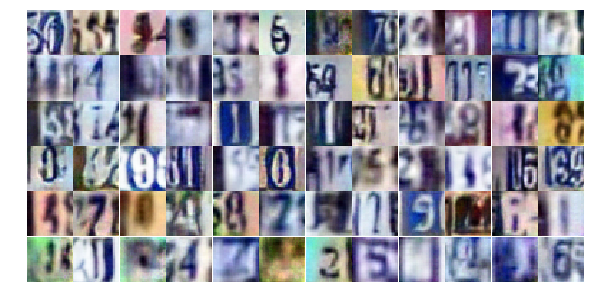

Epoch 23/25... Discriminator Loss: 1.2498... Generator Loss: 0.5826
Epoch 23/25... Discriminator Loss: 0.6781... Generator Loss: 1.1334
Epoch 23/25... Discriminator Loss: 1.4226... Generator Loss: 0.4055
Epoch 23/25... Discriminator Loss: 0.8887... Generator Loss: 0.7822
Epoch 23/25... Discriminator Loss: 0.5964... Generator Loss: 1.3051
Epoch 23/25... Discriminator Loss: 1.0305... Generator Loss: 0.6402
Epoch 23/25... Discriminator Loss: 0.8221... Generator Loss: 0.9151
Epoch 23/25... Discriminator Loss: 0.7631... Generator Loss: 0.9361
Epoch 23/25... Discriminator Loss: 0.4484... Generator Loss: 1.7572
Epoch 23/25... Discriminator Loss: 0.9115... Generator Loss: 1.7678


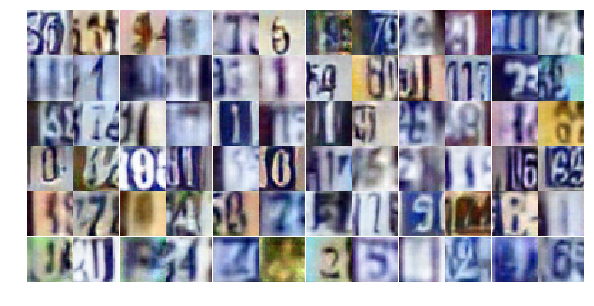

Epoch 23/25... Discriminator Loss: 0.5957... Generator Loss: 1.1532
Epoch 23/25... Discriminator Loss: 0.8027... Generator Loss: 0.8495
Epoch 23/25... Discriminator Loss: 0.7118... Generator Loss: 1.0417
Epoch 23/25... Discriminator Loss: 1.0460... Generator Loss: 0.7481
Epoch 23/25... Discriminator Loss: 1.3996... Generator Loss: 0.4221
Epoch 23/25... Discriminator Loss: 0.8863... Generator Loss: 0.7197
Epoch 23/25... Discriminator Loss: 1.6139... Generator Loss: 0.3771
Epoch 23/25... Discriminator Loss: 0.6905... Generator Loss: 1.0482
Epoch 23/25... Discriminator Loss: 0.4408... Generator Loss: 1.6274
Epoch 23/25... Discriminator Loss: 0.5879... Generator Loss: 1.2119


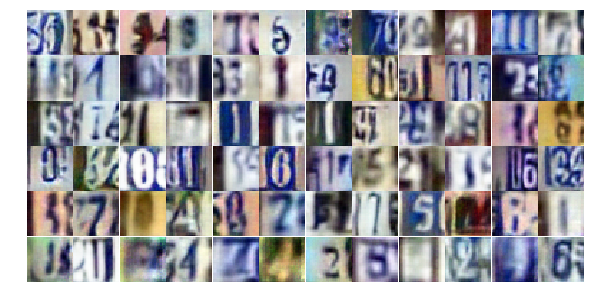

Epoch 23/25... Discriminator Loss: 0.8403... Generator Loss: 1.0144
Epoch 23/25... Discriminator Loss: 0.7353... Generator Loss: 1.0001
Epoch 23/25... Discriminator Loss: 1.1076... Generator Loss: 0.6136
Epoch 23/25... Discriminator Loss: 0.8277... Generator Loss: 0.8677
Epoch 23/25... Discriminator Loss: 0.7011... Generator Loss: 1.8122
Epoch 23/25... Discriminator Loss: 1.2282... Generator Loss: 0.5469
Epoch 23/25... Discriminator Loss: 0.7723... Generator Loss: 0.9814
Epoch 23/25... Discriminator Loss: 1.1291... Generator Loss: 0.5783
Epoch 23/25... Discriminator Loss: 0.8051... Generator Loss: 0.9219
Epoch 23/25... Discriminator Loss: 0.7901... Generator Loss: 0.8950


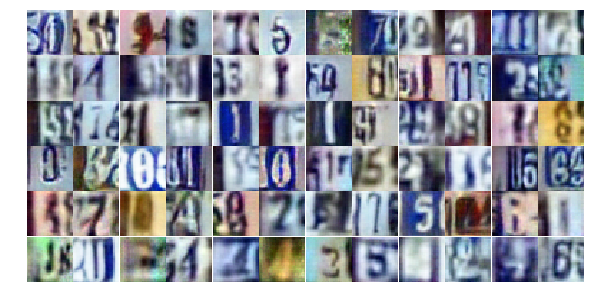

Epoch 23/25... Discriminator Loss: 0.7424... Generator Loss: 1.0611
Epoch 23/25... Discriminator Loss: 1.3526... Generator Loss: 0.4759
Epoch 23/25... Discriminator Loss: 0.7429... Generator Loss: 1.0075
Epoch 23/25... Discriminator Loss: 0.5179... Generator Loss: 1.3219
Epoch 23/25... Discriminator Loss: 1.0756... Generator Loss: 0.6987
Epoch 23/25... Discriminator Loss: 0.8089... Generator Loss: 0.8865
Epoch 23/25... Discriminator Loss: 0.6524... Generator Loss: 1.2708
Epoch 24/25... Discriminator Loss: 0.8868... Generator Loss: 0.7804
Epoch 24/25... Discriminator Loss: 1.2199... Generator Loss: 0.5493
Epoch 24/25... Discriminator Loss: 1.3050... Generator Loss: 0.4556


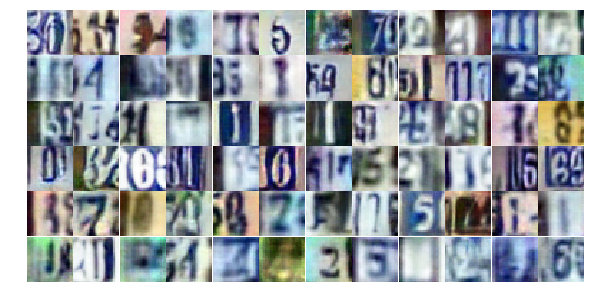

Epoch 24/25... Discriminator Loss: 0.6373... Generator Loss: 1.1521
Epoch 24/25... Discriminator Loss: 0.9169... Generator Loss: 0.6935
Epoch 24/25... Discriminator Loss: 0.8008... Generator Loss: 0.9074
Epoch 24/25... Discriminator Loss: 0.7887... Generator Loss: 2.6072
Epoch 24/25... Discriminator Loss: 0.5881... Generator Loss: 1.2221
Epoch 24/25... Discriminator Loss: 0.5507... Generator Loss: 1.3840
Epoch 24/25... Discriminator Loss: 0.5900... Generator Loss: 1.4231
Epoch 24/25... Discriminator Loss: 1.5755... Generator Loss: 0.3370
Epoch 24/25... Discriminator Loss: 0.6349... Generator Loss: 1.0426
Epoch 24/25... Discriminator Loss: 0.4800... Generator Loss: 1.4996


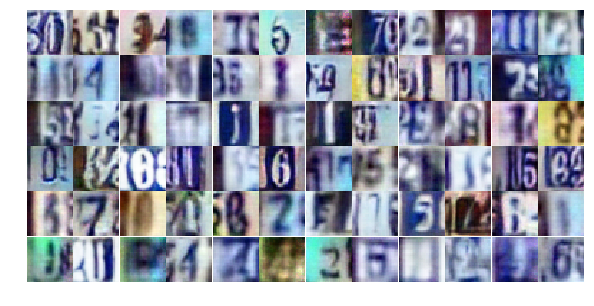

Epoch 24/25... Discriminator Loss: 1.5003... Generator Loss: 0.4028
Epoch 24/25... Discriminator Loss: 0.9284... Generator Loss: 0.7581
Epoch 24/25... Discriminator Loss: 1.2962... Generator Loss: 0.5211
Epoch 24/25... Discriminator Loss: 0.8463... Generator Loss: 0.8098
Epoch 24/25... Discriminator Loss: 0.8808... Generator Loss: 2.8207
Epoch 24/25... Discriminator Loss: 1.6760... Generator Loss: 0.3984
Epoch 24/25... Discriminator Loss: 0.6531... Generator Loss: 1.2610
Epoch 24/25... Discriminator Loss: 1.1966... Generator Loss: 0.6337
Epoch 24/25... Discriminator Loss: 0.6861... Generator Loss: 1.1063
Epoch 24/25... Discriminator Loss: 1.0390... Generator Loss: 0.6851


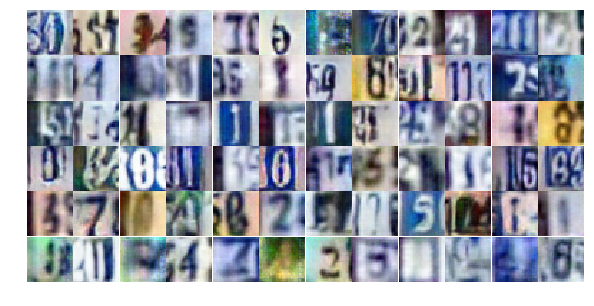

Epoch 24/25... Discriminator Loss: 1.0625... Generator Loss: 0.6402
Epoch 24/25... Discriminator Loss: 0.7675... Generator Loss: 1.1538
Epoch 24/25... Discriminator Loss: 0.8366... Generator Loss: 0.8136
Epoch 24/25... Discriminator Loss: 1.3388... Generator Loss: 0.4965
Epoch 24/25... Discriminator Loss: 0.8796... Generator Loss: 0.7562
Epoch 24/25... Discriminator Loss: 0.4800... Generator Loss: 1.3199
Epoch 24/25... Discriminator Loss: 0.5884... Generator Loss: 1.1955
Epoch 24/25... Discriminator Loss: 0.5400... Generator Loss: 1.4442
Epoch 24/25... Discriminator Loss: 0.8774... Generator Loss: 0.7810
Epoch 24/25... Discriminator Loss: 1.0844... Generator Loss: 0.6093


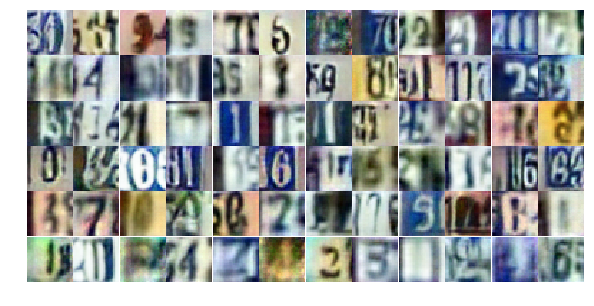

Epoch 24/25... Discriminator Loss: 0.4678... Generator Loss: 1.4959
Epoch 24/25... Discriminator Loss: 0.6146... Generator Loss: 1.0455
Epoch 24/25... Discriminator Loss: 1.0966... Generator Loss: 0.5842
Epoch 24/25... Discriminator Loss: 1.6125... Generator Loss: 0.3300
Epoch 24/25... Discriminator Loss: 0.9170... Generator Loss: 0.7946
Epoch 24/25... Discriminator Loss: 1.1161... Generator Loss: 0.6004
Epoch 24/25... Discriminator Loss: 0.8626... Generator Loss: 0.7766
Epoch 24/25... Discriminator Loss: 0.7246... Generator Loss: 0.9514
Epoch 24/25... Discriminator Loss: 0.7414... Generator Loss: 2.0227
Epoch 24/25... Discriminator Loss: 0.6941... Generator Loss: 1.4532


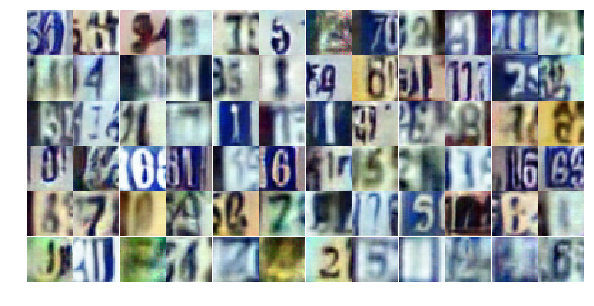

Epoch 24/25... Discriminator Loss: 1.3238... Generator Loss: 0.4741
Epoch 24/25... Discriminator Loss: 2.5474... Generator Loss: 0.6962
Epoch 24/25... Discriminator Loss: 1.9500... Generator Loss: 0.2948
Epoch 24/25... Discriminator Loss: 0.8606... Generator Loss: 1.6822
Epoch 24/25... Discriminator Loss: 1.5038... Generator Loss: 0.3838
Epoch 24/25... Discriminator Loss: 0.6637... Generator Loss: 1.1318
Epoch 24/25... Discriminator Loss: 1.3793... Generator Loss: 0.4221
Epoch 24/25... Discriminator Loss: 0.5991... Generator Loss: 1.1748
Epoch 24/25... Discriminator Loss: 0.7627... Generator Loss: 1.1152
Epoch 24/25... Discriminator Loss: 0.8664... Generator Loss: 0.8641


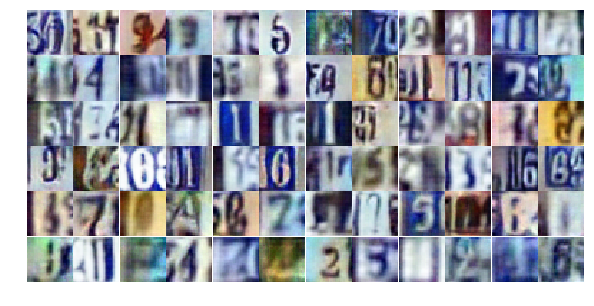

Epoch 24/25... Discriminator Loss: 1.4562... Generator Loss: 0.4056
Epoch 24/25... Discriminator Loss: 1.7127... Generator Loss: 0.3399
Epoch 24/25... Discriminator Loss: 1.8243... Generator Loss: 0.2858
Epoch 24/25... Discriminator Loss: 0.6739... Generator Loss: 1.9746
Epoch 24/25... Discriminator Loss: 1.0237... Generator Loss: 0.6283
Epoch 25/25... Discriminator Loss: 0.7837... Generator Loss: 0.9186
Epoch 25/25... Discriminator Loss: 0.4224... Generator Loss: 1.7291
Epoch 25/25... Discriminator Loss: 0.8782... Generator Loss: 0.7994
Epoch 25/25... Discriminator Loss: 0.6988... Generator Loss: 1.0037
Epoch 25/25... Discriminator Loss: 0.9820... Generator Loss: 0.7342


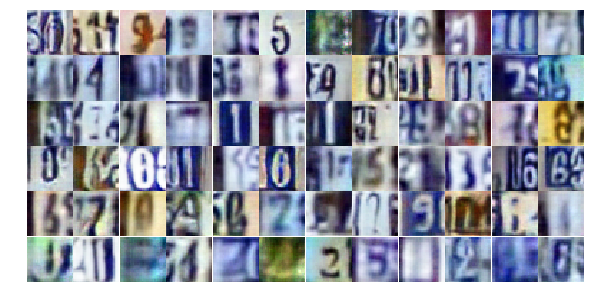

Epoch 25/25... Discriminator Loss: 0.5865... Generator Loss: 1.3737
Epoch 25/25... Discriminator Loss: 1.3185... Generator Loss: 0.4291
Epoch 25/25... Discriminator Loss: 0.6899... Generator Loss: 1.0181
Epoch 25/25... Discriminator Loss: 0.9352... Generator Loss: 0.7336
Epoch 25/25... Discriminator Loss: 0.8938... Generator Loss: 1.6371
Epoch 25/25... Discriminator Loss: 0.9851... Generator Loss: 0.6955
Epoch 25/25... Discriminator Loss: 1.0198... Generator Loss: 0.6650
Epoch 25/25... Discriminator Loss: 0.6659... Generator Loss: 1.3675
Epoch 25/25... Discriminator Loss: 0.4960... Generator Loss: 1.6863
Epoch 25/25... Discriminator Loss: 0.9304... Generator Loss: 0.7680


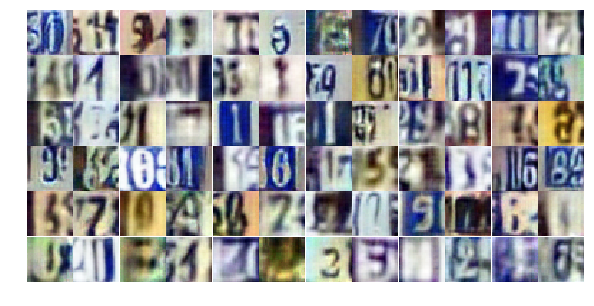

Epoch 25/25... Discriminator Loss: 0.7149... Generator Loss: 1.3245
Epoch 25/25... Discriminator Loss: 0.3966... Generator Loss: 2.0006
Epoch 25/25... Discriminator Loss: 1.1854... Generator Loss: 0.5378
Epoch 25/25... Discriminator Loss: 1.4154... Generator Loss: 0.5239
Epoch 25/25... Discriminator Loss: 0.6506... Generator Loss: 1.4109
Epoch 25/25... Discriminator Loss: 0.4855... Generator Loss: 1.5861
Epoch 25/25... Discriminator Loss: 0.7012... Generator Loss: 1.4315
Epoch 25/25... Discriminator Loss: 0.9359... Generator Loss: 0.7799
Epoch 25/25... Discriminator Loss: 0.5165... Generator Loss: 1.8492
Epoch 25/25... Discriminator Loss: 0.6175... Generator Loss: 1.2756


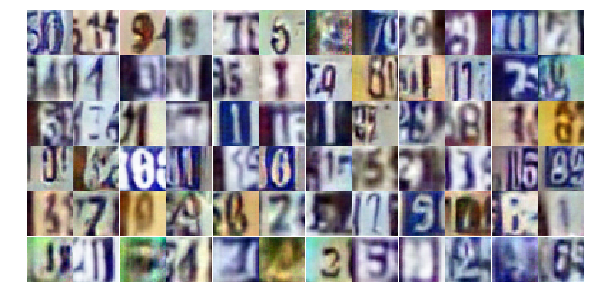

Epoch 25/25... Discriminator Loss: 1.2639... Generator Loss: 0.5379
Epoch 25/25... Discriminator Loss: 0.5982... Generator Loss: 1.1608
Epoch 25/25... Discriminator Loss: 1.1778... Generator Loss: 0.6210
Epoch 25/25... Discriminator Loss: 0.5932... Generator Loss: 1.2264
Epoch 25/25... Discriminator Loss: 0.7438... Generator Loss: 1.2141
Epoch 25/25... Discriminator Loss: 0.5307... Generator Loss: 1.2067
Epoch 25/25... Discriminator Loss: 1.0369... Generator Loss: 0.7573
Epoch 25/25... Discriminator Loss: 0.9467... Generator Loss: 0.6821
Epoch 25/25... Discriminator Loss: 0.9730... Generator Loss: 0.7281
Epoch 25/25... Discriminator Loss: 0.4417... Generator Loss: 2.0009


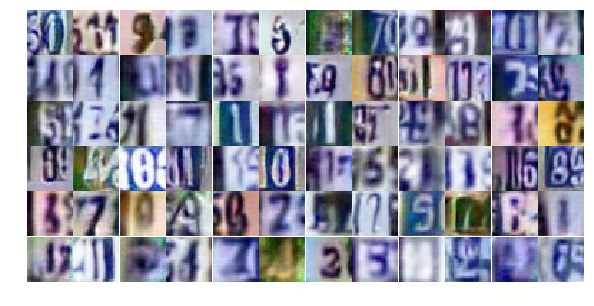

Epoch 25/25... Discriminator Loss: 1.9250... Generator Loss: 1.0213
Epoch 25/25... Discriminator Loss: 0.9668... Generator Loss: 0.8119
Epoch 25/25... Discriminator Loss: 0.7553... Generator Loss: 1.0985
Epoch 25/25... Discriminator Loss: 0.5706... Generator Loss: 1.2054
Epoch 25/25... Discriminator Loss: 1.4811... Generator Loss: 0.3804
Epoch 25/25... Discriminator Loss: 0.8458... Generator Loss: 0.9739
Epoch 25/25... Discriminator Loss: 0.4193... Generator Loss: 1.5232
Epoch 25/25... Discriminator Loss: 0.5575... Generator Loss: 1.2235
Epoch 25/25... Discriminator Loss: 1.9592... Generator Loss: 0.2999
Epoch 25/25... Discriminator Loss: 0.5633... Generator Loss: 1.3324


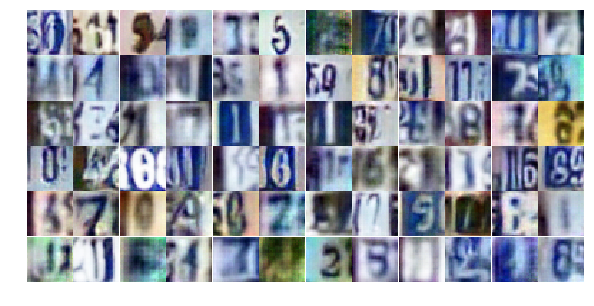

Epoch 25/25... Discriminator Loss: 0.8618... Generator Loss: 1.9546
Epoch 25/25... Discriminator Loss: 0.8357... Generator Loss: 0.8790
Epoch 25/25... Discriminator Loss: 0.8749... Generator Loss: 0.8076
Epoch 25/25... Discriminator Loss: 1.1487... Generator Loss: 0.5624
Epoch 25/25... Discriminator Loss: 1.0809... Generator Loss: 0.5844
Epoch 25/25... Discriminator Loss: 0.4874... Generator Loss: 1.4452
Epoch 25/25... Discriminator Loss: 1.0919... Generator Loss: 0.5976
Epoch 25/25... Discriminator Loss: 0.5348... Generator Loss: 1.3953
Epoch 25/25... Discriminator Loss: 0.7855... Generator Loss: 0.9703
Epoch 25/25... Discriminator Loss: 1.4247... Generator Loss: 0.4369


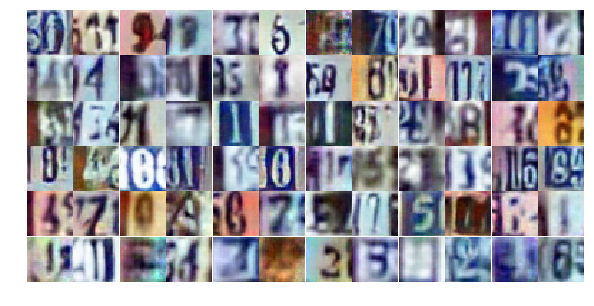

Epoch 25/25... Discriminator Loss: 0.7398... Generator Loss: 1.1604
Epoch 25/25... Discriminator Loss: 1.9145... Generator Loss: 0.2447


In [17]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

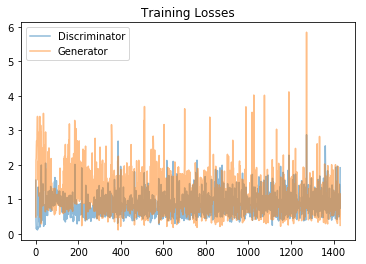

In [18]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

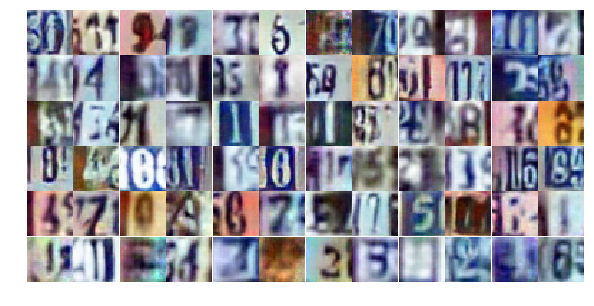

In [19]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))